In [377]:
%matplotlib inline
import scanpy as sc
import pandas as pd
import numpy as np
import os
import glob
from matplotlib import rcParams
import matplotlib.pyplot as plt

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=200, dpi_save=600)
sc.logging.print_versions()

scanpy==1.4.4.post1 anndata==0.6.22.post1 umap==0.3.10 numpy==1.17.3 scipy==1.3.1 pandas==0.25.3 scikit-learn==0.21.3 statsmodels==0.10.1 python-igraph==0.7.1 louvain==0.6.1


In [3]:
input_dir = '/home/bay001/projects/kris_apobec_20200121/permanent_data2/03_scRNA/outputs/'
input_dir2 = '/home/bay001/projects/kris_apobec_20200121/permanent_data2/04_scRNA_RBFOX2_TIA/outputs/'

results_dir = '/projects/ps-yeolab3/iachaim/10X/APOBEC/saved_adatas/'  # the directory that will store the analysis results. Add NAME.h5ad to files to save.
# use adata.write(results_dir+'NAME.h5ad')

In [11]:
adata_RPS2 = pd.read_csv(
    os.path.join(input_dir, 'RPS2_possorted_genome_bam_MD.exons.merged.edited_over_all_c.wgenenames.txt'),
    sep='\t',
    index_col=0
)
print(adata_RPS2.shape)
adata_RPS2.head()

(2464, 10996)


,name,RPS2_possorted_genome_bam_MD-AAACCCACAGGATCTT-1,RPS2_possorted_genome_bam_MD-AAACCCACAGGTACGA-1,RPS2_possorted_genome_bam_MD-AAACCCACAGTTCACA-1,RPS2_possorted_genome_bam_MD-AAACCCACATCGGATT-1,RPS2_possorted_genome_bam_MD-AAACCCAGTTCCGCAG-1,RPS2_possorted_genome_bam_MD-AAACCCATCCTAGCCT-1,RPS2_possorted_genome_bam_MD-AAACCCATCGTCGACG-1,RPS2_possorted_genome_bam_MD-AAACGAAAGGGATGTC-1,RPS2_possorted_genome_bam_MD-AAACGAAAGTGGTCAG-1,...,RPS2_possorted_genome_bam_MD-TTTGTTGGTACACTCA-1,RPS2_possorted_genome_bam_MD-TTTGTTGGTACAGTTC-1,RPS2_possorted_genome_bam_MD-TTTGTTGGTAGCGTTT-1,RPS2_possorted_genome_bam_MD-TTTGTTGGTCGTGGTC-1,RPS2_possorted_genome_bam_MD-TTTGTTGTCAAACGTC-1,RPS2_possorted_genome_bam_MD-TTTGTTGTCACTACTT-1,RPS2_possorted_genome_bam_MD-TTTGTTGTCCCAGTGG-1,RPS2_possorted_genome_bam_MD-TTTGTTGTCCCGTTCA-1,RPS2_possorted_genome_bam_MD-TTTGTTGTCTACCACC-1,RPS2_possorted_genome_bam_MD-TTTGTTGTCTGGAAGG-1
genename,,,,,,,,,,,,,,,,,,,,,
TSPAN6,ENSG00000000003.10,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0
FUCA2,ENSG00000001036.9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0
CYP51A1,ENSG00000001630.11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0
BAD,ENSG00000002330.9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0
CD99,ENSG00000002586.13,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0


In [12]:
adata_Apo = pd.read_csv(
    os.path.join(input_dir, 'Apo_Control_possorted_genome_bam_MD.exons.merged.edited_over_all_c.wgenenames.txt'),
    sep='\t',
    index_col=0
)
print(adata_Apo.shape)
adata_Apo.head()

(2287, 8617)


,name,Apo_Control_possorted_genome_bam_MD-AAACCCAAGCCAGTAG-1,Apo_Control_possorted_genome_bam_MD-AAACCCAAGGATGCGT-1,Apo_Control_possorted_genome_bam_MD-AAACCCACAATACAGA-1,Apo_Control_possorted_genome_bam_MD-AAACCCACACGCAGTC-1,Apo_Control_possorted_genome_bam_MD-AAACCCACAGAACATA-1,Apo_Control_possorted_genome_bam_MD-AAACCCACATGAATAG-1,Apo_Control_possorted_genome_bam_MD-AAACCCAGTAACAAGT-1,Apo_Control_possorted_genome_bam_MD-AAACCCAGTAATCAGA-1,Apo_Control_possorted_genome_bam_MD-AAACCCAGTGCCTGAC-1,...,Apo_Control_possorted_genome_bam_MD-TTTGGAGTCCCTATTA-1,Apo_Control_possorted_genome_bam_MD-TTTGGAGTCGTCAGAT-1,Apo_Control_possorted_genome_bam_MD-TTTGGTTCATGCTGCG-1,Apo_Control_possorted_genome_bam_MD-TTTGGTTGTACGGGAT-1,Apo_Control_possorted_genome_bam_MD-TTTGGTTTCCTTCACG-1,Apo_Control_possorted_genome_bam_MD-TTTGGTTTCGTCCTTG-1,Apo_Control_possorted_genome_bam_MD-TTTGTTGAGTGGCGAT-1,Apo_Control_possorted_genome_bam_MD-TTTGTTGGTATGGTTC-1,Apo_Control_possorted_genome_bam_MD-TTTGTTGTCAAGTTGC-1,Apo_Control_possorted_genome_bam_MD-TTTGTTGTCTCGGTAA-1
genename,,,,,,,,,,,,,,,,,,,,,
FUCA2,ENSG00000001036.9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CYP51A1,ENSG00000001630.11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BAD,ENSG00000002330.9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CD99,ENSG00000002586.13,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
DBNDD1,ENSG00000003249.9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [13]:
adata_RBFOX_TIA = pd.read_csv(
    os.path.join(input_dir2, 'possorted_genome_bam_MD.exons.merged.edited_over_all_c.wgenenames.txt'),
    sep='\t',
    index_col=0
)
print(adata_RBFOX_TIA.shape)
adata_RBFOX_TIA.head()

(2087, 16947)


,name,possorted_genome_bam_MD-AAACCCAAGAGCCCAA-1,possorted_genome_bam_MD-AAACCCAAGAGCTTTC-1,possorted_genome_bam_MD-AAACCCAAGATAGTGT-1,possorted_genome_bam_MD-AAACCCAAGTCCGTCG-1,possorted_genome_bam_MD-AAACCCAAGTGCTACT-1,possorted_genome_bam_MD-AAACCCACAGAAATTG-1,possorted_genome_bam_MD-AAACCCACAGGAAGTC-1,possorted_genome_bam_MD-AAACCCACAGGCTCTG-1,possorted_genome_bam_MD-AAACCCACATATGCGT-1,...,possorted_genome_bam_MD-TTTGTTGGTATTCCGA-1,possorted_genome_bam_MD-TTTGTTGGTCTCACAA-1,possorted_genome_bam_MD-TTTGTTGGTGAATTAG-1,possorted_genome_bam_MD-TTTGTTGGTTAAGTCC-1,possorted_genome_bam_MD-TTTGTTGGTTGGAGGT-1,possorted_genome_bam_MD-TTTGTTGTCACTCGAA-1,possorted_genome_bam_MD-TTTGTTGTCATTTCCA-1,possorted_genome_bam_MD-TTTGTTGTCCTATGGA-1,possorted_genome_bam_MD-TTTGTTGTCCTTCTGG-1,possorted_genome_bam_MD-TTTGTTGTCGAGAAAT-1
genename,,,,,,,,,,,,,,,,,,,,,
TSPAN6,ENSG00000000003.10,0.0,0.0,0,0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
DPM1,ENSG00000000419.8,0.0,0.0,0,0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CYP51A1,ENSG00000001630.11,0.0,0.0,0,0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BAD,ENSG00000002330.9,0.0,0.0,0,0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
LAP3,ENSG00000002549.8,0.0,0.0,0,0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [14]:
adata_RPS2=adata_RPS2.drop(['name'],axis=1)
adata_Apo=adata_Apo.drop(['name'],axis=1)
adata_RBFOX_TIA=adata_RBFOX_TIA.drop(['name'],axis=1)

In [15]:
adata_RPS2.head()

,RPS2_possorted_genome_bam_MD-AAACCCACAGGATCTT-1,RPS2_possorted_genome_bam_MD-AAACCCACAGGTACGA-1,RPS2_possorted_genome_bam_MD-AAACCCACAGTTCACA-1,RPS2_possorted_genome_bam_MD-AAACCCACATCGGATT-1,RPS2_possorted_genome_bam_MD-AAACCCAGTTCCGCAG-1,RPS2_possorted_genome_bam_MD-AAACCCATCCTAGCCT-1,RPS2_possorted_genome_bam_MD-AAACCCATCGTCGACG-1,RPS2_possorted_genome_bam_MD-AAACGAAAGGGATGTC-1,RPS2_possorted_genome_bam_MD-AAACGAAAGTGGTCAG-1,RPS2_possorted_genome_bam_MD-AAACGAACACACCTTC-1,...,RPS2_possorted_genome_bam_MD-TTTGTTGGTACACTCA-1,RPS2_possorted_genome_bam_MD-TTTGTTGGTACAGTTC-1,RPS2_possorted_genome_bam_MD-TTTGTTGGTAGCGTTT-1,RPS2_possorted_genome_bam_MD-TTTGTTGGTCGTGGTC-1,RPS2_possorted_genome_bam_MD-TTTGTTGTCAAACGTC-1,RPS2_possorted_genome_bam_MD-TTTGTTGTCACTACTT-1,RPS2_possorted_genome_bam_MD-TTTGTTGTCCCAGTGG-1,RPS2_possorted_genome_bam_MD-TTTGTTGTCCCGTTCA-1,RPS2_possorted_genome_bam_MD-TTTGTTGTCTACCACC-1,RPS2_possorted_genome_bam_MD-TTTGTTGTCTGGAAGG-1
genename,,,,,,,,,,,,,,,,,,,,,
TSPAN6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0
FUCA2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0
CYP51A1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0
BAD,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0
CD99,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0


In [16]:
adata_Apo.head()

,Apo_Control_possorted_genome_bam_MD-AAACCCAAGCCAGTAG-1,Apo_Control_possorted_genome_bam_MD-AAACCCAAGGATGCGT-1,Apo_Control_possorted_genome_bam_MD-AAACCCACAATACAGA-1,Apo_Control_possorted_genome_bam_MD-AAACCCACACGCAGTC-1,Apo_Control_possorted_genome_bam_MD-AAACCCACAGAACATA-1,Apo_Control_possorted_genome_bam_MD-AAACCCACATGAATAG-1,Apo_Control_possorted_genome_bam_MD-AAACCCAGTAACAAGT-1,Apo_Control_possorted_genome_bam_MD-AAACCCAGTAATCAGA-1,Apo_Control_possorted_genome_bam_MD-AAACCCAGTGCCTGAC-1,Apo_Control_possorted_genome_bam_MD-AAACCCATCACAAGGG-1,...,Apo_Control_possorted_genome_bam_MD-TTTGGAGTCCCTATTA-1,Apo_Control_possorted_genome_bam_MD-TTTGGAGTCGTCAGAT-1,Apo_Control_possorted_genome_bam_MD-TTTGGTTCATGCTGCG-1,Apo_Control_possorted_genome_bam_MD-TTTGGTTGTACGGGAT-1,Apo_Control_possorted_genome_bam_MD-TTTGGTTTCCTTCACG-1,Apo_Control_possorted_genome_bam_MD-TTTGGTTTCGTCCTTG-1,Apo_Control_possorted_genome_bam_MD-TTTGTTGAGTGGCGAT-1,Apo_Control_possorted_genome_bam_MD-TTTGTTGGTATGGTTC-1,Apo_Control_possorted_genome_bam_MD-TTTGTTGTCAAGTTGC-1,Apo_Control_possorted_genome_bam_MD-TTTGTTGTCTCGGTAA-1
genename,,,,,,,,,,,,,,,,,,,,,
FUCA2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CYP51A1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BAD,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CD99,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
DBNDD1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [17]:
adata_RBFOX_TIA.head()

,possorted_genome_bam_MD-AAACCCAAGAGCCCAA-1,possorted_genome_bam_MD-AAACCCAAGAGCTTTC-1,possorted_genome_bam_MD-AAACCCAAGATAGTGT-1,possorted_genome_bam_MD-AAACCCAAGTCCGTCG-1,possorted_genome_bam_MD-AAACCCAAGTGCTACT-1,possorted_genome_bam_MD-AAACCCACAGAAATTG-1,possorted_genome_bam_MD-AAACCCACAGGAAGTC-1,possorted_genome_bam_MD-AAACCCACAGGCTCTG-1,possorted_genome_bam_MD-AAACCCACATATGCGT-1,possorted_genome_bam_MD-AAACCCACATCTATCT-1,...,possorted_genome_bam_MD-TTTGTTGGTATTCCGA-1,possorted_genome_bam_MD-TTTGTTGGTCTCACAA-1,possorted_genome_bam_MD-TTTGTTGGTGAATTAG-1,possorted_genome_bam_MD-TTTGTTGGTTAAGTCC-1,possorted_genome_bam_MD-TTTGTTGGTTGGAGGT-1,possorted_genome_bam_MD-TTTGTTGTCACTCGAA-1,possorted_genome_bam_MD-TTTGTTGTCATTTCCA-1,possorted_genome_bam_MD-TTTGTTGTCCTATGGA-1,possorted_genome_bam_MD-TTTGTTGTCCTTCTGG-1,possorted_genome_bam_MD-TTTGTTGTCGAGAAAT-1
genename,,,,,,,,,,,,,,,,,,,,,
TSPAN6,0.0,0.0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
DPM1,0.0,0.0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CYP51A1,0.0,0.0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BAD,0.0,0.0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
LAP3,0.0,0.0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [18]:
#adata_RPS2=adata_RPS2.drop('intergenic')
#adata_Apo=adata_Apo.drop('intergenic')

In [19]:
adata_RPS2_raw=adata_RPS2
adata_Apo_raw=adata_Apo
adata_RBFOX_TIA_raw=adata_RBFOX_TIA

In [20]:
adata_RPS2=adata_RPS2_raw
adata_Apo=adata_Apo_raw
adata_RBFOX_TIA=adata_RBFOX_TIA_raw

In [21]:
adata_RPS2 = sc.AnnData(adata_RPS2.T)
print(adata_RPS2)
adata_Apo = sc.AnnData(adata_Apo.T)
print(adata_Apo)
adata_RBFOX_TIA = sc.AnnData(adata_RBFOX_TIA.T)
print(adata_RBFOX_TIA)

AnnData object with n_obs × n_vars = 10995 × 2464 
AnnData object with n_obs × n_vars = 8616 × 2287 
AnnData object with n_obs × n_vars = 16946 × 2087 


In [22]:
adata_RPS2.obs['n_edits'] = adata_RPS2.X.sum(axis=1)
adata_Apo.obs['n_edits'] = adata_Apo.X.sum(axis=1)
adata_RBFOX_TIA.obs['n_edits'] = adata_RBFOX_TIA.X.sum(axis=1)


print(adata_RPS2)
print(adata_Apo)
print(adata_RBFOX_TIA)

AnnData object with n_obs × n_vars = 10995 × 2464 
    obs: 'n_edits'
AnnData object with n_obs × n_vars = 8616 × 2287 
    obs: 'n_edits'
AnnData object with n_obs × n_vars = 16946 × 2087 
    obs: 'n_edits'


In [23]:
sc.pp.filter_cells(adata_RPS2, min_genes=0)
sc.pp.filter_genes(adata_RPS2, min_cells=2)

sc.pp.filter_cells(adata_Apo, min_genes=0)
sc.pp.filter_genes(adata_Apo, min_cells=2)

sc.pp.filter_cells(adata_RBFOX_TIA, min_genes=0)
sc.pp.filter_genes(adata_RBFOX_TIA, min_cells=2)

filtered out 515 genes that are detectedin less than 2 cells
filtered out 539 genes that are detectedin less than 2 cells
filtered out 545 genes that are detectedin less than 2 cells


In [24]:
print(adata_RPS2)
print(adata_Apo)
print(adata_RBFOX_TIA)

AnnData object with n_obs × n_vars = 10995 × 1949 
    obs: 'n_edits', 'n_genes'
    var: 'n_cells'
AnnData object with n_obs × n_vars = 8616 × 1748 
    obs: 'n_edits', 'n_genes'
    var: 'n_cells'
AnnData object with n_obs × n_vars = 16946 × 1542 
    obs: 'n_edits', 'n_genes'
    var: 'n_cells'


In [25]:
adata_RPS2.obs

,n_edits,n_genes
RPS2_possorted_genome_bam_MD-AAACCCACAGGATCTT-1,0.085346,48
RPS2_possorted_genome_bam_MD-AAACCCACAGGTACGA-1,0.523234,132
RPS2_possorted_genome_bam_MD-AAACCCACAGTTCACA-1,0.133322,43
RPS2_possorted_genome_bam_MD-AAACCCACATCGGATT-1,0.157873,45
RPS2_possorted_genome_bam_MD-AAACCCAGTTCCGCAG-1,2.610953,323
...,...,...
RPS2_possorted_genome_bam_MD-TTTGTTGTCACTACTT-1,0.382435,96
RPS2_possorted_genome_bam_MD-TTTGTTGTCCCAGTGG-1,0.096663,43
RPS2_possorted_genome_bam_MD-TTTGTTGTCCCGTTCA-1,0.000000,0
RPS2_possorted_genome_bam_MD-TTTGTTGTCTACCACC-1,0.610890,176


In [26]:
adata_Apo.obs

,n_edits,n_genes
Apo_Control_possorted_genome_bam_MD-AAACCCAAGCCAGTAG-1,0.165572,64
Apo_Control_possorted_genome_bam_MD-AAACCCAAGGATGCGT-1,0.205225,89
Apo_Control_possorted_genome_bam_MD-AAACCCACAATACAGA-1,0.109124,41
Apo_Control_possorted_genome_bam_MD-AAACCCACACGCAGTC-1,0.175402,66
Apo_Control_possorted_genome_bam_MD-AAACCCACAGAACATA-1,0.143453,59
...,...,...
Apo_Control_possorted_genome_bam_MD-TTTGGTTTCGTCCTTG-1,0.083250,45
Apo_Control_possorted_genome_bam_MD-TTTGTTGAGTGGCGAT-1,0.076102,39
Apo_Control_possorted_genome_bam_MD-TTTGTTGGTATGGTTC-1,0.098022,43
Apo_Control_possorted_genome_bam_MD-TTTGTTGTCAAGTTGC-1,0.117192,42


In [27]:
adata_RBFOX_TIA.obs

,n_edits,n_genes
possorted_genome_bam_MD-AAACCCAAGAGCCCAA-1,0.716930,127
possorted_genome_bam_MD-AAACCCAAGAGCTTTC-1,0.097903,28
possorted_genome_bam_MD-AAACCCAAGATAGTGT-1,0.000000,0
possorted_genome_bam_MD-AAACCCAAGTCCGTCG-1,0.000000,0
possorted_genome_bam_MD-AAACCCAAGTGCTACT-1,0.229328,53
...,...,...
possorted_genome_bam_MD-TTTGTTGTCACTCGAA-1,0.036992,17
possorted_genome_bam_MD-TTTGTTGTCATTTCCA-1,0.831829,139
possorted_genome_bam_MD-TTTGTTGTCCTATGGA-1,0.191077,53
possorted_genome_bam_MD-TTTGTTGTCCTTCTGG-1,0.165273,40


In [28]:
sample_names = ('Apo-Edits','RBFOX_TIA-Edits')
adata = adata_Apo.concatenate(adata_RBFOX_TIA,join='outer',batch_categories=sample_names)

In [29]:
adata.X = np.nan_to_num(adata.X)

In [30]:
adata

AnnData object with n_obs × n_vars = 25562 × 1965 
    obs: 'batch', 'n_edits', 'n_genes'
    var: 'n_cells-Apo-Edits', 'n_cells-RBFOX_TIA-Edits'

In [31]:
adata

AnnData object with n_obs × n_vars = 25562 × 1965 
    obs: 'batch', 'n_edits', 'n_genes'
    var: 'n_cells-Apo-Edits', 'n_cells-RBFOX_TIA-Edits'

In [32]:
adata.obs

,batch,n_edits,n_genes
Apo_Control_possorted_genome_bam_MD-AAACCCAAGCCAGTAG-1-Apo-Edits,Apo-Edits,0.165572,64
Apo_Control_possorted_genome_bam_MD-AAACCCAAGGATGCGT-1-Apo-Edits,Apo-Edits,0.205225,89
Apo_Control_possorted_genome_bam_MD-AAACCCACAATACAGA-1-Apo-Edits,Apo-Edits,0.109124,41
Apo_Control_possorted_genome_bam_MD-AAACCCACACGCAGTC-1-Apo-Edits,Apo-Edits,0.175402,66
Apo_Control_possorted_genome_bam_MD-AAACCCACAGAACATA-1-Apo-Edits,Apo-Edits,0.143453,59
...,...,...,...
possorted_genome_bam_MD-TTTGTTGTCACTCGAA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.036992,17
possorted_genome_bam_MD-TTTGTTGTCATTTCCA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.831829,139
possorted_genome_bam_MD-TTTGTTGTCCTATGGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.191077,53
possorted_genome_bam_MD-TTTGTTGTCCTTCTGG-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.165273,40


In [33]:
adata.var

,n_cells-Apo-Edits,n_cells-RBFOX_TIA-Edits
CYP51A1,2.0,14.0
CD99,59.0,24.0
ARF5,178.0,843.0
AK2,9.0,14.0
FKBP4,28.0,65.0
...,...,...
PPIC,NaN,2.0
SLC39A4,NaN,2.0
GNL3,NaN,7.0
GAS1,NaN,15.0


In [34]:
adata.var=adata.var.fillna(0)
adata.var

,n_cells-Apo-Edits,n_cells-RBFOX_TIA-Edits
CYP51A1,2.0,14.0
CD99,59.0,24.0
ARF5,178.0,843.0
AK2,9.0,14.0
FKBP4,28.0,65.0
...,...,...
PPIC,0.0,2.0
SLC39A4,0.0,2.0
GNL3,0.0,7.0
GAS1,0.0,15.0


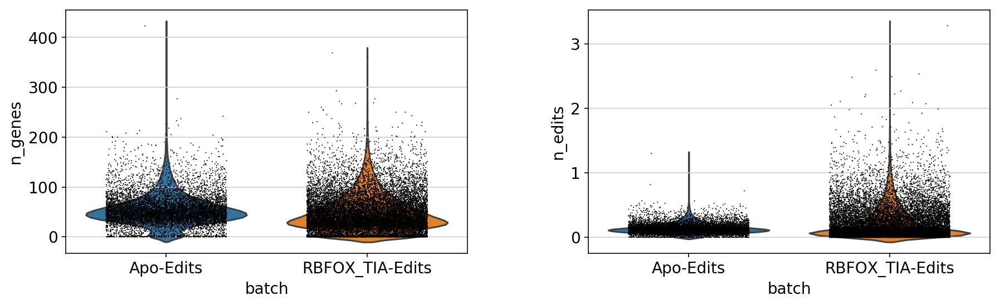

In [35]:
sc.pl.violin(adata, ['n_genes', 'n_edits'],
                 jitter=0.3, groupby='batch')

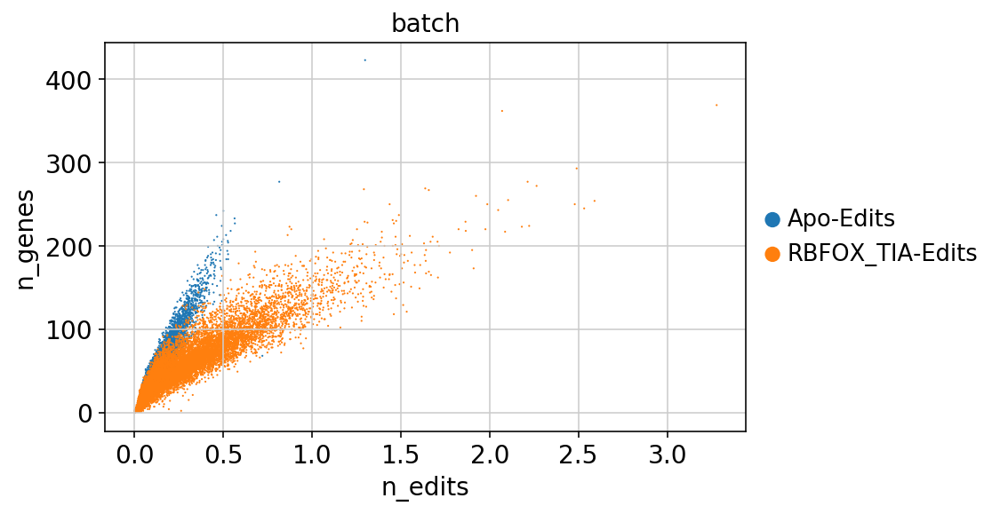

In [36]:
sc.pl.scatter(adata, x='n_edits', y='n_genes',color='batch')

In [37]:
adata.uns['batch_colors']=['#B4DAE3', '#F4CDA6']

In [38]:
adata = adata[adata.obs['n_genes'] < 500, :]
adata = adata[adata.obs['n_genes'] > 10, :]
adata = adata[adata.obs['n_edits'] > 0, :]

In [39]:
#adata = adata[adata.obs['n_genes'] < 700, :]
#adata = adata[adata.obs['n_genes'] > 0, :]
#adata = adata[adata.obs['n_edits'] > 0, :]
#adata = adata[adata.obs['n_edits'] < 2500, :]

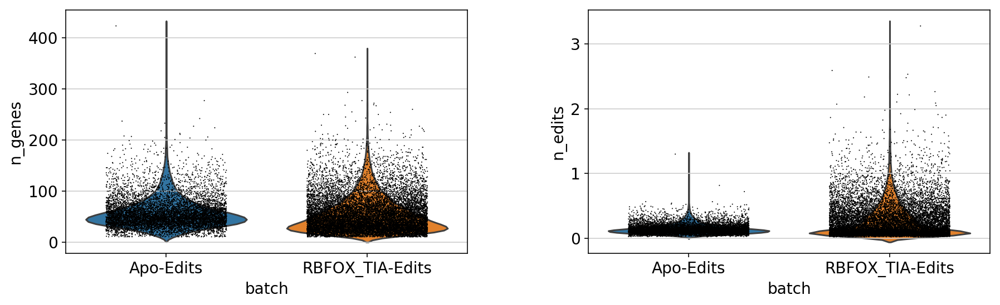

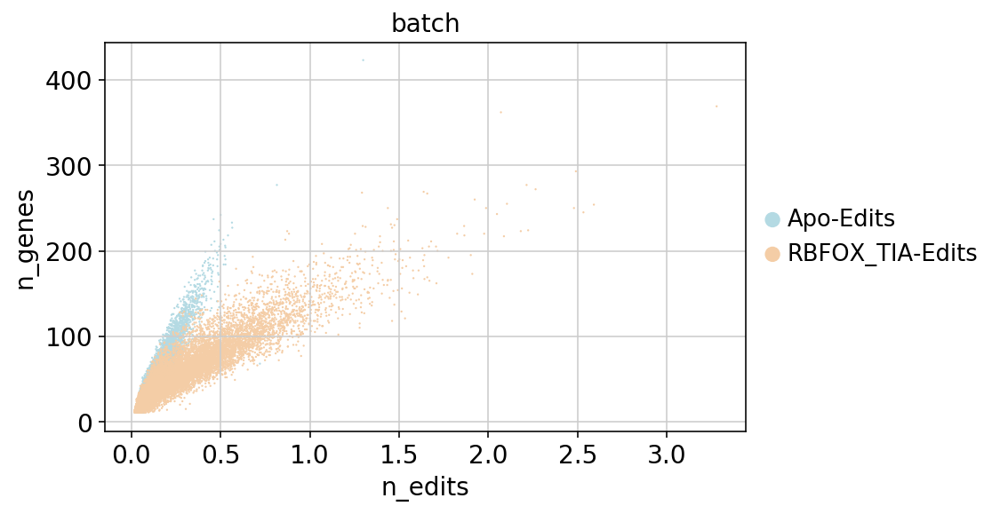

In [40]:
sc.pl.violin(adata, ['n_genes', 'n_edits'],
                 jitter=0.3, groupby='batch')

sc.pl.scatter(adata, x='n_edits', y='n_genes',color='batch')

In [41]:
adata.uns['batch_colors']

['#B4DAE3', '#F4CDA6']

In [42]:
adata.obs.sort_values(by='n_edits', ascending=False)

,batch,n_edits,n_genes
possorted_genome_bam_MD-TACCCGTAGCTCCGAC-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,3.278256,369
possorted_genome_bam_MD-TAACGACAGTGAGGCT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,2.590677,254
possorted_genome_bam_MD-GCGGATCAGGTCACCC-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,2.532249,245
possorted_genome_bam_MD-TCCTTTCAGCGGTAGT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,2.489852,293
possorted_genome_bam_MD-CAACAACCAAGCGCTC-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,2.479191,250
...,...,...,...
possorted_genome_bam_MD-TGACCCTAGGTATTGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.018632,14
possorted_genome_bam_MD-ACCTACCTCTTCTTCC-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.018091,12
possorted_genome_bam_MD-CTCAAGAAGTAACCTC-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.018032,11
possorted_genome_bam_MD-TGTTCATAGTTCTACG-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.017758,12


In [43]:
adata.obs

,batch,n_edits,n_genes
Apo_Control_possorted_genome_bam_MD-AAACCCAAGCCAGTAG-1-Apo-Edits,Apo-Edits,0.165572,64
Apo_Control_possorted_genome_bam_MD-AAACCCAAGGATGCGT-1-Apo-Edits,Apo-Edits,0.205225,89
Apo_Control_possorted_genome_bam_MD-AAACCCACAATACAGA-1-Apo-Edits,Apo-Edits,0.109124,41
Apo_Control_possorted_genome_bam_MD-AAACCCACACGCAGTC-1-Apo-Edits,Apo-Edits,0.175402,66
Apo_Control_possorted_genome_bam_MD-AAACCCACAGAACATA-1-Apo-Edits,Apo-Edits,0.143453,59
...,...,...,...
possorted_genome_bam_MD-TTTGTTGTCACTCGAA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.036992,17
possorted_genome_bam_MD-TTTGTTGTCATTTCCA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.831829,139
possorted_genome_bam_MD-TTTGTTGTCCTATGGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.191077,53
possorted_genome_bam_MD-TTTGTTGTCCTTCTGG-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.165273,40


In [44]:
adata.var=adata.var.fillna(0)
adata.var

,n_cells-Apo-Edits,n_cells-RBFOX_TIA-Edits
CYP51A1,2.0,14.0
CD99,59.0,24.0
ARF5,178.0,843.0
AK2,9.0,14.0
FKBP4,28.0,65.0
...,...,...
PPIC,0.0,2.0
SLC39A4,0.0,2.0
GNL3,0.0,7.0
GAS1,0.0,15.0


# other Scanpy calculations

normalizing by total count per cell
filtered out 22276 cells that haveless than 1 counts
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


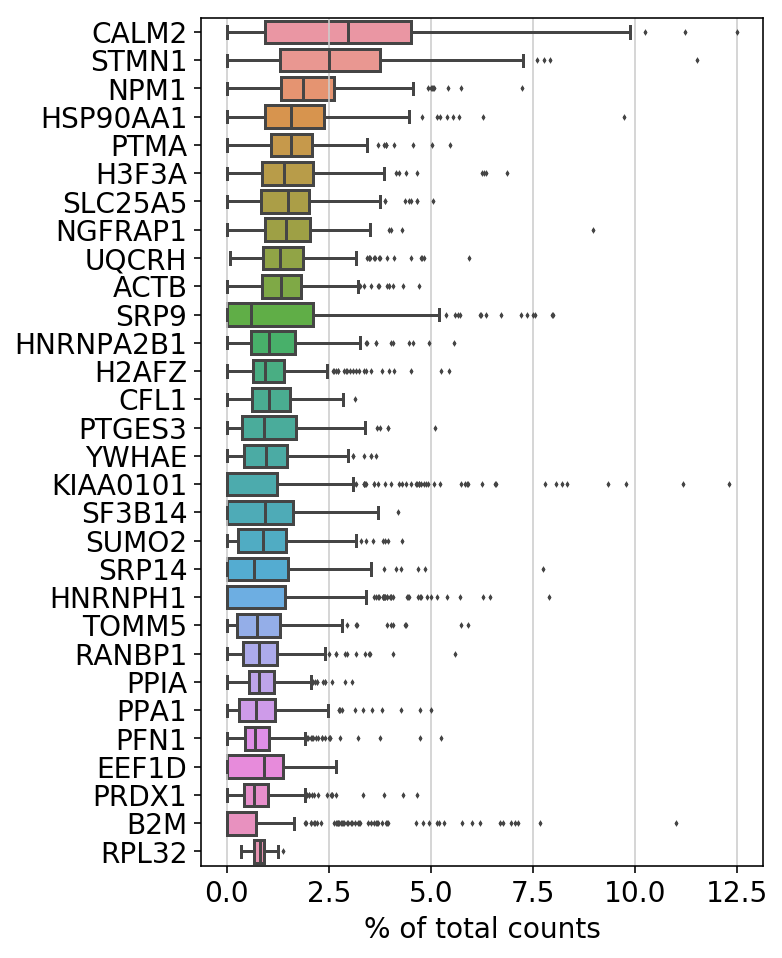

In [45]:
sc.pl.highest_expr_genes(adata, n_top=30)

In [46]:
adata

AnnData object with n_obs × n_vars = 22584 × 1965 
    obs: 'batch', 'n_edits', 'n_genes'
    var: 'n_cells-Apo-Edits', 'n_cells-RBFOX_TIA-Edits'
    uns: 'batch_colors'

# normalize / log transform / highly variable

In [47]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.raw = adata
#sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=6, min_disp=0.5)
#sc.pl.highly_variable_genes(adata)
#adata = adata[:, adata.var['highly_variable']]

Normalizing counts per cell.
    finished (0:00:00):normalized adata.X


In [48]:
print(np.any(adata.X.sum(axis=0) == 0))
print(np.any(adata.X.sum(axis=1) == 0))

True
False


In [49]:
adata = adata[:,adata.X.sum(axis=0) > 0].copy()

In [50]:
adata_backup=adata.copy()

In [51]:
adata_backup

AnnData object with n_obs × n_vars = 22584 × 1964 
    obs: 'batch', 'n_edits', 'n_genes'
    var: 'n_cells-Apo-Edits', 'n_cells-RBFOX_TIA-Edits'
    uns: 'batch_colors'

In [44]:
sc.pp.regress_out(adata, ['n_edits'])

regressing out ['n_edits']
    finished (0:00:24)


In [45]:
sc.pp.scale(adata, max_value=10)

In [46]:
#adata_RPS2.var[adata_RPS2.var['highly_variable']].count()

# Cluster with louvain

In [58]:
sc.tl.pca(adata, svd_solver='arpack')

computing PCA with n_comps = 50
    finished (0:00:05)


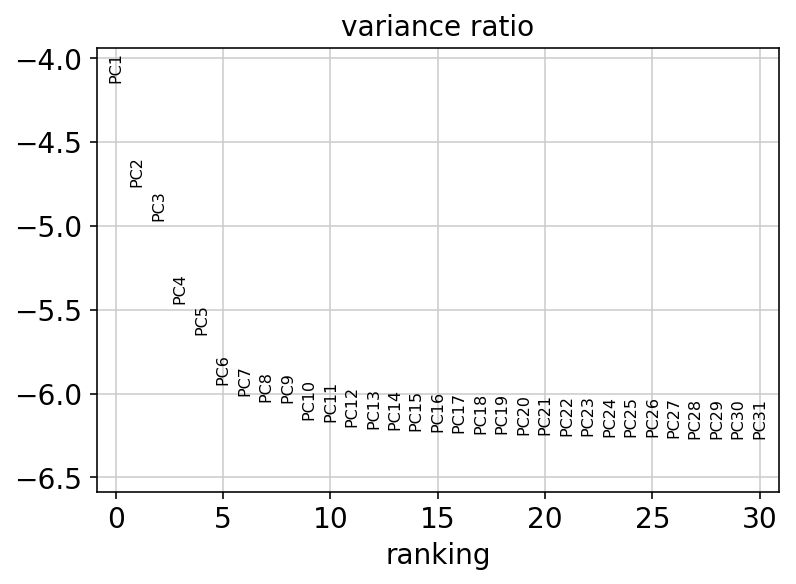

In [59]:
sc.pl.pca_variance_ratio(adata, log=True)

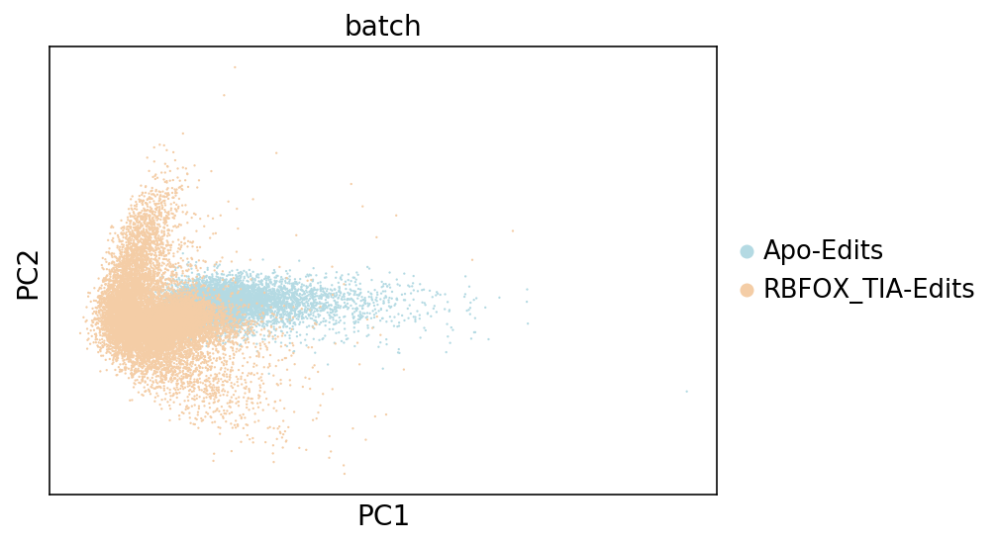

In [60]:
sc.pl.pca(adata, color='batch')

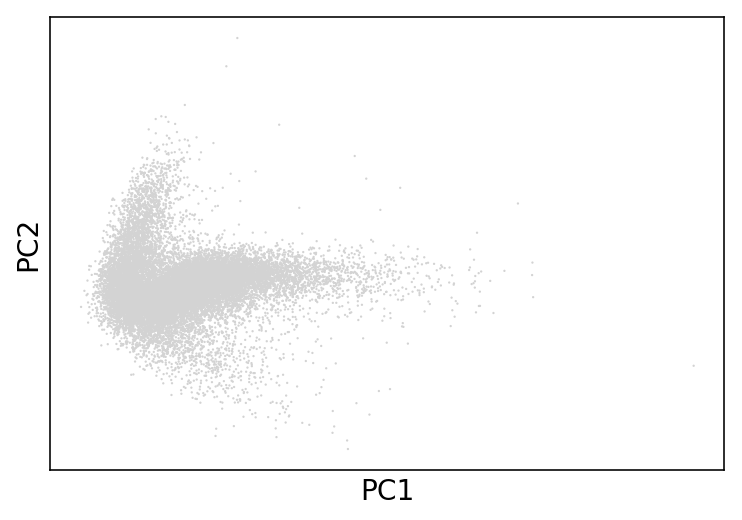

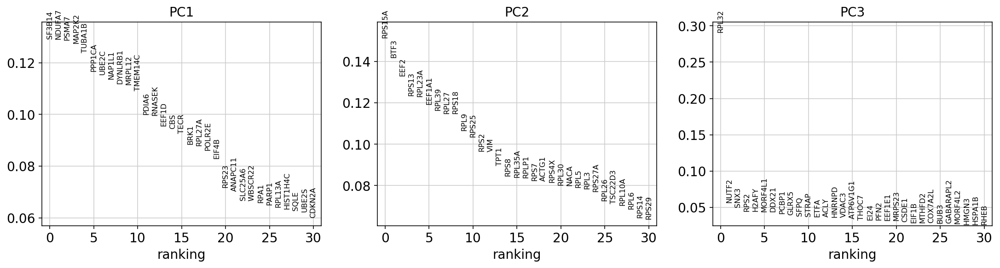

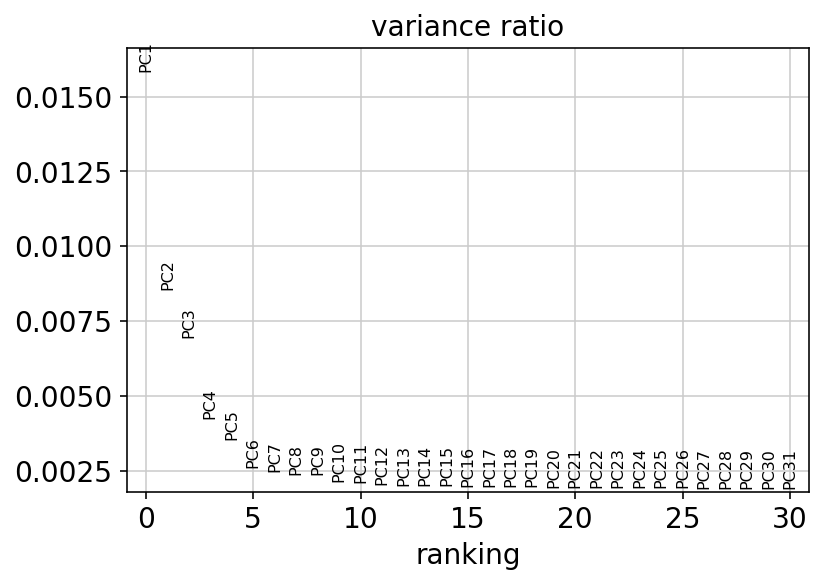

In [61]:
sc.pl.pca_overview(adata)

In [62]:
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=40)

computing neighbors
    using 'X_pca' with n_pcs = 40


/home/iachaim/anaconda3/envs/scanpy/lib/python3.7/site-packages/numba/typed_passes.py:271: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../anaconda3/envs/scanpy/lib/python3.7/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  state.func_ir.loc))
/home/iachaim/anaconda3/envs/scanpy/lib/python3.7/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../anaconda3

    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:14)


In [63]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:25)


In [52]:
rcParams['figure.figsize'] = 3,3

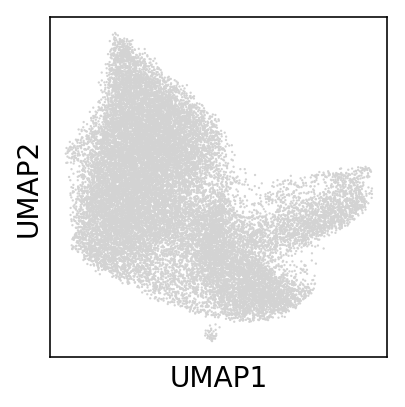

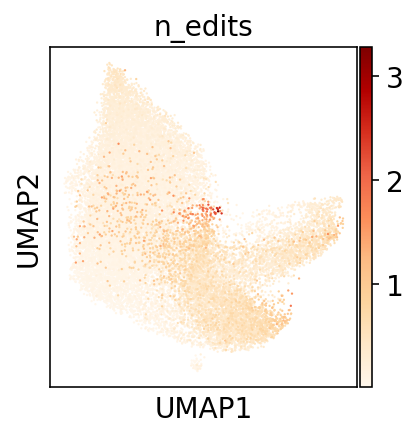

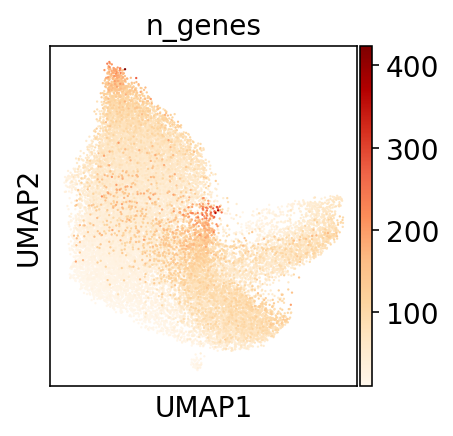

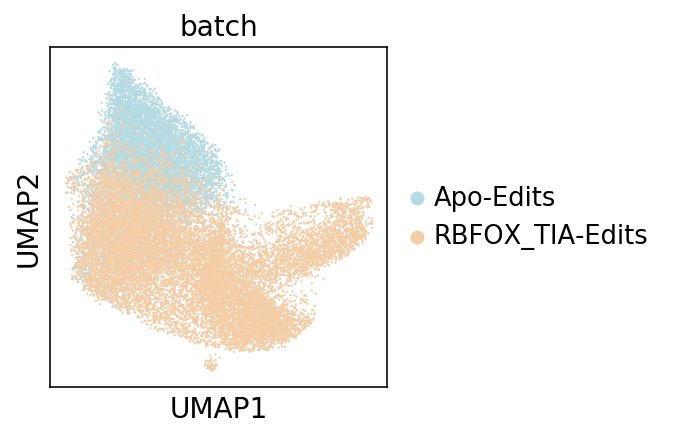

In [65]:
sc.pl.umap(adata)
sc.pl.umap(adata, color='n_edits', cmap='OrRd')
sc.pl.umap(adata, color='n_genes', cmap='OrRd')
sc.pl.umap(adata, color='batch')

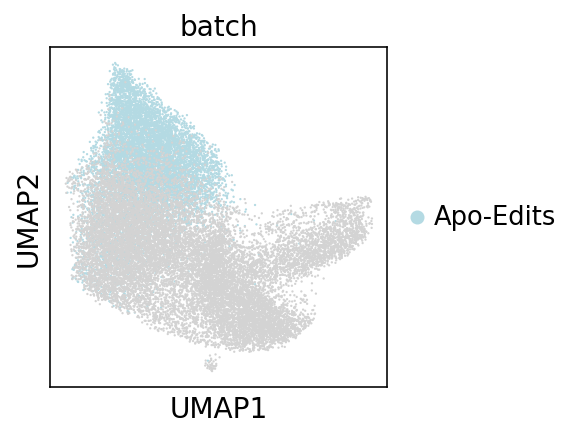

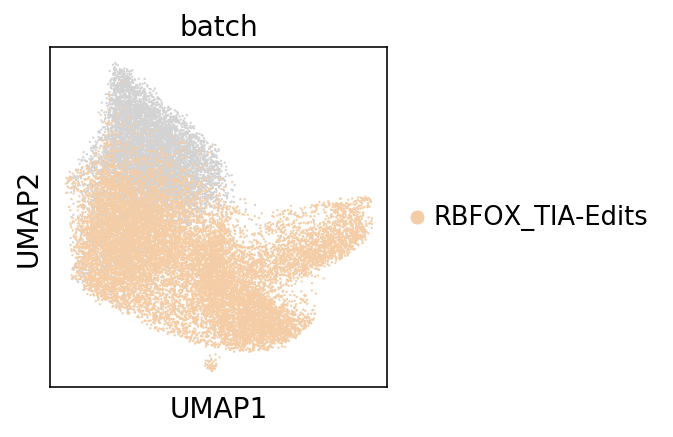

In [66]:
sc.pl.umap(adata, color=['batch'], groups = ['Apo-Edits'])
sc.pl.umap(adata, color=['batch'], groups = ['RBFOX_TIA-Edits'])

In [68]:
test=adata.obs
test2=pd.DataFrame({'X_umap':adata.obsm['X_umap'][:,0],'Y_umap':adata.obsm['X_umap'][:,1]})
test3=pd.DataFrame({'X_pca':adata.obsm['X_pca'][:,0],'Y_pca':adata.obsm['X_pca'][:,1]})

test['X_umap']=test2['X_umap'].tolist()
test['Y_umap']=test2['Y_umap'].tolist()

test['X_pca']=test3['X_pca'].tolist()
test['Y_pca']=test3['Y_pca'].tolist()

print(adata.uns['batch_colors'])

colors_samples={'Apo-Edits':'#B4DAE3',
               'RBFOX_TIA-Edits':'#F4CDA6'}

['#B4DAE3', '#F4CDA6']


([], <a list of 0 Text yticklabel objects>)

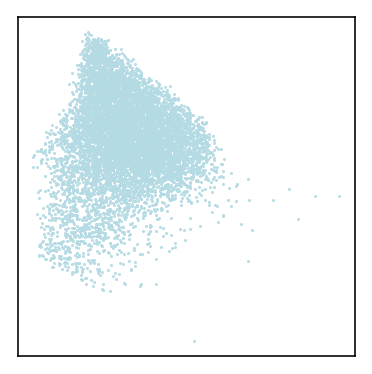

In [69]:
dot_size=1
color_combo=colors_samples
grouping='batch'

################################################

plt.scatter(x=test[test[grouping]=='Apo-Edits']['X_umap'],y=test[test[grouping]=='Apo-Edits']['Y_umap'],
            color=color_combo['Apo-Edits'],s=dot_size,marker='.')
#plt.scatter(x=test[test[grouping]=='RPS2-Edits']['X_umap'],y=test[test[grouping]=='RPS2-Edits']['Y_umap'],
#            color=color_combo['RPS2-Edits'],s=dot_size,marker='.')


################################################

plt.grid(False)
plt.xticks([])
plt.yticks([])

([], <a list of 0 Text yticklabel objects>)

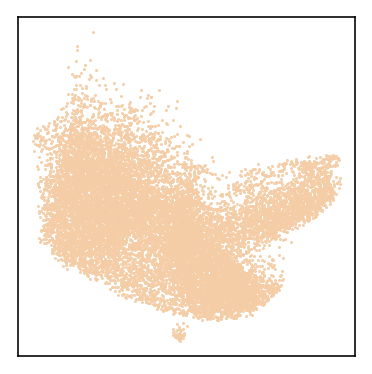

In [70]:
dot_size=1
color_combo=colors_samples
grouping='batch'

################################################

#plt.scatter(x=test[test[grouping]=='Apo-Edits']['X_umap'],y=test[test[grouping]=='Apo-Edits']['Y_umap'],
#            color=color_combo['Apo-Edits'],s=dot_size,marker='.')
plt.scatter(x=test[test[grouping]=='RBFOX_TIA-Edits']['X_umap'],y=test[test[grouping]=='RBFOX_TIA-Edits']['Y_umap'],
            color=color_combo['RBFOX_TIA-Edits'],s=dot_size,marker='.')


################################################

plt.grid(False)
plt.xticks([])
plt.yticks([])

([], <a list of 0 Text yticklabel objects>)

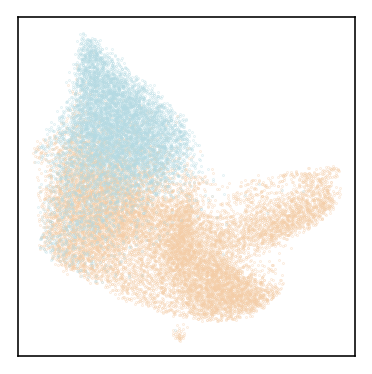

In [71]:
dot_size=0.1
color_combo=colors_samples
grouping='batch'

################################################

plt.scatter(x=test[test[grouping]=='RBFOX_TIA-Edits']['X_umap'],y=test[test[grouping]=='RBFOX_TIA-Edits']['Y_umap'],
            color=color_combo['RBFOX_TIA-Edits'],s=dot_size,marker='.')
plt.scatter(x=test[test[grouping]=='Apo-Edits']['X_umap'],y=test[test[grouping]=='Apo-Edits']['Y_umap'],
            color=color_combo['Apo-Edits'],s=dot_size,marker='.')



################################################

plt.grid(False)
plt.xticks([])
plt.yticks([])

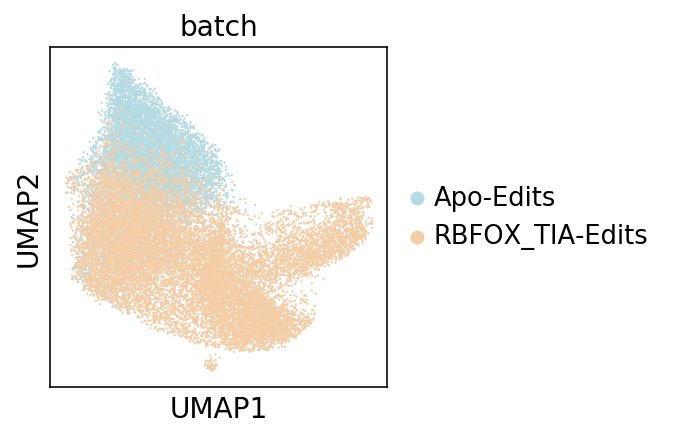

In [72]:
sc.pl.umap(adata, color='batch')

In [73]:
adata.obs['batch'].value_counts()

RBFOX_TIA-Edits    14467
Apo-Edits           8117
Name: batch, dtype: int64

# grabbing TIA and RBFOX barcodes from read1_feature_FB_R1_TrimTo10 #

In [74]:
TIA_barcodes=pd.read_csv('./results/TIA1_ORF_matrix.csv',index_col=0)
TIA_barcodes=TIA_barcodes.reset_index()
TIA_barcodes['index']='possorted_genome_bam_MD-'+TIA_barcodes['index'].astype(str)+'-RBFOX_TIA-Edits'
TIA_barcodes=TIA_barcodes.set_index('index', drop=True)
TIA_barcodes=TIA_barcodes[TIA_barcodes['TIA1_ORF']>0]
TIA_barcodes

,TIA1_ORF
index,
possorted_genome_bam_MD-GTGAGTTCAACAGATA-1-RBFOX_TIA-Edits,2.832962
possorted_genome_bam_MD-TCACATTCAAATGAAC-1-RBFOX_TIA-Edits,2.337002
possorted_genome_bam_MD-ATCGTGAGTCCATACA-1-RBFOX_TIA-Edits,2.181383
possorted_genome_bam_MD-CCTCCTCCATCGATGT-1-RBFOX_TIA-Edits,2.172716
possorted_genome_bam_MD-CGGAGAACAGCACAAG-1-RBFOX_TIA-Edits,2.155660
...,...
possorted_genome_bam_MD-GAAATGACAGTCAGTT-1-RBFOX_TIA-Edits,0.243992
possorted_genome_bam_MD-GATGACTAGGGAGTTC-1-RBFOX_TIA-Edits,0.240746
possorted_genome_bam_MD-AGGGTCCCATCAGTGT-1-RBFOX_TIA-Edits,0.234861


In [75]:
RBFOX_barcodes=pd.read_csv('./results/RBFOX2_ORF_matrix.csv',index_col=0)
RBFOX_barcodes=RBFOX_barcodes.reset_index()
RBFOX_barcodes['index']='possorted_genome_bam_MD-'+RBFOX_barcodes['index'].astype(str)+'-RBFOX_TIA-Edits'
RBFOX_barcodes=RBFOX_barcodes.set_index('index', drop=True)
RBFOX_barcodes=RBFOX_barcodes[RBFOX_barcodes['RBFOX2_ORF']>0]
RBFOX_barcodes

,RBFOX2_ORF
index,
possorted_genome_bam_MD-TGCGGGTGTGTTCCTC-1-RBFOX_TIA-Edits,2.190145
possorted_genome_bam_MD-ACGGTTAAGTGGTTAA-1-RBFOX_TIA-Edits,2.075209
possorted_genome_bam_MD-TCAGTGAGTGGGTATG-1-RBFOX_TIA-Edits,1.948830
possorted_genome_bam_MD-GAAGCCCGTCAATGGG-1-RBFOX_TIA-Edits,1.734930
possorted_genome_bam_MD-ATTCGTTTCGGTTCAA-1-RBFOX_TIA-Edits,1.696412
...,...
possorted_genome_bam_MD-TGCGGCATCACCTGGG-1-RBFOX_TIA-Edits,0.205525
possorted_genome_bam_MD-CATTCATAGAAGAGCA-1-RBFOX_TIA-Edits,0.201960
possorted_genome_bam_MD-CCCTTAGTCATGACAC-1-RBFOX_TIA-Edits,0.198398


In [76]:
RBFOX_list = list(RBFOX_barcodes.index)
TIA_list = list(TIA_barcodes.index)

In [77]:
df=adata.obs
def in_list (row, r=RBFOX_list, t=TIA_list):
    if (row['index'] in r) and (row['index'] in t):
        return 'double pos.'
    if row['index'] in r :
        return 'RBFOX2_ORF'
    if row['index'] in t:
        return 'TIA1_ORF'

dx=df.reset_index()
dx['feature']=dx.apply(in_list, axis=1)
dx=dx.set_index('index', drop=True)
dx

,batch,n_edits,n_genes,X_umap,Y_umap,X_pca,Y_pca,feature
index,,,,,,,,
Apo_Control_possorted_genome_bam_MD-AAACCCAAGCCAGTAG-1-Apo-Edits,Apo-Edits,0.165572,64,-3.615313,2.864503,3.621990,1.114743,None
Apo_Control_possorted_genome_bam_MD-AAACCCAAGGATGCGT-1-Apo-Edits,Apo-Edits,0.205225,89,-2.408242,4.294646,7.188318,0.330370,None
Apo_Control_possorted_genome_bam_MD-AAACCCACAATACAGA-1-Apo-Edits,Apo-Edits,0.109124,41,-4.064887,-1.800122,1.400620,-0.479442,None
Apo_Control_possorted_genome_bam_MD-AAACCCACACGCAGTC-1-Apo-Edits,Apo-Edits,0.175402,66,-2.481293,2.687161,2.693989,0.994325,None
Apo_Control_possorted_genome_bam_MD-AAACCCACAGAACATA-1-Apo-Edits,Apo-Edits,0.143453,59,-2.443547,1.648865,0.498504,-0.642307,None
...,...,...,...,...,...,...,...,...
possorted_genome_bam_MD-TTTGTTGTCACTCGAA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.036992,17,-3.622442,-2.436381,-1.300432,-0.215013,None
possorted_genome_bam_MD-TTTGTTGTCATTTCCA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.831829,139,-2.921419,-3.038504,-0.797066,-4.619312,None
possorted_genome_bam_MD-TTTGTTGTCCTATGGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.191077,53,1.036380,-2.426408,-2.596271,-0.931045,None


In [78]:
dx['feature'].value_counts()

RBFOX2_ORF     844
TIA1_ORF       518
double pos.      9
Name: feature, dtype: int64

In [79]:
adata.obs=dx

In [228]:
adata.uns['feature_colors']=['#D3D3D3', '#ff7f0e', '#279e68', '#d62728']
#adata.uns['feature_colors']=['#D3D3D3', '#ff0000', '#e6e600', '#000000']

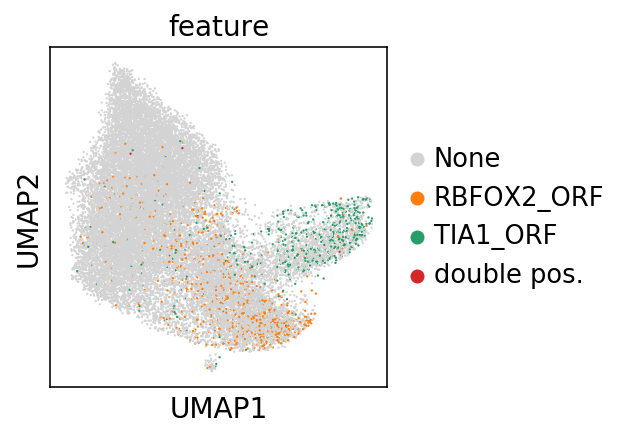

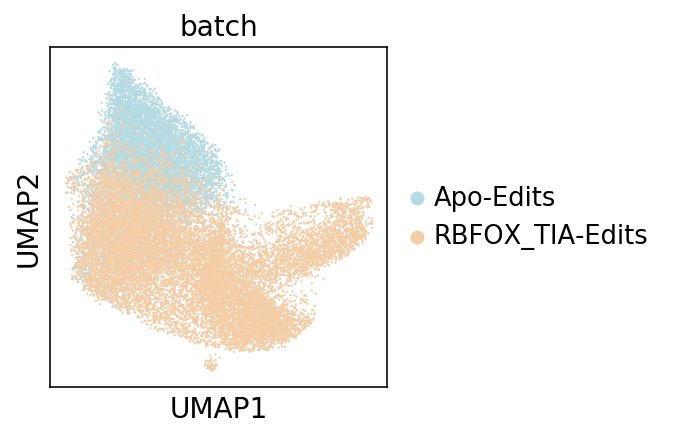

In [229]:
sc.pl.umap(adata, color=['feature'])
sc.pl.umap(adata, color=['batch'])

([], <a list of 0 Text yticklabel objects>)

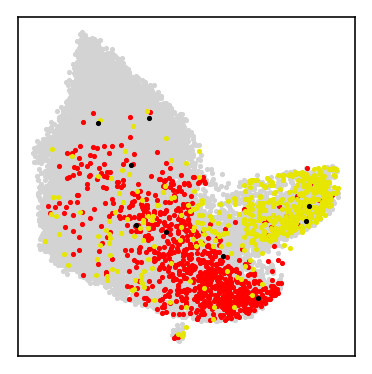

In [88]:
test=adata.obs
test2=pd.DataFrame({'X_umap':adata.obsm['X_umap'][:,0],'Y_umap':adata.obsm['X_umap'][:,1]})
test3=pd.DataFrame({'X_pca':adata.obsm['X_pca'][:,0],'Y_pca':adata.obsm['X_pca'][:,1]})

test['X_umap']=test2['X_umap'].tolist()
test['Y_umap']=test2['Y_umap'].tolist()

test['X_pca']=test3['X_pca'].tolist()
test['Y_pca']=test3['Y_pca'].tolist()

colors_samples={'None':'#D3D3D3',
                'RBFOX2_ORF':'#ff0000',
                'TIA1_ORF':'#e6e600',
                'double pos.':'#000000'}

dot_size=10
color_combo=colors_samples
grouping='feature'

################################################

plt.scatter(x=test[test[grouping]=='None']['X_umap'],y=test[test[grouping]=='None']['Y_umap'],
            color=color_combo['None'],s=dot_size,marker='.')
plt.scatter(x=test[test[grouping]=='RBFOX2_ORF']['X_umap'],y=test[test[grouping]=='RBFOX2_ORF']['Y_umap'],
            color=color_combo['RBFOX2_ORF'],s=dot_size,marker='.')
plt.scatter(x=test[test[grouping]=='TIA1_ORF']['X_umap'],y=test[test[grouping]=='TIA1_ORF']['Y_umap'],
            color=color_combo['TIA1_ORF'],s=dot_size,marker='.')
plt.scatter(x=test[test[grouping]=='double pos.']['X_umap'],y=test[test[grouping]=='double pos.']['Y_umap'],
            color=color_combo['double pos.'],s=dot_size,marker='.')


################################################

plt.grid(False)
plt.xticks([])
plt.yticks([])
#plt.legend(['None','RBFOX2_ORF','TIA1_ORF','double pos.'],loc='upper left',bbox_to_anchor=(1,1))

## feature by expression level ##

In [95]:
RBFOX_barcodes=pd.read_csv('./results/RBFOX2_ORF_matrix.csv',index_col=0)
RBFOX_barcodes=RBFOX_barcodes.reset_index()
RBFOX_barcodes['index']='possorted_genome_bam_MD-'+RBFOX_barcodes['index'].astype(str)+'-RBFOX_TIA-Edits'
RBFOX_barcodes=RBFOX_barcodes.set_index('index', drop=True)

In [90]:
df=adata.obs
def in_list (row, l=RBFOX_barcodes):
    if (row['index'] in l.index):
        return l.loc[row['index'],'RBFOX2_ORF']
    else:
        return 0

dx=df.reset_index()
dx['RBFOX2_ORF']=dx.apply(in_list, axis=1)
dx=dx.set_index('index', drop=True)
dx

,batch,n_edits,n_genes,X_umap,Y_umap,X_pca,Y_pca,feature,RBFOX2_ORF
index,,,,,,,,,
Apo_Control_possorted_genome_bam_MD-AAACCCAAGCCAGTAG-1-Apo-Edits,Apo-Edits,0.165572,64,-3.615313,2.864503,3.621990,1.114743,None,0.0
Apo_Control_possorted_genome_bam_MD-AAACCCAAGGATGCGT-1-Apo-Edits,Apo-Edits,0.205225,89,-2.408242,4.294646,7.188318,0.330370,None,0.0
Apo_Control_possorted_genome_bam_MD-AAACCCACAATACAGA-1-Apo-Edits,Apo-Edits,0.109124,41,-4.064887,-1.800122,1.400620,-0.479442,None,0.0
Apo_Control_possorted_genome_bam_MD-AAACCCACACGCAGTC-1-Apo-Edits,Apo-Edits,0.175402,66,-2.481293,2.687161,2.693989,0.994325,None,0.0
Apo_Control_possorted_genome_bam_MD-AAACCCACAGAACATA-1-Apo-Edits,Apo-Edits,0.143453,59,-2.443547,1.648865,0.498504,-0.642307,None,0.0
...,...,...,...,...,...,...,...,...,...
possorted_genome_bam_MD-TTTGTTGTCACTCGAA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.036992,17,-3.622442,-2.436381,-1.300432,-0.215013,None,0.0
possorted_genome_bam_MD-TTTGTTGTCATTTCCA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.831829,139,-2.921419,-3.038504,-0.797066,-4.619312,None,0.0
possorted_genome_bam_MD-TTTGTTGTCCTATGGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.191077,53,1.036380,-2.426408,-2.596271,-0.931045,None,0.0


In [91]:
adata.obs=dx

In [ ]:
TIA_barcodes=pd.read_csv('./results/TIA1_ORF_matrix.csv',index_col=0)
TIA_barcodes=TIA_barcodes.reset_index()
TIA_barcodes['index']='possorted_genome_bam_MD-'+TIA_barcodes['index'].astype(str)+'-RBFOX_TIA-Edits'
TIA_barcodes=TIA_barcodes.set_index('index', drop=True)

In [96]:
df=adata.obs
def in_list (row, l=TIA_barcodes):
    if (row['index'] in l.index):
        return l.loc[row['index'],'TIA1_ORF']
    else:
        return 0

dx=df.reset_index()
dx['TIA1_ORF']=dx.apply(in_list, axis=1)
dx=dx.set_index('index', drop=True)
dx

,batch,n_edits,n_genes,X_umap,Y_umap,X_pca,Y_pca,feature,RBFOX2_ORF,TIA1_ORF
index,,,,,,,,,,
Apo_Control_possorted_genome_bam_MD-AAACCCAAGCCAGTAG-1-Apo-Edits,Apo-Edits,0.165572,64,-3.615313,2.864503,3.621990,1.114743,None,0.0,0.0
Apo_Control_possorted_genome_bam_MD-AAACCCAAGGATGCGT-1-Apo-Edits,Apo-Edits,0.205225,89,-2.408242,4.294646,7.188318,0.330370,None,0.0,0.0
Apo_Control_possorted_genome_bam_MD-AAACCCACAATACAGA-1-Apo-Edits,Apo-Edits,0.109124,41,-4.064887,-1.800122,1.400620,-0.479442,None,0.0,0.0
Apo_Control_possorted_genome_bam_MD-AAACCCACACGCAGTC-1-Apo-Edits,Apo-Edits,0.175402,66,-2.481293,2.687161,2.693989,0.994325,None,0.0,0.0
Apo_Control_possorted_genome_bam_MD-AAACCCACAGAACATA-1-Apo-Edits,Apo-Edits,0.143453,59,-2.443547,1.648865,0.498504,-0.642307,None,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...
possorted_genome_bam_MD-TTTGTTGTCACTCGAA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.036992,17,-3.622442,-2.436381,-1.300432,-0.215013,None,0.0,0.0
possorted_genome_bam_MD-TTTGTTGTCATTTCCA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.831829,139,-2.921419,-3.038504,-0.797066,-4.619312,None,0.0,0.0
possorted_genome_bam_MD-TTTGTTGTCCTATGGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.191077,53,1.036380,-2.426408,-2.596271,-0.931045,None,0.0,0.0


In [97]:
adata.obs=dx

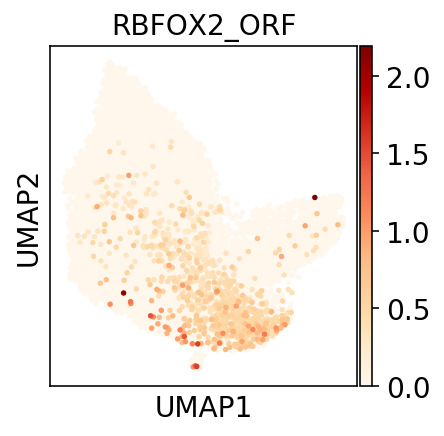

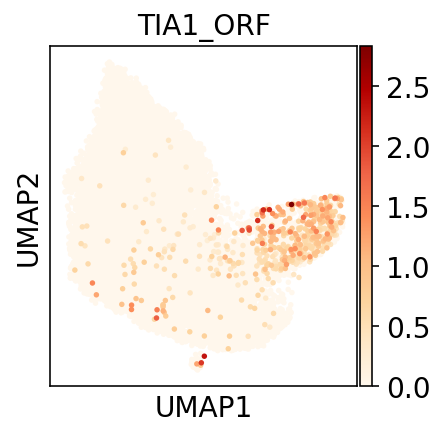

In [98]:
sc.pl.umap(adata, color=['RBFOX2_ORF'],cmap='OrRd', size=30)
sc.pl.umap(adata, color=['TIA1_ORF'],cmap='OrRd', size=30)

In [99]:
sc.tl.louvain(adata, resolution=3, key_added='louvain_r3')
sc.tl.louvain(adata, resolution=2, key_added='louvain_r2')
sc.tl.louvain(adata, resolution=1.5, key_added='louvain_r15')
sc.tl.louvain(adata, resolution=1.2, key_added='louvain_r12')
sc.tl.louvain(adata)
sc.tl.louvain(adata, resolution=0.5, key_added='louvain_r0.5')
sc.tl.louvain(adata, resolution=0.2, key_added='louvain_r0.2')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 54 clusters and added
    'louvain_r3', the cluster labels (adata.obs, categorical) (0:00:03)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 26 clusters and added
    'louvain_r2', the cluster labels (adata.obs, categorical) (0:00:02)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 19 clusters and added
    'louvain_r15', the cluster labels (adata.obs, categorical) (0:00:02)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 15 clusters and added
    'louvain_r12', the cluster labels (adata.obs, categorical) (0:00:01)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 12 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:02)
running Louvain clustering
    using the "louvain" packa

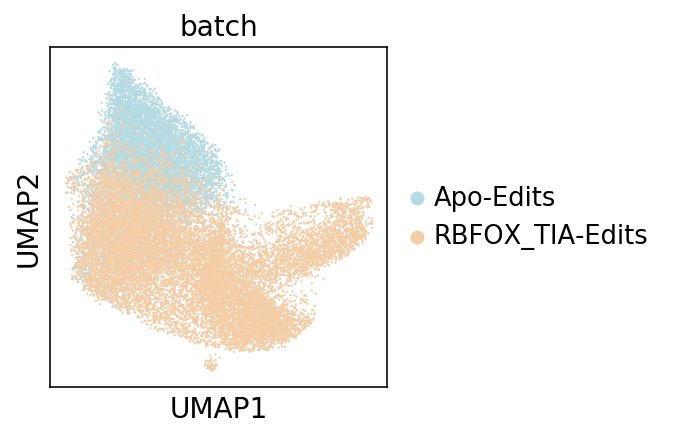

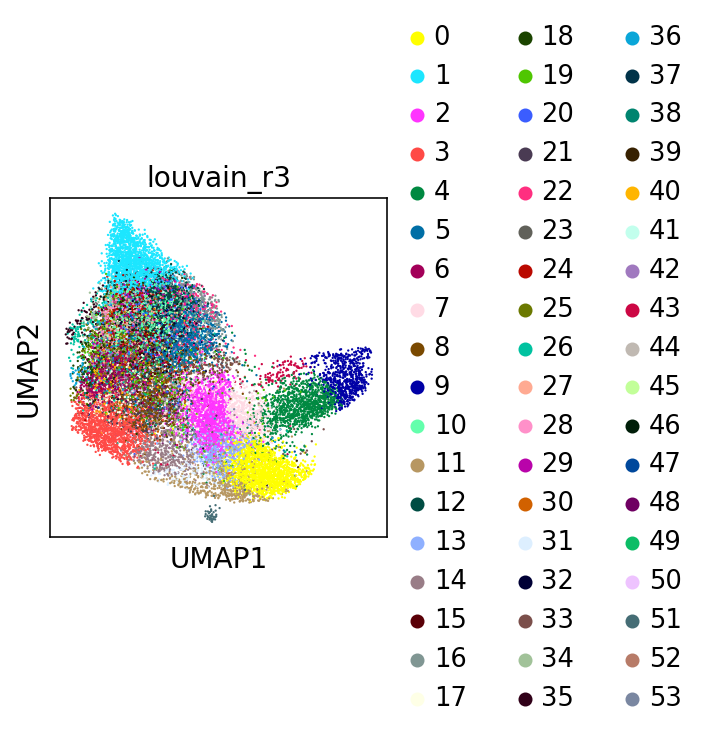

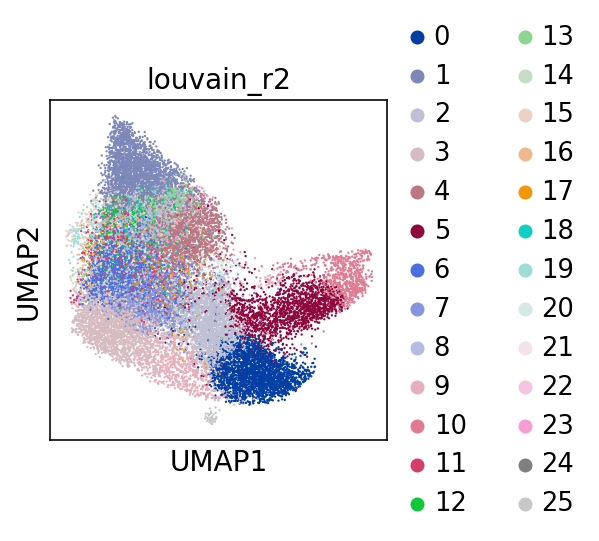

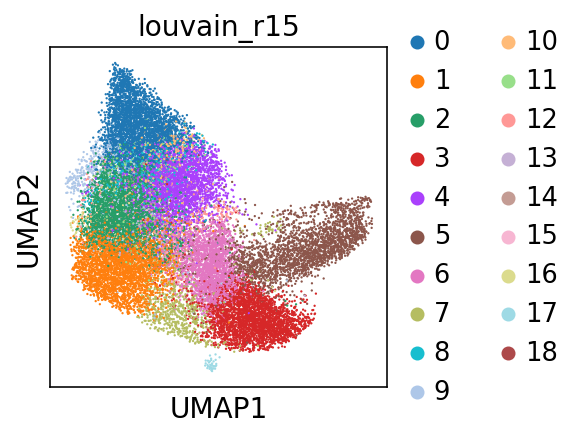

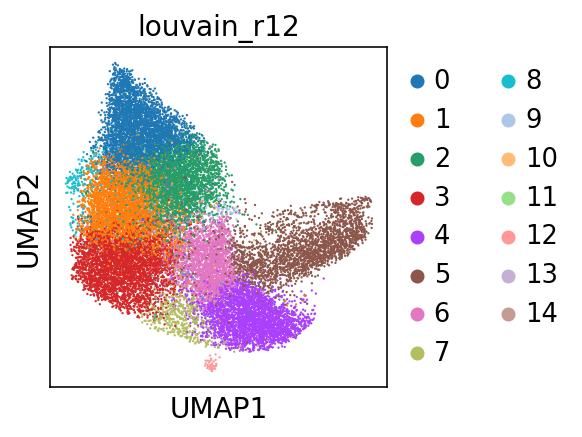

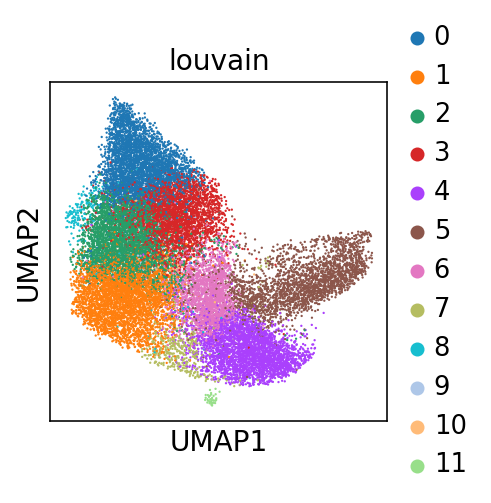

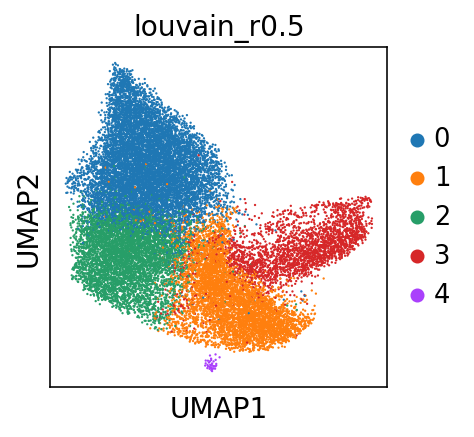

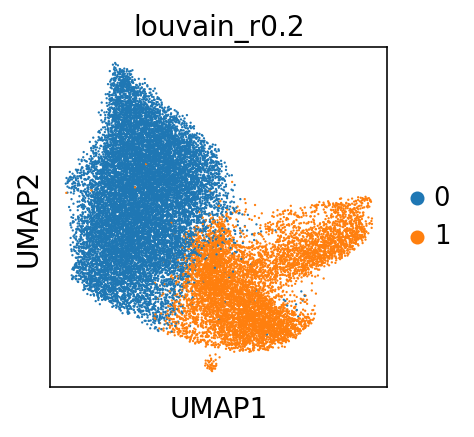

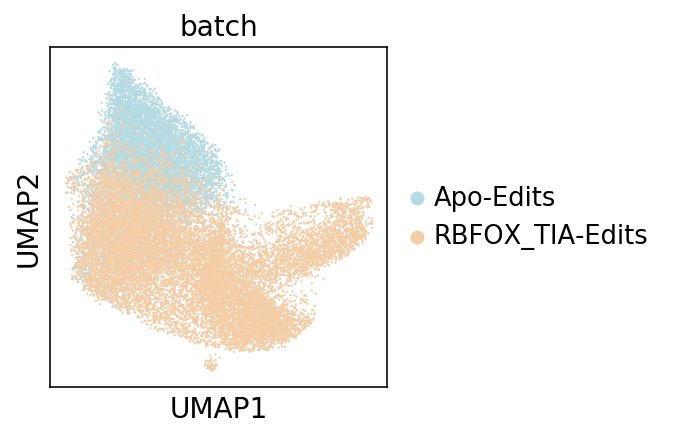

In [100]:
sc.pl.umap(adata, color=['batch'])
sc.pl.umap(adata, color=['louvain_r3'])
sc.pl.umap(adata, color=['louvain_r2'])
sc.pl.umap(adata, color=['louvain_r15'])
sc.pl.umap(adata, color=['louvain_r12'])
sc.pl.umap(adata, color=['louvain'])
sc.pl.umap(adata, color=['louvain_r0.5'])
sc.pl.umap(adata, color=['louvain_r0.2'])
sc.pl.umap(adata, color=['batch'])

In [204]:
adata.write(results_dir+'02_02_Merge_APO_with_RBFOX_TIA_edits_over_Cs_adata.h5ad')

In [287]:
adata = sc.read(results_dir+'02_02_Merge_APO_with_RBFOX_TIA_edits_over_Cs_adata.h5ad')

## spliting into 3 groups non-overlaping-with-APO RBFOX2 and TIA1 and Apo all for proper comparisons ##

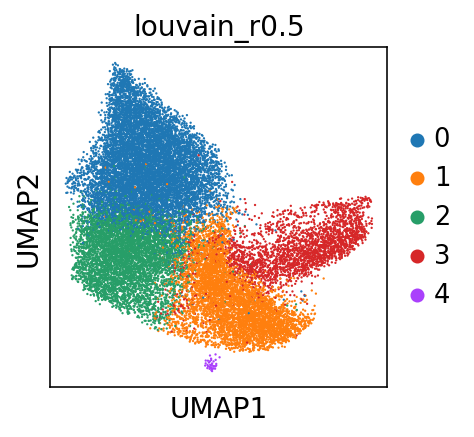

In [288]:
sc.pl.umap(adata, color=['louvain_r0.5'])

In [289]:
adata.obs['new_clusters'] = (
    adata.obs['louvain_r0.5']
    .map(lambda x: {'0':'2'}.get(x, x))
    .astype("category")
)

In [290]:
adata.obs['new_clusters'] = (
    adata.obs['new_clusters']
    .map(lambda x: {'1':'4'}.get(x, x))
    .astype("category")
)

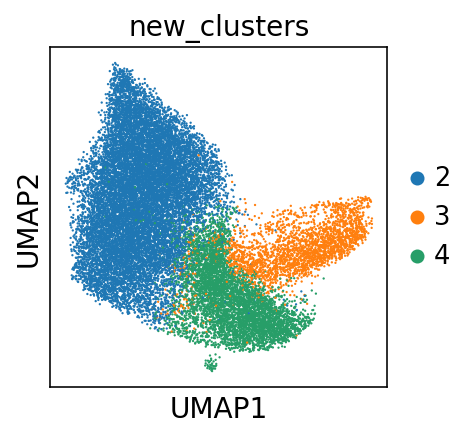

In [291]:
sc.pl.umap(adata, color=['new_clusters'])

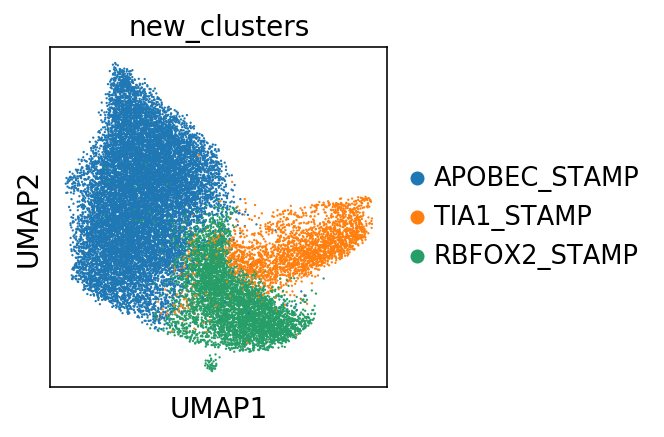

In [305]:
new_cluster_names = [
    'APOBEC_STAMP', 'TIA1_STAMP','RBFOX2_STAMP']
adata.rename_categories('new_clusters', new_cluster_names)
sc.pl.umap(adata, color=['new_clusters'])

In [306]:
sc.tl.rank_genes_groups(adata,groupby='new_clusters',method='wilcoxon',n_genes=100)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:05)


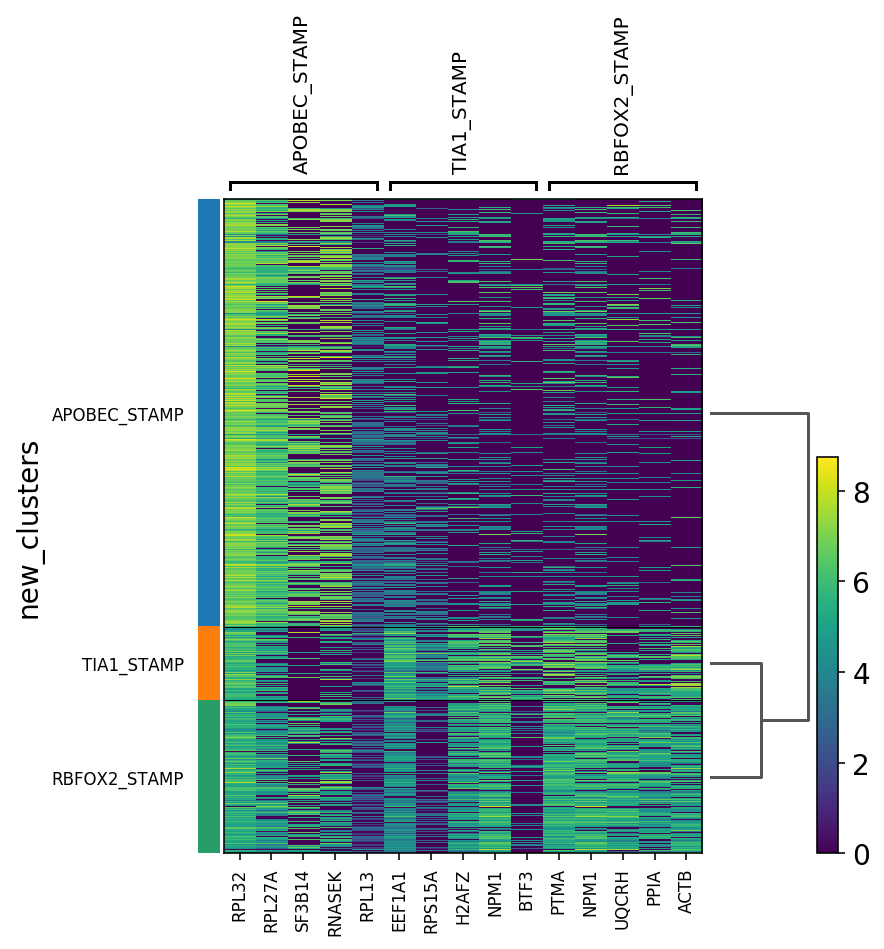

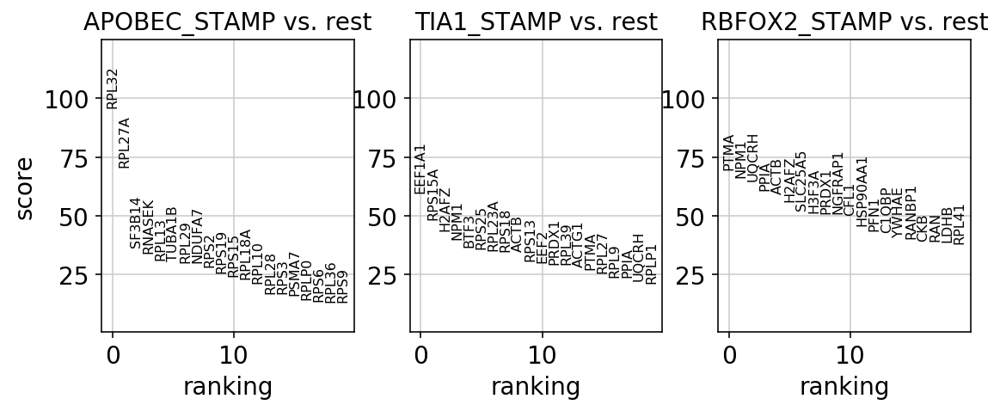

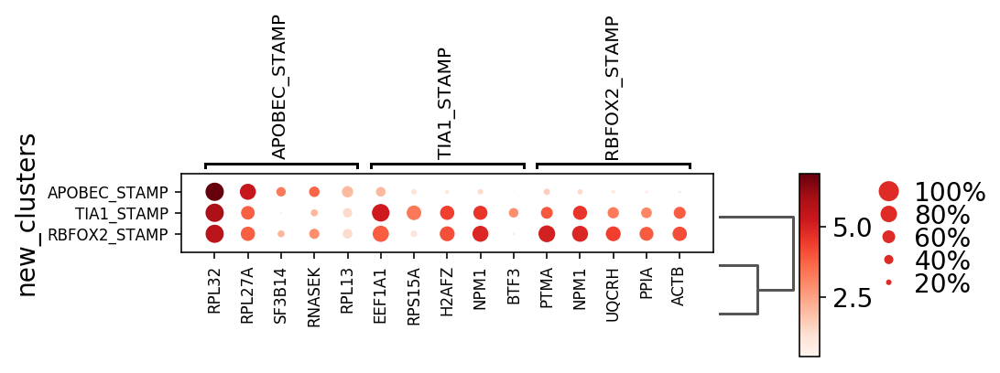

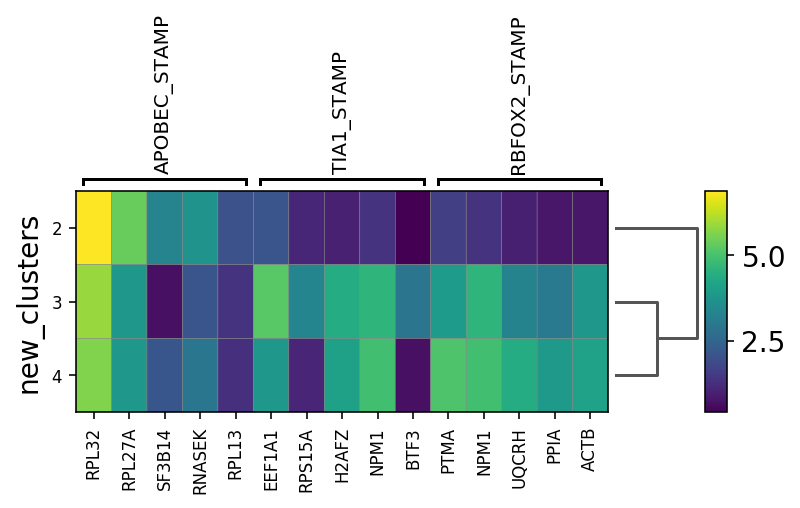

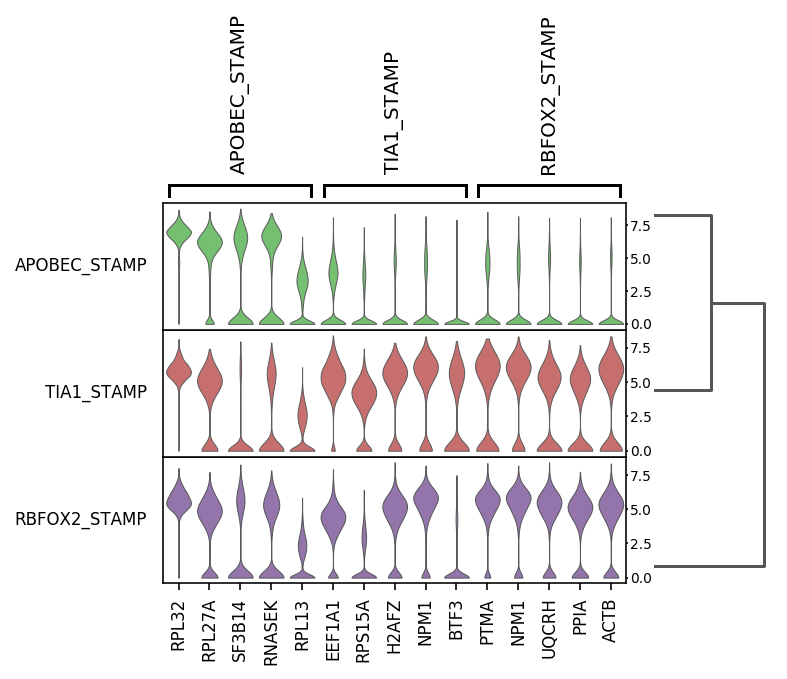

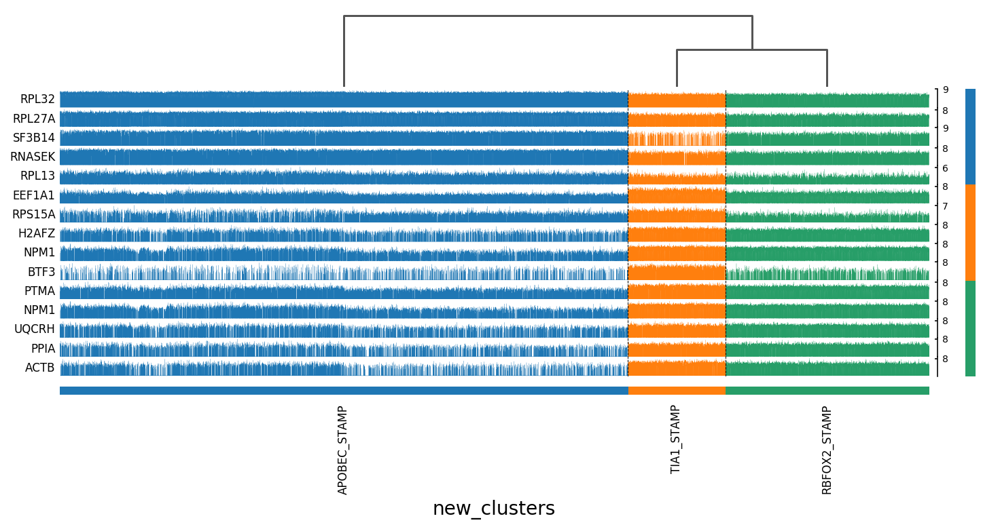

In [307]:
sc.pl.rank_genes_groups_heatmap(adata,key='rank_genes_groups',n_genes=5,cmap='viridis')
sc.pl.rank_genes_groups(adata, n_genes=20)
sc.pl.rank_genes_groups_dotplot(adata,key='rank_genes_groups',n_genes=5)
sc.pl.rank_genes_groups_matrixplot(adata,key='rank_genes_groups',n_genes=5)
sc.pl.rank_genes_groups_stacked_violin(adata,key='rank_genes_groups',n_genes=5)
#sc.pl.rank_genes_groups_violin(adata_subset,key='rank_genes_groups',n_genes=5)
sc.pl.rank_genes_groups_tracksplot(adata,key='rank_genes_groups',n_genes=5)

In [395]:
adata.uns['rank_genes_groups']

{'params': {'groupby': 'new_clusters',
  'reference': 'rest',
  'method': 'wilcoxon',
  'use_raw': True,
  'corr_method': 'benjamini-hochberg'},
 'scores': rec.array([(96.1836   , 59.7025    , 69.89323  ),
            (70.89932  , 48.457542  , 66.50983  ),
            (36.87694  , 43.8984    , 65.00808  ),
            (34.389977 , 40.126766  , 60.906666 ),
            (31.252083 , 36.715034  , 59.358288 ),
            (30.809547 , 36.06092   , 56.172337 ),
            (30.398573 , 35.435886  , 52.41147  ),
            (30.33577  , 35.02872   , 51.35348  ),
            (28.234959 , 34.868935  , 50.975742 ),
            (25.902699 , 30.787144  , 50.958714 ),
            (24.304405 , 30.32784   , 50.466793 ),
            (23.333694 , 29.555162  , 46.09473  ),
            (21.399593 , 29.34705   , 43.592304 ),
            (17.135302 , 28.427643  , 42.889576 ),
            (17.108248 , 27.12993   , 41.06459  ),
            (16.289717 , 25.698381  , 40.301304 ),
            (14.433769 , 24.0

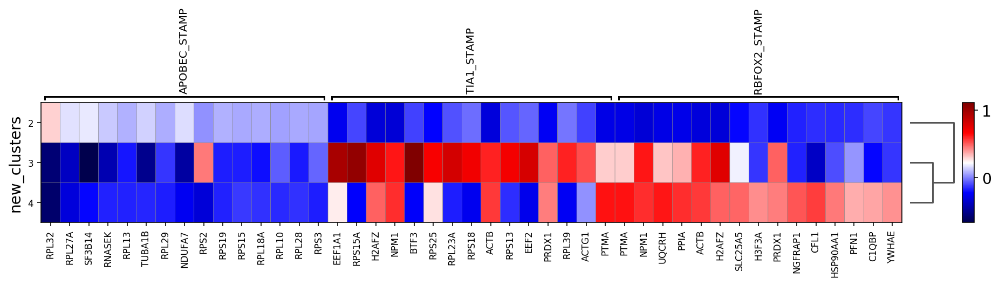

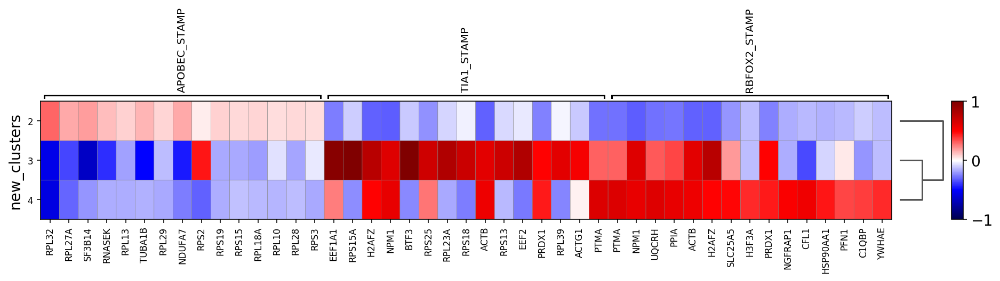

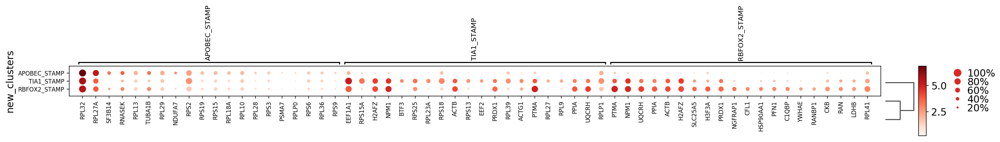

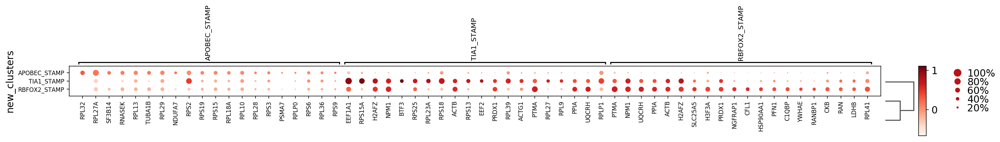

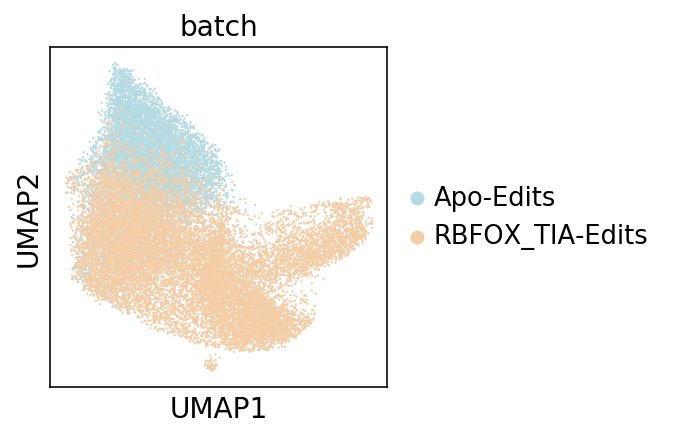

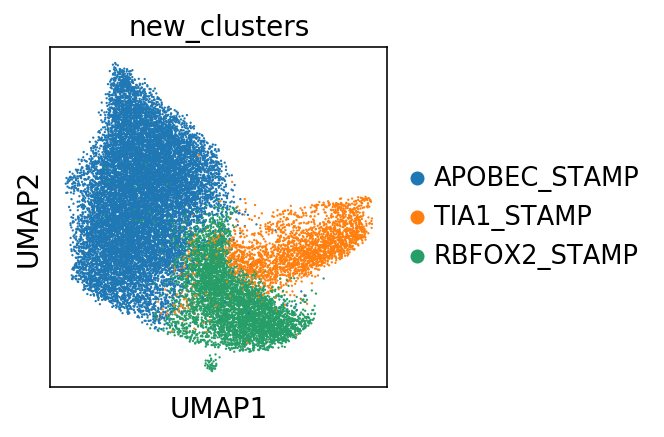

In [375]:
sc.pl.rank_genes_groups_matrixplot(adata,key='rank_genes_groups',n_genes=15,
                                   cmap='seismic', use_raw=False)
sc.pl.rank_genes_groups_matrixplot(adata,key='rank_genes_groups',n_genes=15,
                                   cmap='seismic', use_raw=False, vmin=-1, vmax=1)
sc.pl.rank_genes_groups_dotplot(adata,key='rank_genes_groups',n_genes=20)
sc.pl.rank_genes_groups_dotplot(adata,key='rank_genes_groups',n_genes=20,use_raw=False)

sc.pl.umap(adata, color=['batch'])
sc.pl.umap(adata, color=['new_clusters'])

In [310]:
bulk_dir='/projects/ps-yeolab3/bay001/for_alexc'

In [312]:
bulk_TIA1 = pd.read_csv(
    os.path.join(bulk_dir, 'Tia1_1000ng_1_S14_L001_R1_001.fastqTr.sorted.STARUnmapped.out.sorted.STARAligned.out.sorted_a0_b0_e0.01.annotated.exons.merged.txt.wgenenames.txt'),
    sep='\t',
    index_col=0
)
print(bulk_TIA1.shape)
bulk_TIA1.head()

(9103, 6)


,edit_coverage,editable_coverage,all_c_coverage,edited_over_edited_c,edited_over_all_c,genename
name,,,,,,
ENSG00000163273.3,10,30,245,0.333333,0.040816,NPPC
ENSG00000198695.2,33,33,1310,1.000000,0.025191,MT-ND6
ENSG00000221821.2,2,10,165,0.200000,0.012121,C6orf226
ENSGR0000002586.13,5,15,458,0.333333,0.010917,CD99
ENSG00000197780.5,22,262,2148,0.083969,0.010242,TAF13


In [313]:
bulk_RBFOX2 = pd.read_csv(
    os.path.join(bulk_dir, 'Sample27_S37_merged.fastqTr.sorted.STARUnmapped.out.sorted.STARAligned.out.sorted_a0_b0_e0.01.annotated.exons.merged.txt.wgenenames.txt'),
    sep='\t',
    index_col=0
)
print(bulk_RBFOX2.shape)
bulk_RBFOX2.head()

(5910, 6)


,edit_coverage,editable_coverage,all_c_coverage,edited_over_edited_c,edited_over_all_c,genename
name,,,,,,
ENSG00000166710.13,93,776,3448,0.119845,0.026972,B2M
ENSG00000222014.4,5,32,192,0.156250,0.026042,RAB6C
ENSG00000267697.1,25,362,1044,0.069061,0.023946,LUZP6
ENSG00000198695.2,14,14,592,1.000000,0.023649,MT-ND6
ENSG00000165704.10,100,1043,4581,0.095877,0.021829,HPRT1


In [388]:
bulk_APO = pd.read_csv(
    os.path.join(bulk_dir, 'Sample13_S31_merged.fastqTr.sorted.STARUnmapped.out.sorted.STARAligned.out.sorted_a0_b0_e0.01.annotated.exons.merged.txt.wgenenames.txt'),
    sep='\t',
    index_col=0
)
print(bulk_APO.shape)
bulk_APO.head()

(3206, 6)


,edit_coverage,editable_coverage,all_c_coverage,edited_over_edited_c,edited_over_all_c,genename
name,,,,,,
ENSG00000198695.2,13,13,672,1.000000,0.019345,MT-ND6
ENSG00000163156.7,10,14,1726,0.714286,0.005794,SCNM1
ENSG00000137947.7,11,11,2273,1.000000,0.004839,GTF2B
ENSG00000107105.10,4,5,851,0.800000,0.004700,ELAVL2
ENSG00000162851.6,6,6,1286,1.000000,0.004666,TFB2M


In [389]:
bulk_APO.sort_values(by='edited_over_all_c', ascending=False).head(10)

,edit_coverage,editable_coverage,all_c_coverage,edited_over_edited_c,edited_over_all_c,genename
name,,,,,,
ENSG00000198695.2,13,13,672,1.000000,0.019345,MT-ND6
ENSG00000163156.7,10,14,1726,0.714286,0.005794,SCNM1
ENSG00000137947.7,11,11,2273,1.000000,0.004839,GTF2B
ENSG00000107105.10,4,5,851,0.800000,0.004700,ELAVL2
ENSG00000162851.6,6,6,1286,1.000000,0.004666,TFB2M
ENSG00000099817.7,49,82,10706,0.597561,0.004577,POLR2E
ENSG00000198886.2,133,590,31351,0.225424,0.004242,MT-ND4
ENSG00000137764.15,4,11,1016,0.363636,0.003937,MAP2K5
ENSG00000198763.3,69,314,18035,0.219745,0.003826,MT-ND2


/home/iachaim/anaconda3/envs/scanpy/lib/python3.7/site-packages/anndata/core/anndata.py:299: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()


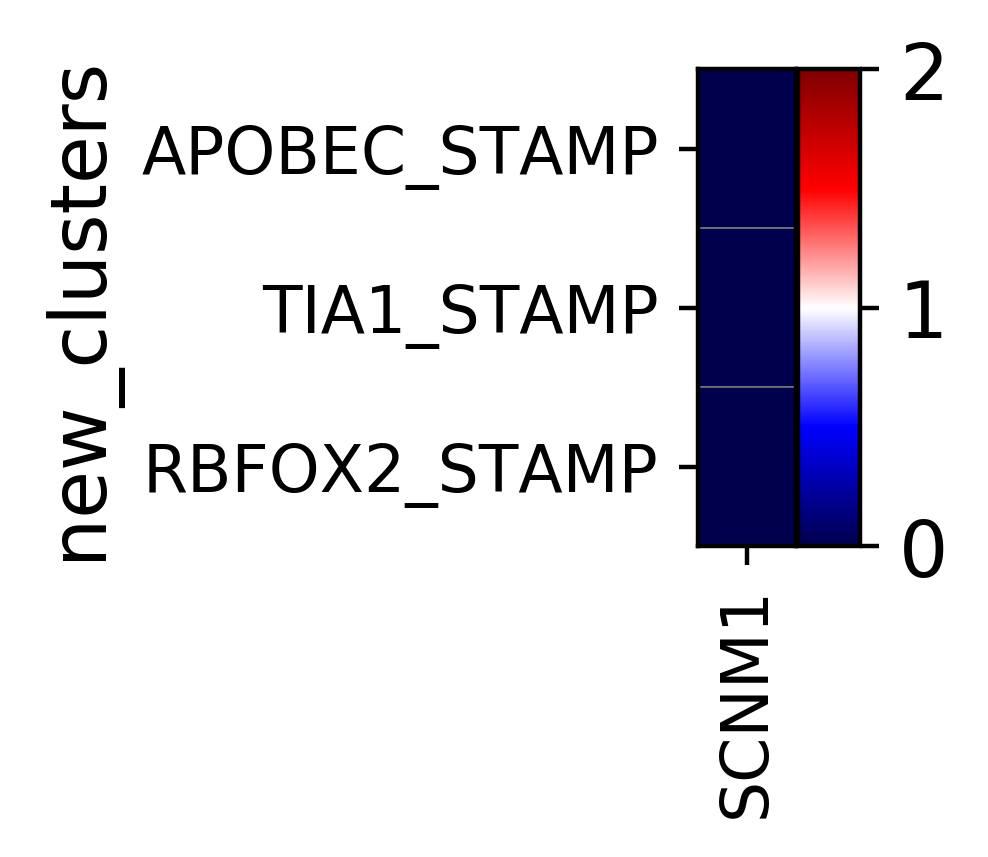

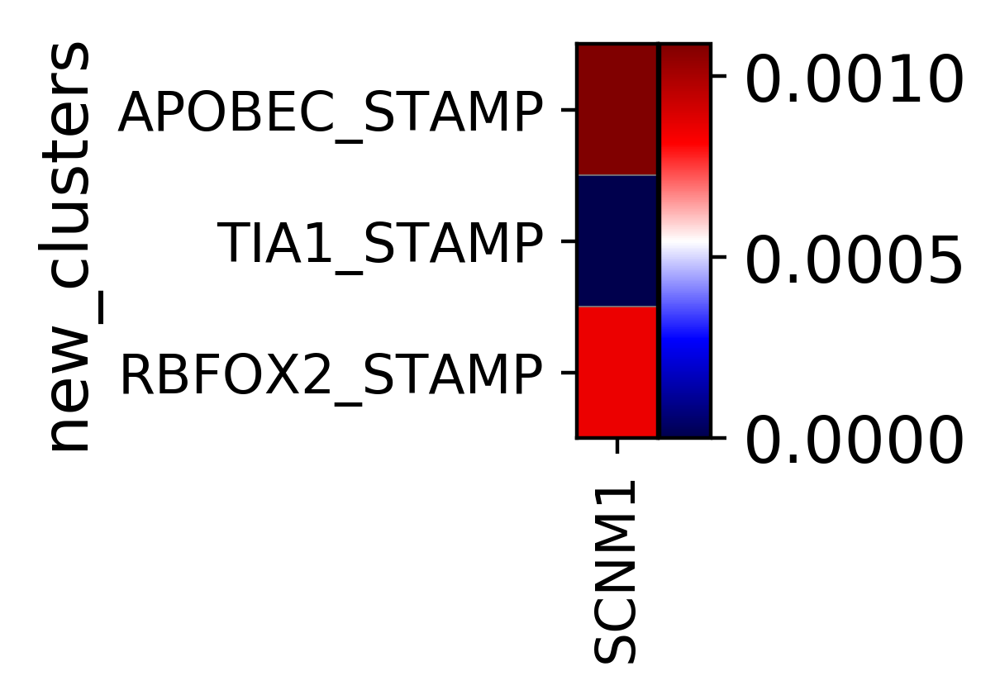

/home/iachaim/anaconda3/envs/scanpy/lib/python3.7/site-packages/anndata/core/anndata.py:846: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()


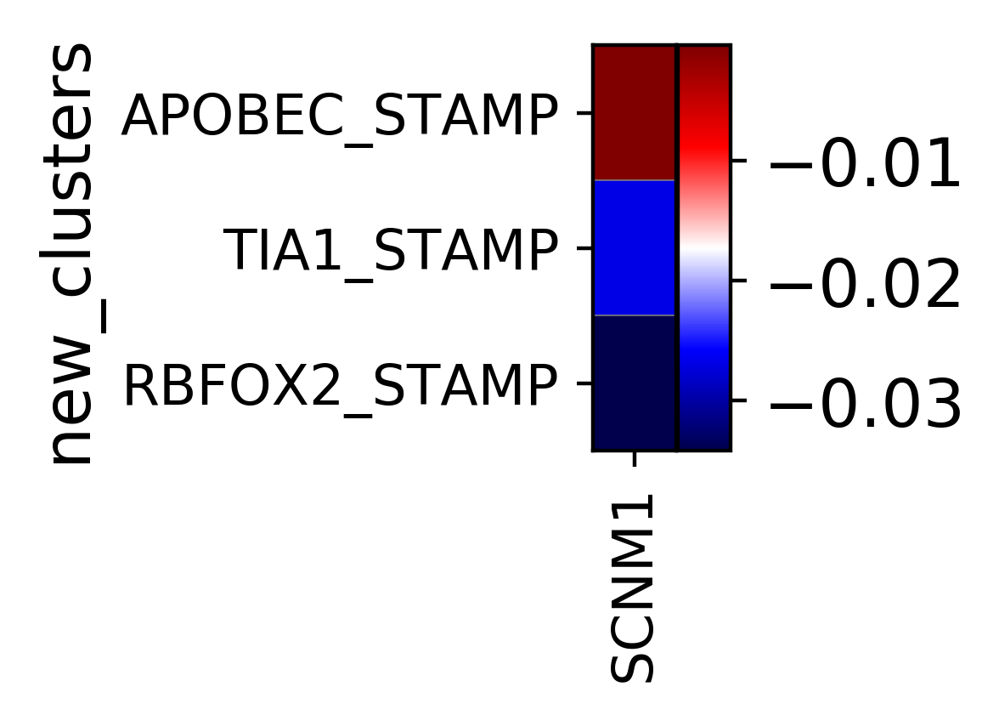

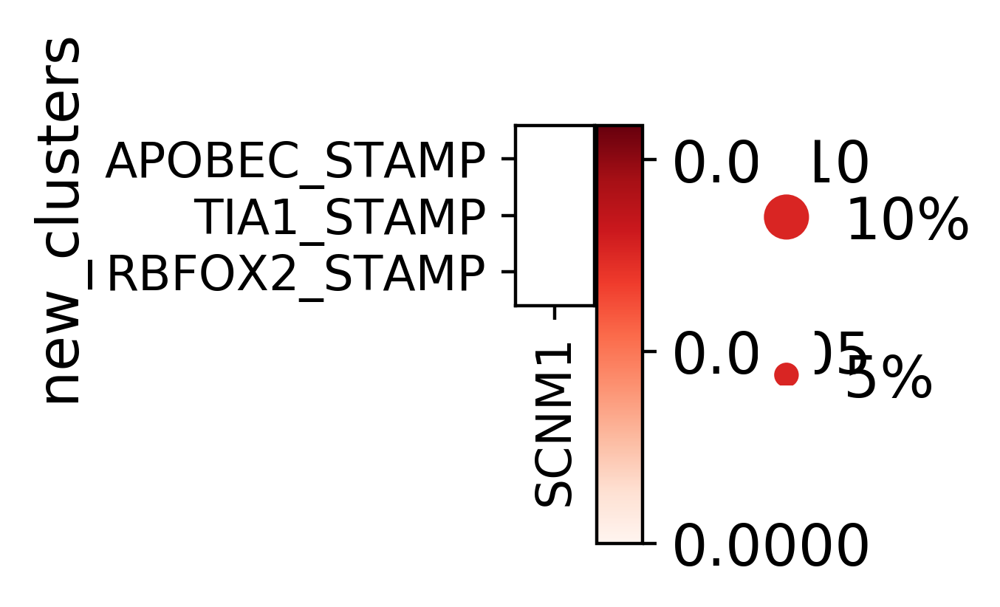

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[0.35, 0, 0.2, 0.5, 0.25])

In [391]:
GOI=['SCNM1']
sc.pl.matrixplot(adata,var_names=GOI,groupby='new_clusters', cmap='seismic',vmax=2)
sc.pl.matrixplot(adata,var_names=GOI,groupby='new_clusters', cmap='seismic')
sc.pl.matrixplot(adata,var_names=GOI,groupby='new_clusters', cmap='seismic',use_raw=False)
sc.pl.dotplot(adata,var_names=GOI,groupby='new_clusters')
#sc.pl.stacked_violin(adata_subset_more,var_names=GOI,groupby='new_clusters')

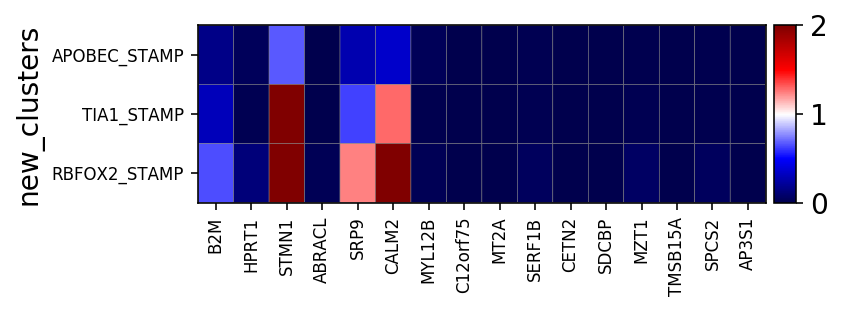

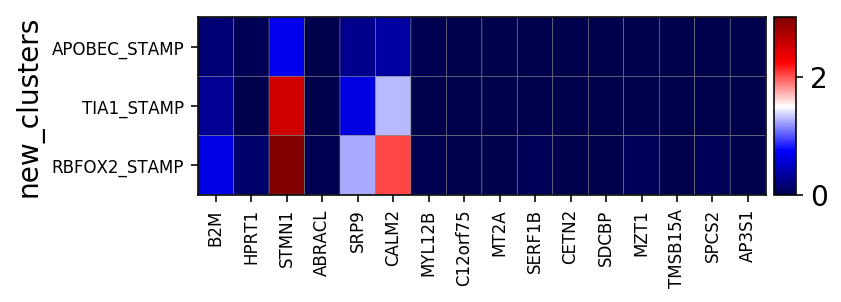

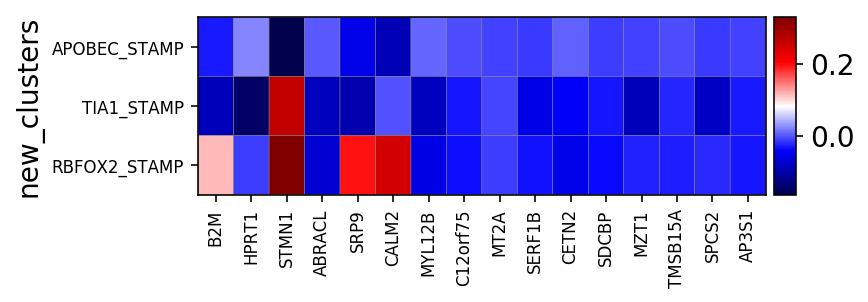

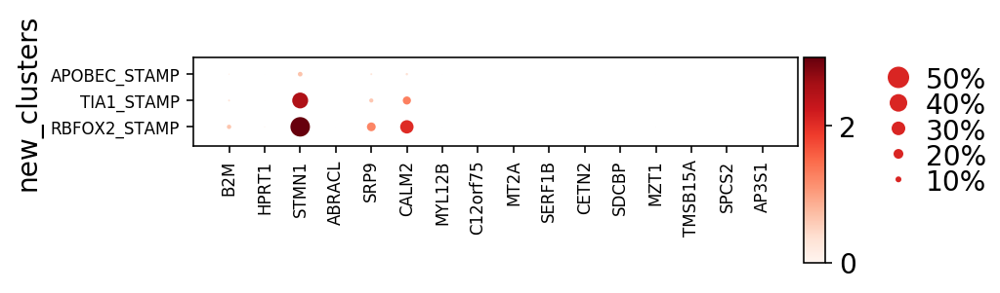

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[5.6, 0, 0.2, 0.5, 0.25])

In [341]:
GOI=['B2M','HPRT1','STMN1','ABRACL','SRP9','CALM2','MYL12B','C12orf75','MT2A','SERF1B','CETN2','SDCBP','MZT1','TMSB15A','SPCS2','AP3S1']
sc.pl.matrixplot(adata,var_names=GOI,groupby='new_clusters', cmap='seismic',vmax=2)
sc.pl.matrixplot(adata,var_names=GOI,groupby='new_clusters', cmap='seismic')
sc.pl.matrixplot(adata,var_names=GOI,groupby='new_clusters', cmap='seismic',use_raw=False)
sc.pl.dotplot(adata,var_names=GOI,groupby='new_clusters')
#sc.pl.stacked_violin(adata_subset_more,var_names=GOI,groupby='new_clusters')

In [366]:
bulk_TIA1.sort_values(by='edited_over_all_c', ascending=False).head(25)

,edit_coverage,editable_coverage,all_c_coverage,edited_over_edited_c,edited_over_all_c,genename
name,,,,,,
ENSG00000163273.3,10,30,245,0.333333,0.040816,NPPC
ENSG00000198695.2,33,33,1310,1.000000,0.025191,MT-ND6
ENSG00000221821.2,2,10,165,0.200000,0.012121,C6orf226
ENSGR0000002586.13,5,15,458,0.333333,0.010917,CD99
ENSG00000197780.5,22,262,2148,0.083969,0.010242,TAF13
ENSG00000228532.2,5,100,523,0.050000,0.009560,RP1-241P17.4
ENSG00000147669.6,30,485,3411,0.061856,0.008795,POLR2K
ENSG00000136521.8,26,289,2978,0.089965,0.008731,NDUFB5
ENSG00000182774.6,18,221,2418,0.081448,0.007444,RPS17L


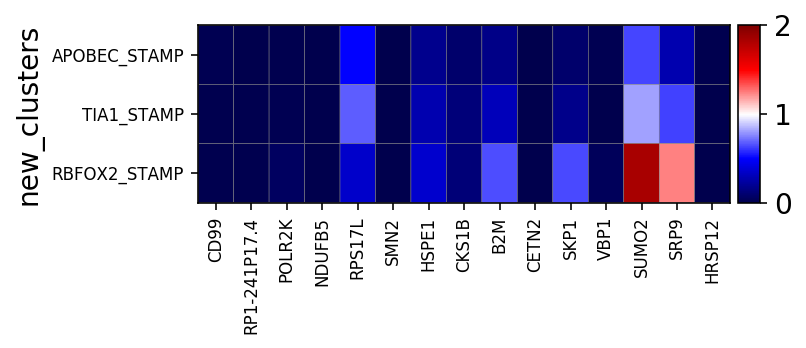

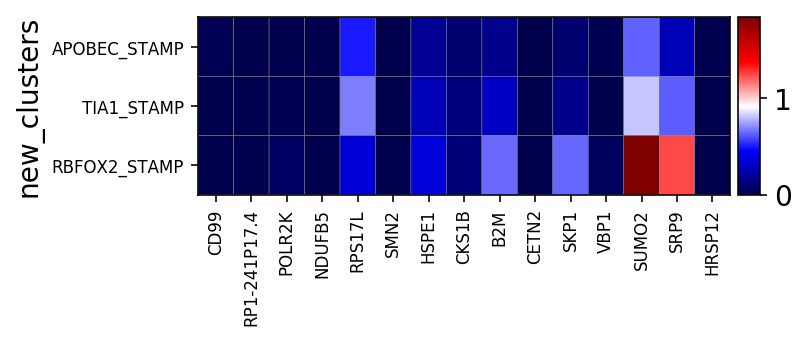

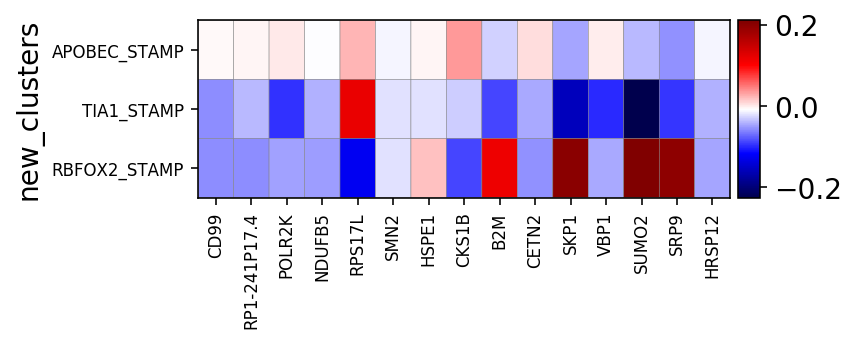

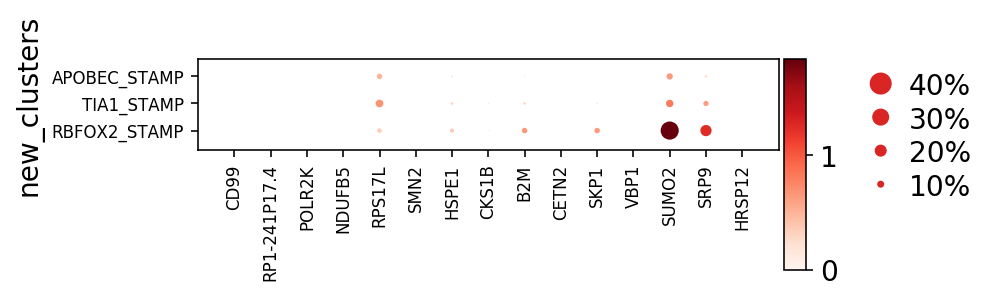

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[5.25, 0, 0.2, 0.5, 0.25])

In [371]:
GOI=['CD99','RP1-241P17.4','POLR2K','NDUFB5','RPS17L','SMN2','HSPE1','CKS1B','B2M','CETN2','SKP1','VBP1','SUMO2','SRP9','HRSP12']
sc.pl.matrixplot(adata,var_names=GOI,groupby='new_clusters', cmap='seismic',vmax=2)
sc.pl.matrixplot(adata,var_names=GOI,groupby='new_clusters', cmap='seismic')
sc.pl.matrixplot(adata,var_names=GOI,groupby='new_clusters', cmap='seismic',use_raw=False)
sc.pl.dotplot(adata,var_names=GOI,groupby='new_clusters')
#sc.pl.stacked_violin(adata_subset_more,var_names=GOI,groupby='new_clusters')

In [393]:
print(bulk_TIA1[bulk_TIA1['genename']=='BTF3'])
print(bulk_RBFOX2[bulk_RBFOX2['genename']=='BTF3'])
print(bulk_APO[bulk_APO['genename']=='BTF3'])

                    edit_coverage  editable_coverage  all_c_coverage  \
name                                                                   
ENSG00000145741.11              8                181            8108   

                    edited_over_edited_c  edited_over_all_c genename  
name                                                                  
ENSG00000145741.11              0.044199           0.000987     BTF3  
                    edit_coverage  editable_coverage  all_c_coverage  \
name                                                                   
ENSG00000145741.11              2                 82            7266   

                    edited_over_edited_c  edited_over_all_c genename  
name                                                                  
ENSG00000145741.11               0.02439           0.000275     BTF3  
                    edit_coverage  editable_coverage  all_c_coverage  \
name                                                                

# finding indeces don't overlap with APOBEC control #

In [222]:
adata_test=adata.obs
df = pd.DataFrame()
cols = list()
for i in set(adata_test['louvain_r0.2'].astype(str)):
    temp=adata_test[adata_test['louvain_r0.2']==str(i)]['batch'].value_counts()
    df = pd.concat((df,temp),axis=1)
    cols.append(i)
df.columns = cols
df

,0,1
Apo-Edits,8088,29
RBFOX_TIA-Edits,7024,7443


In [223]:
#by sample
for i in df.index:
    df.loc[i] = df.loc[i].div(df.loc[i].sum())
by_sample=df
by_sample

,0,1
Apo-Edits,0.996427,0.003573
RBFOX_TIA-Edits,0.485519,0.514481


In [224]:
# by cluster
df = pd.DataFrame()
cols = list()
for i in set(adata_test['louvain_r0.2'].astype(str)):
    temp=adata_test[adata_test['louvain_r0.2']==str(i)]['batch'].value_counts()
    df = pd.concat((df,temp),axis=1)
    cols.append(i)
df.columns = cols

for i in df:
    df[i] = df[i].div(df[i].sum())
by_cluster=df
by_cluster

,0,1
Apo-Edits,0.535204,0.003881
RBFOX_TIA-Edits,0.464796,0.996119


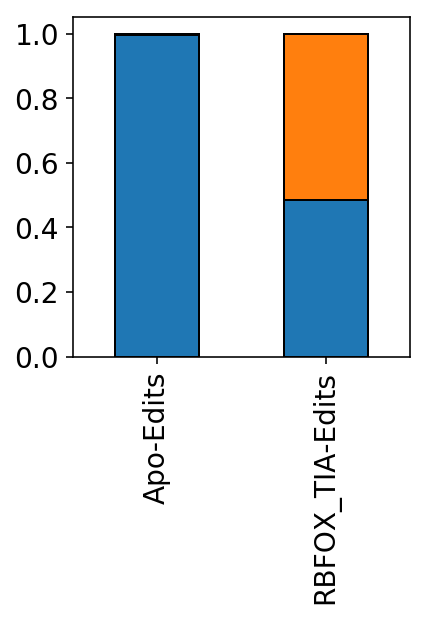

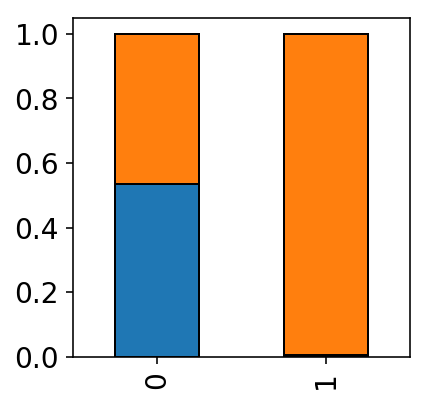

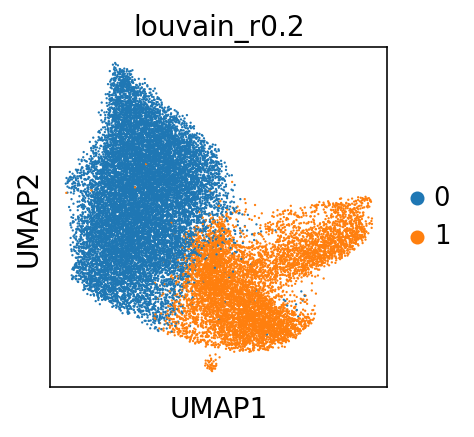

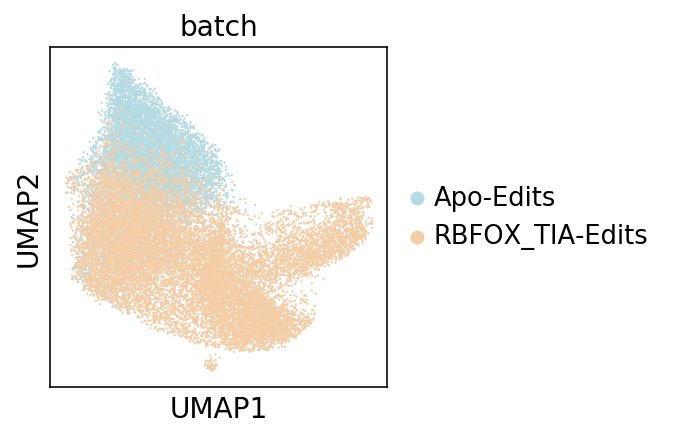

In [225]:
by_sample.plot.bar(stacked=True, legend=False, grid=False, edgecolor='black')
by_cluster.transpose().plot.bar(stacked=True, legend=False, grid=False, edgecolor='black')
sc.pl.umap(adata, color=['louvain_r0.2'])
sc.pl.umap(adata, color=['batch'])

In [226]:
# need 1

In [227]:
array1 = ['1']
array2 = ['RBFOX_TIA-Edits']
subset=adata.obs[['batch','louvain_r0.2']]
subset=subset.loc[subset['louvain_r0.2'].isin(array1)]
subset=subset.loc[subset['batch'].isin(array2)]
subset

,batch,louvain_r0.2
index,,
possorted_genome_bam_MD-AAACCCAAGAGCCCAA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,1
possorted_genome_bam_MD-AAACCCAAGTGCTACT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,1
possorted_genome_bam_MD-AAACCCACAGGAAGTC-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,1
possorted_genome_bam_MD-AAACCCACATCTATCT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,1
possorted_genome_bam_MD-AAACCCACATCTCAAG-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,1
...,...,...
possorted_genome_bam_MD-TTTGTTGGTATTCCGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,1
possorted_genome_bam_MD-TTTGTTGGTTGGAGGT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,1
possorted_genome_bam_MD-TTTGTTGTCCTATGGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,1


In [137]:
subset.to_csv('./results/RBFOX2-TIA1_non_APO_edits_barcodes.csv')

In [55]:
barcodes=subset.index.values.tolist()

In [56]:
adata_subset=adata_backup[barcodes].copy()

In [57]:
adata_subset

AnnData object with n_obs × n_vars = 7443 × 1964 
    obs: 'batch', 'n_edits', 'n_genes'
    var: 'n_cells-Apo-Edits', 'n_cells-RBFOX_TIA-Edits'
    uns: 'batch_colors'

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


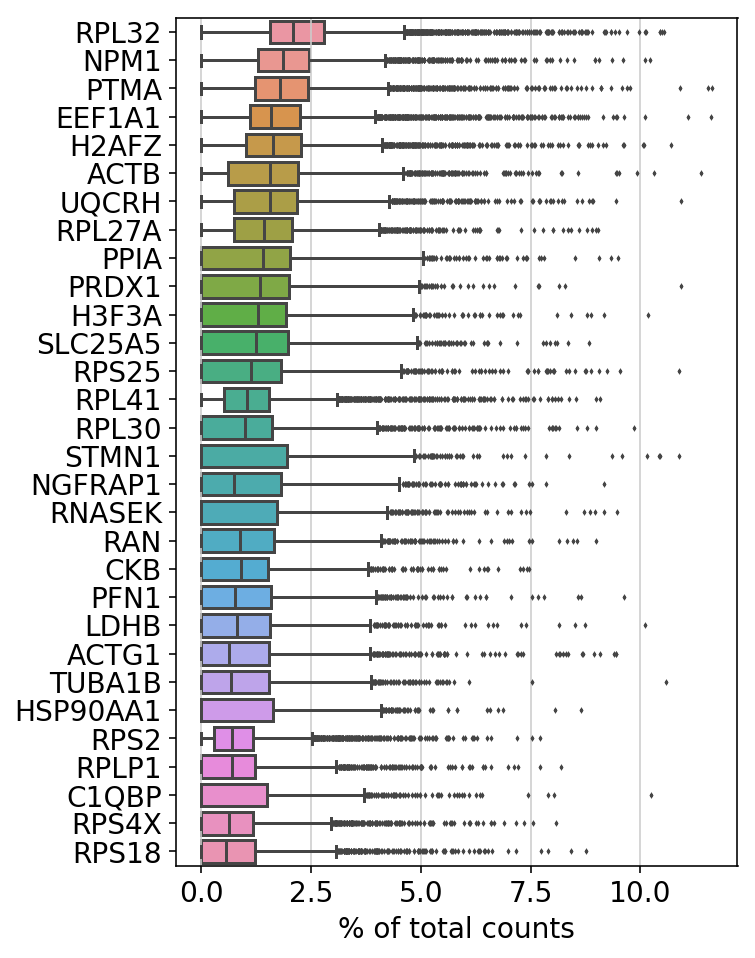

In [58]:
sc.pl.highest_expr_genes(adata_subset, n_top=30)

In [59]:
print(np.any(adata_subset.X.sum(axis=0) == 0))
print(np.any(adata_subset.X.sum(axis=1) == 0))

True
False


In [60]:
adata_subset = adata_subset[:,adata_subset.X.sum(axis=0) > 0].copy()

In [61]:
adata_subset

AnnData object with n_obs × n_vars = 7443 × 1465 
    obs: 'batch', 'n_edits', 'n_genes'
    var: 'n_cells-Apo-Edits', 'n_cells-RBFOX_TIA-Edits'
    uns: 'batch_colors'

In [62]:
sc.pp.regress_out(adata_subset, ['n_edits'])

regressing out ['n_edits']
    finished (0:00:08)


In [63]:
sc.pp.scale(adata_subset, max_value=10)

# Cluster with louvain

In [64]:
sc.tl.pca(adata_subset, svd_solver='arpack')

computing PCA with n_comps = 50
    finished (0:00:01)


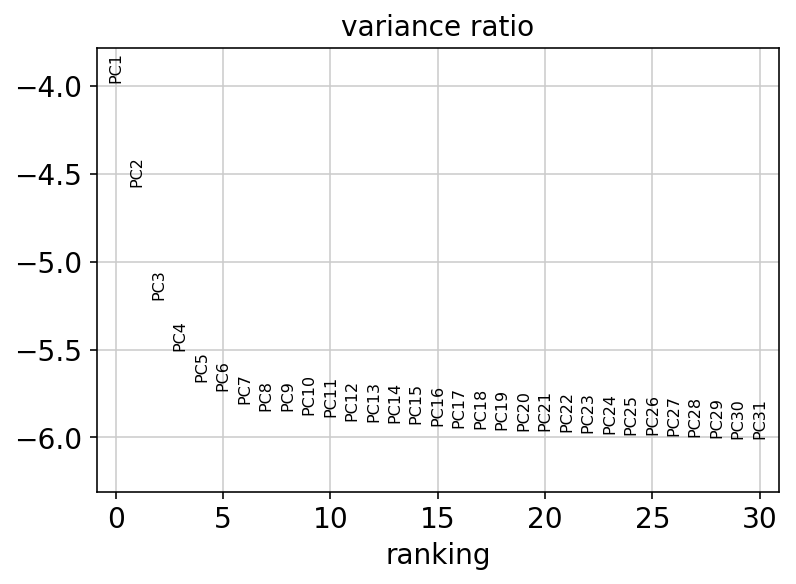

In [65]:
sc.pl.pca_variance_ratio(adata_subset, log=True)

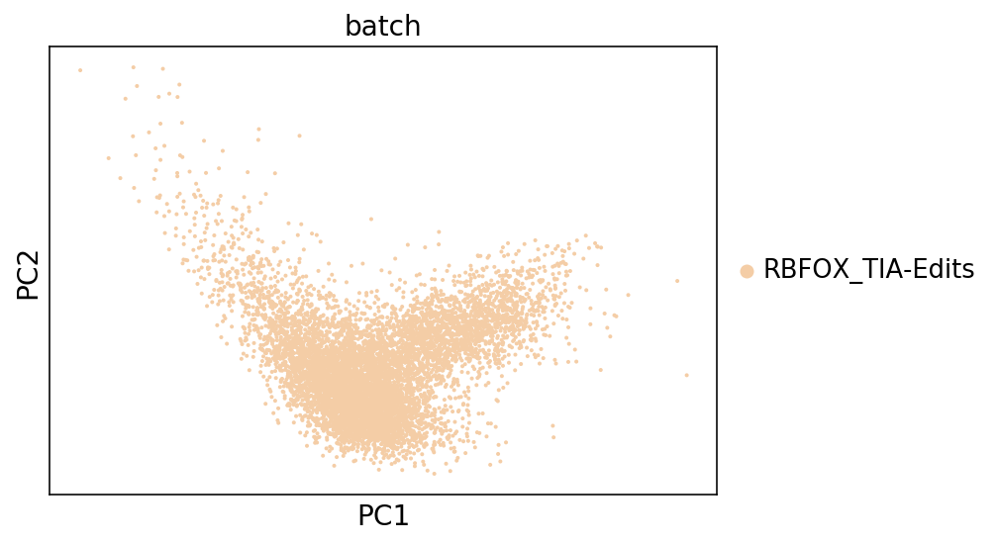

In [66]:
sc.pl.pca(adata_subset, color='batch')

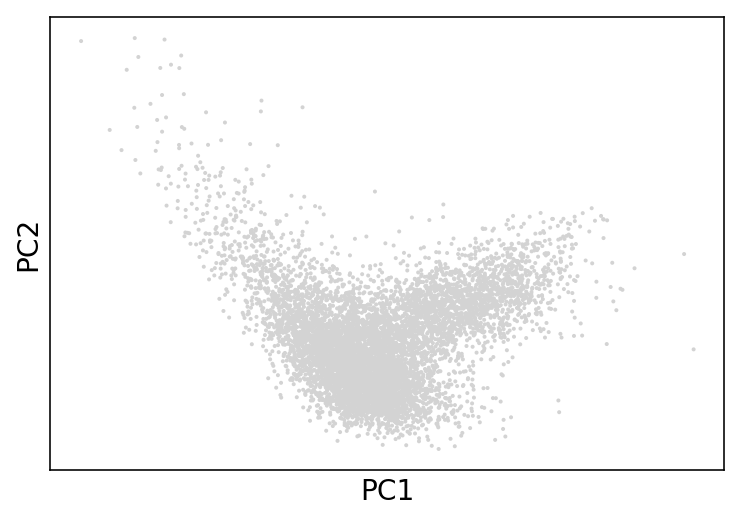

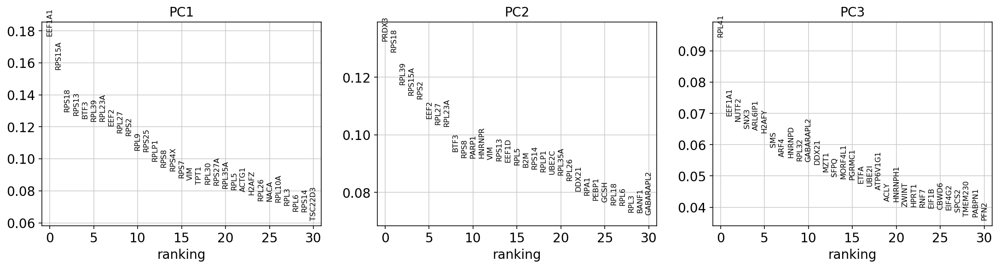

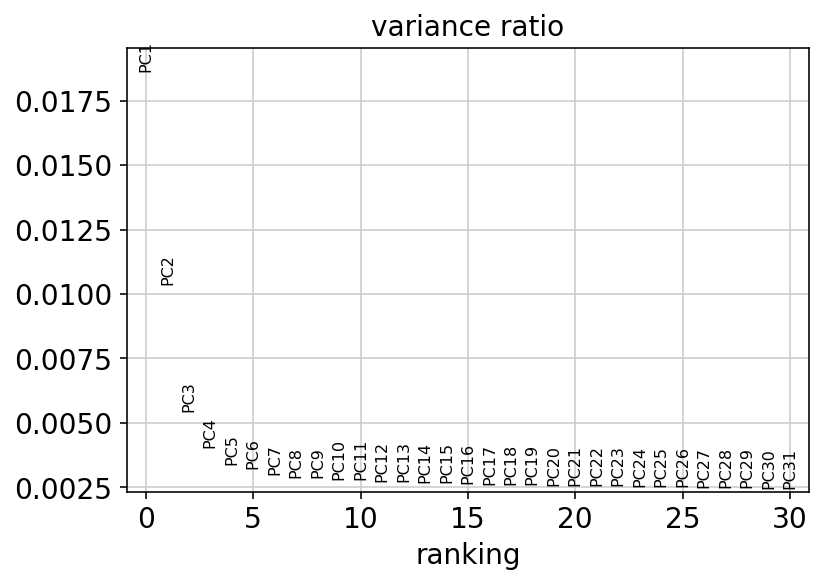

In [67]:
sc.pl.pca_overview(adata_subset)

In [68]:
sc.pp.neighbors(adata_subset, n_neighbors=10, n_pcs=40)

computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:07)


In [69]:
sc.tl.umap(adata_subset)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:20)


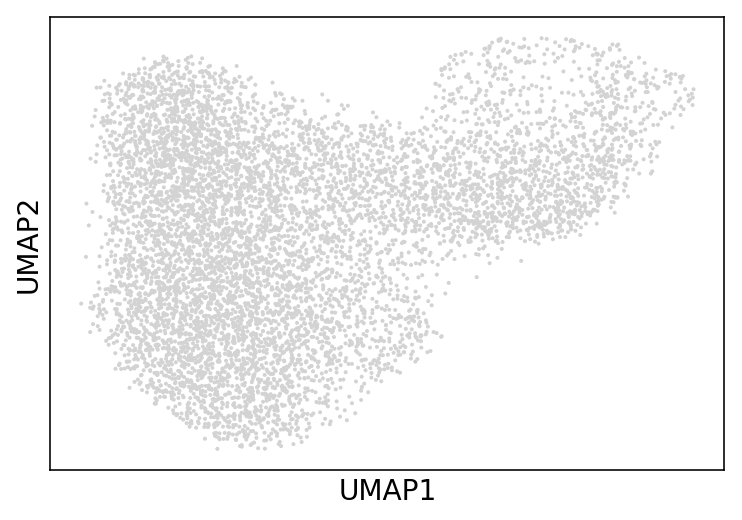

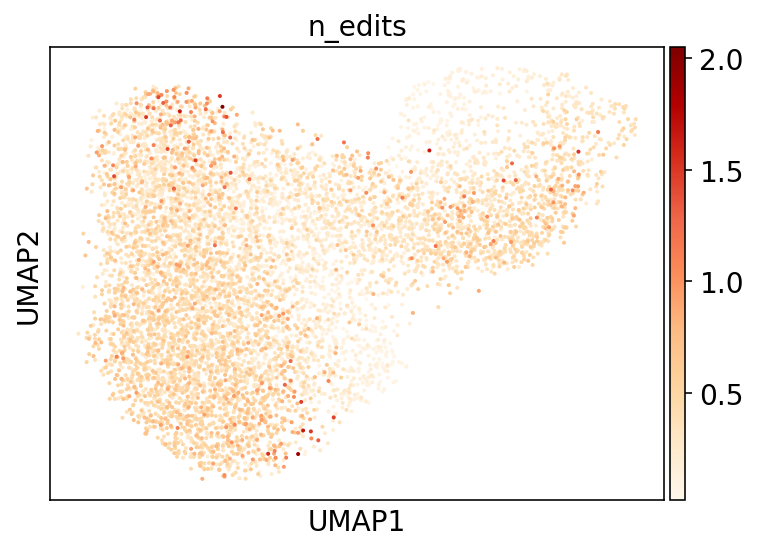

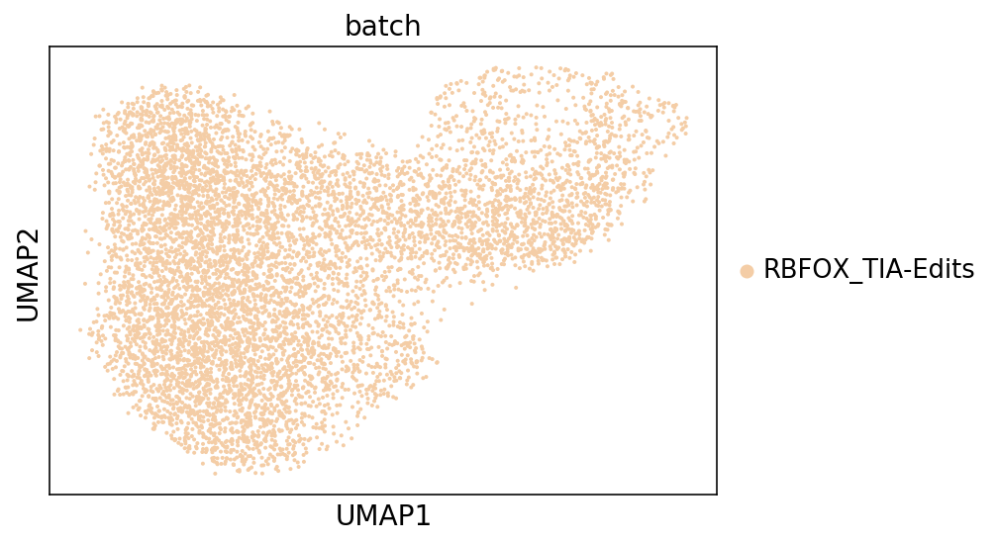

In [70]:
sc.pl.umap(adata_subset)
sc.pl.umap(adata_subset, color='n_edits', cmap='OrRd')
sc.pl.umap(adata_subset, color='batch')

In [71]:
adata_subset.obs['batch'].value_counts()

RBFOX_TIA-Edits    7443
Name: batch, dtype: int64

In [72]:
sc.tl.louvain(adata_subset)
sc.tl.louvain(adata_subset, resolution=0.95, key_added='louvain_r0_95')
sc.tl.louvain(adata_subset, resolution=0.7, key_added='louvain_r0_7')
sc.tl.louvain(adata_subset, resolution=0.5, key_added='louvain_r0_5')
sc.tl.louvain(adata_subset, resolution=0.3, key_added='louvain_r0_3')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 6 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 6 clusters and added
    'louvain_r0_95', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 5 clusters and added
    'louvain_r0_7', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 4 clusters and added
    'louvain_r0_5', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 2 clusters and added
    'louvain_r0_3', the cluster labels (adata.obs, categorical) (0:00:00)


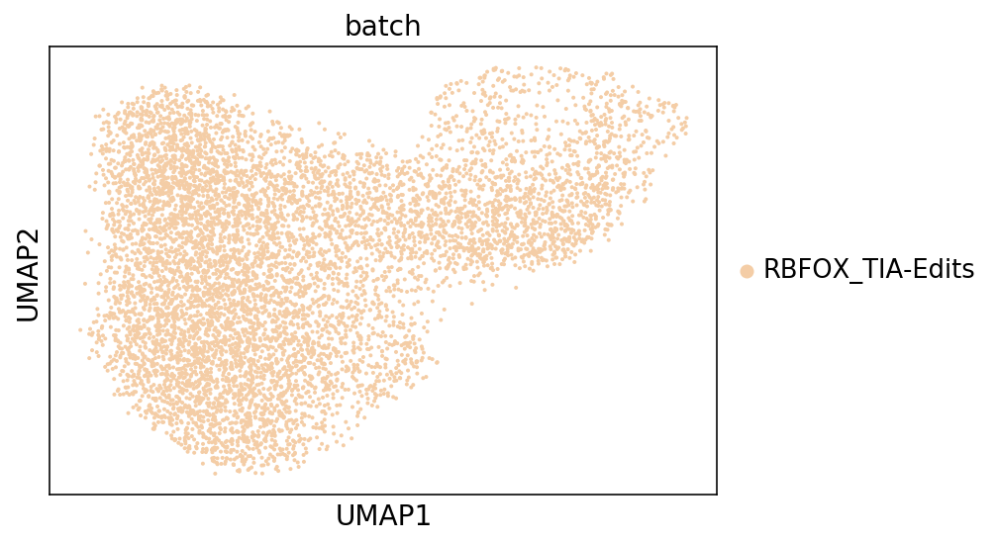

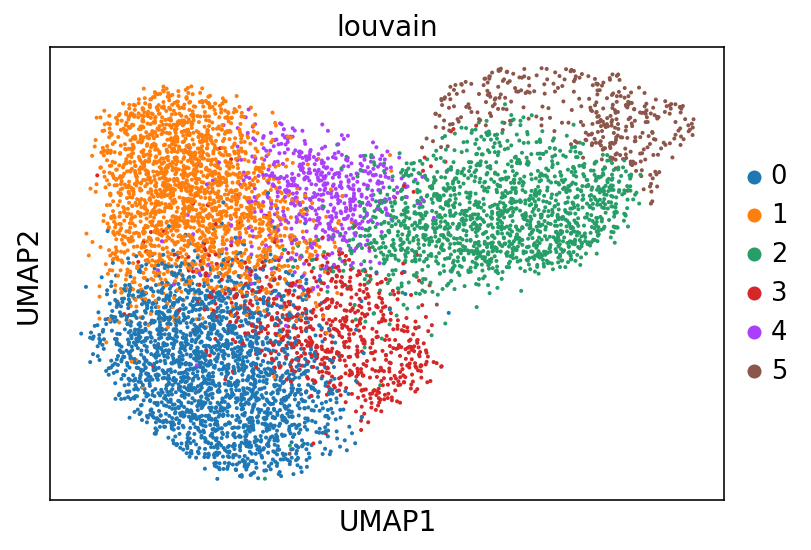

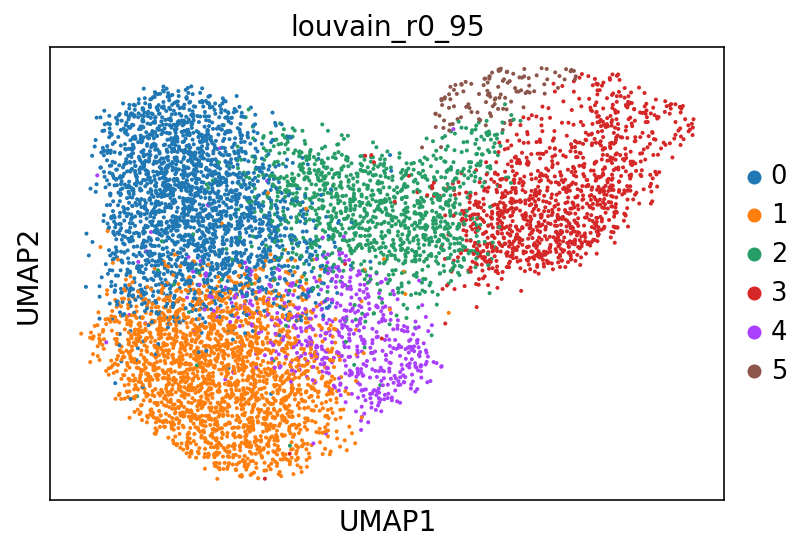

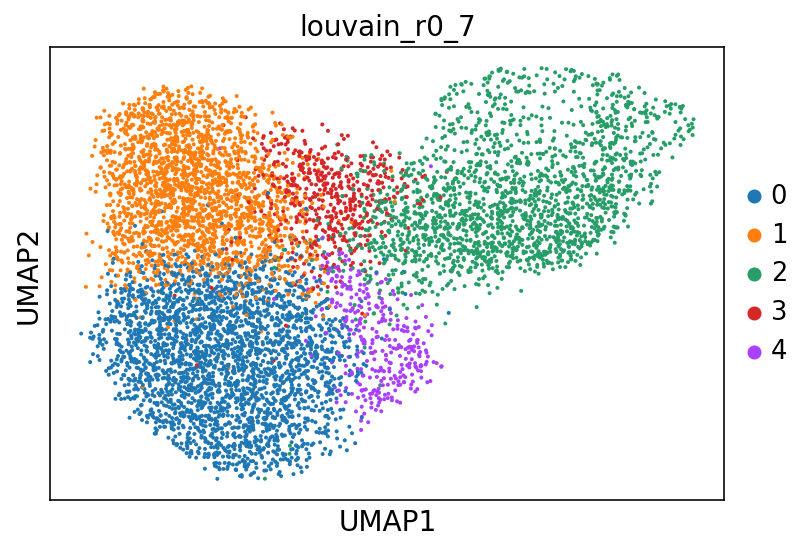

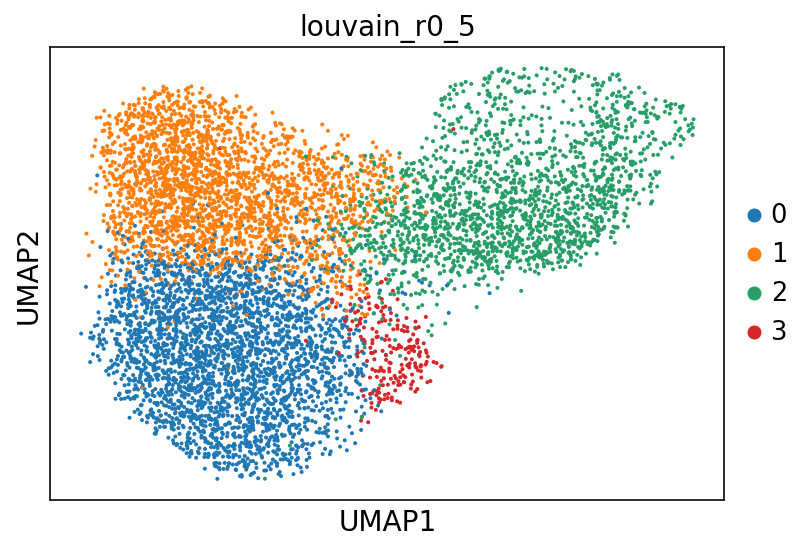

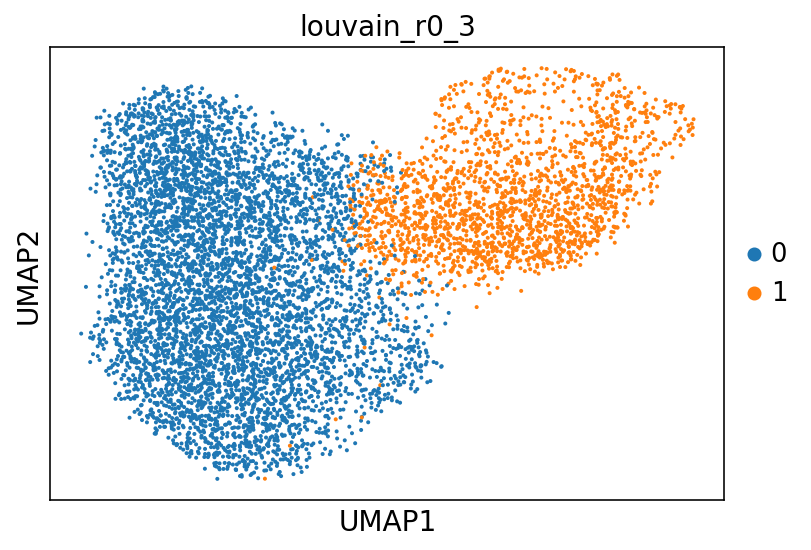

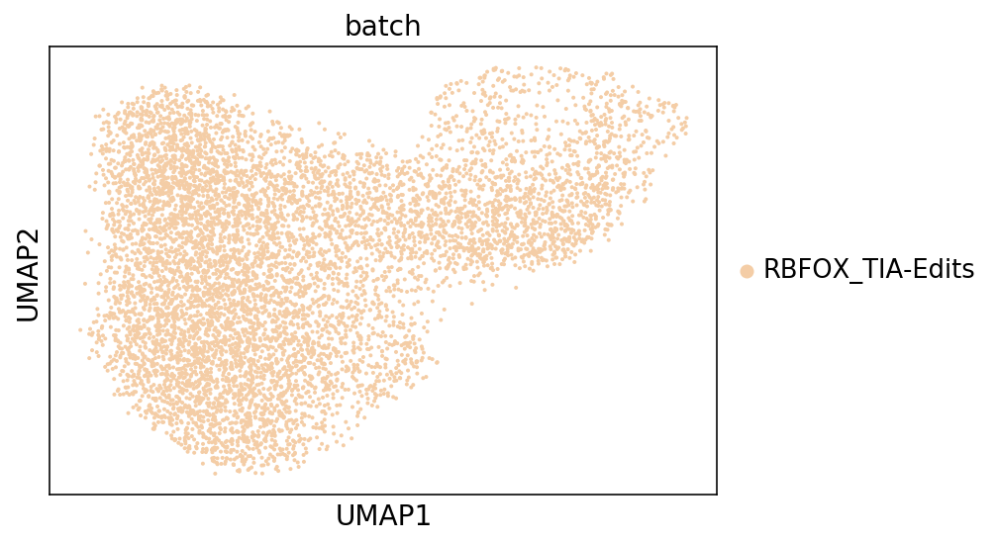

In [73]:
sc.pl.umap(adata_subset, color=['batch'])
sc.pl.umap(adata_subset, color=['louvain'])
sc.pl.umap(adata_subset, color=['louvain_r0_95'])
sc.pl.umap(adata_subset, color=['louvain_r0_7'])
sc.pl.umap(adata_subset, color=['louvain_r0_5'])
sc.pl.umap(adata_subset, color=['louvain_r0_3'])
sc.pl.umap(adata_subset, color=['batch'])

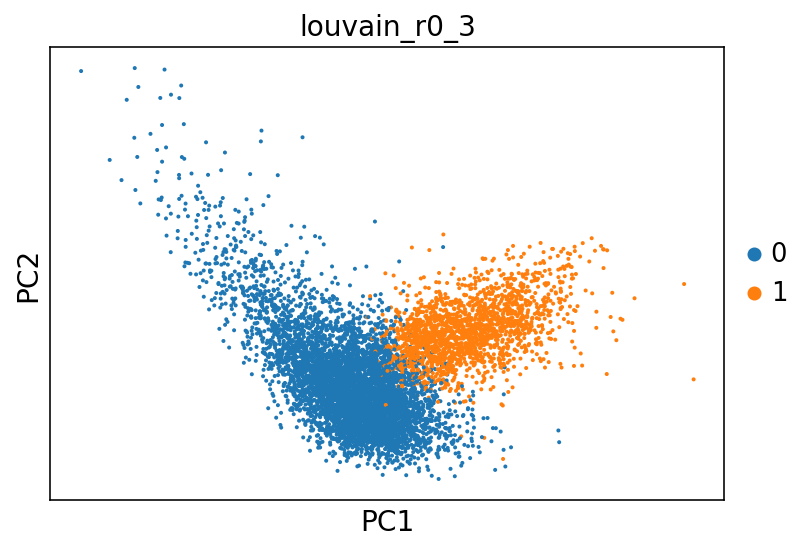

In [74]:
sc.pl.pca(adata_subset, color=['louvain_r0_3'])

In [75]:
sc.tl.rank_genes_groups(adata_subset, 'louvain_r0_3', method='wilcoxon',n_genes=100)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


In [76]:
adata

AnnData object with n_obs × n_vars = 22584 × 1964 
    obs: 'batch', 'n_edits', 'n_genes', 'X_umap', 'Y_umap', 'X_pca', 'Y_pca', 'feature', 'RBFOX2_ORF', 'TIA1_ORF', 'louvain_r3', 'louvain_r2', 'louvain_r15', 'louvain_r12', 'louvain', 'louvain_r0.5', 'louvain_r0.2'
    var: 'n_cells-Apo-Edits', 'n_cells-RBFOX_TIA-Edits'
    uns: 'batch_colors', 'feature_colors', 'louvain', 'louvain_colors', 'louvain_r0.2_colors', 'louvain_r0.5_colors', 'louvain_r12_colors', 'louvain_r15_colors', 'louvain_r2_colors', 'louvain_r3_colors', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_louvain_r0_3']`


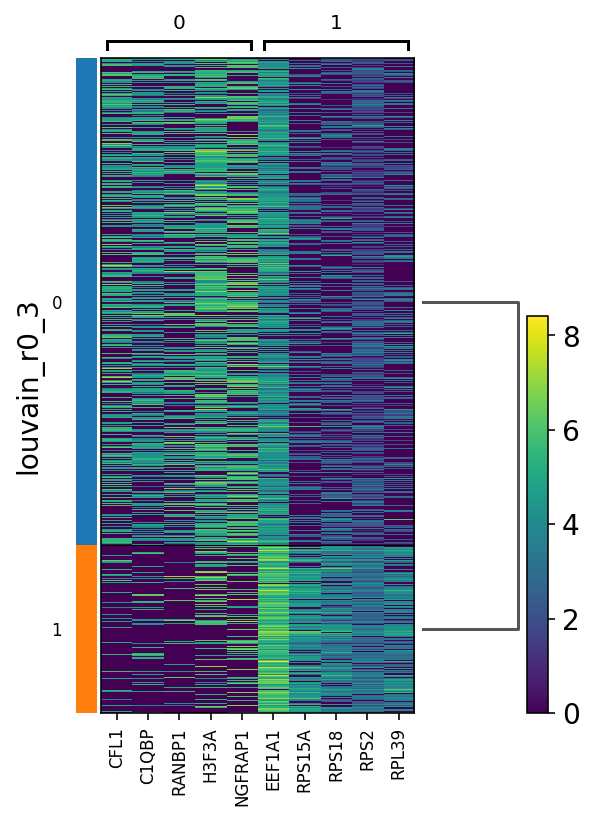

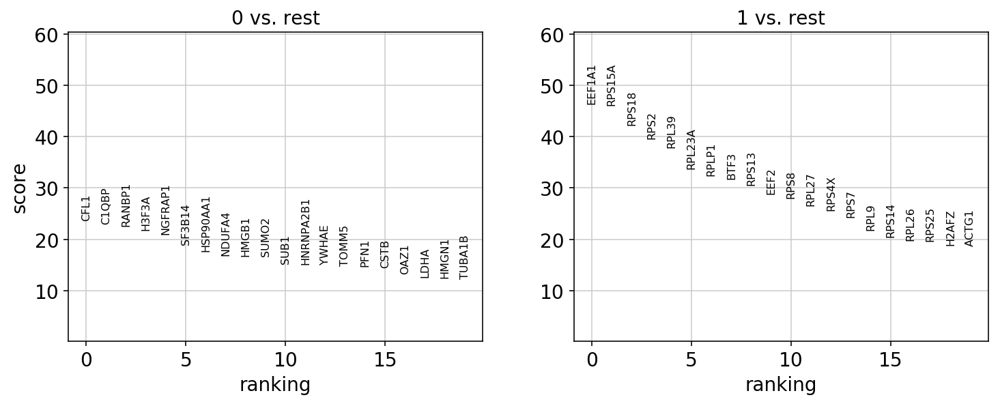

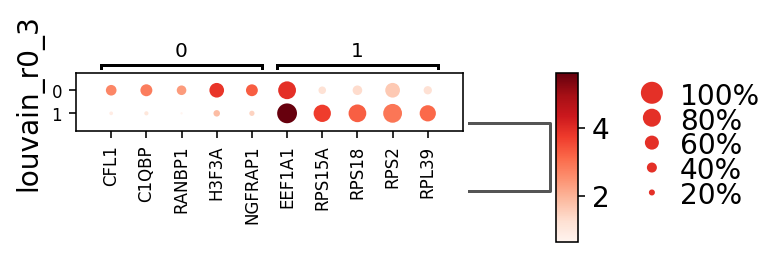

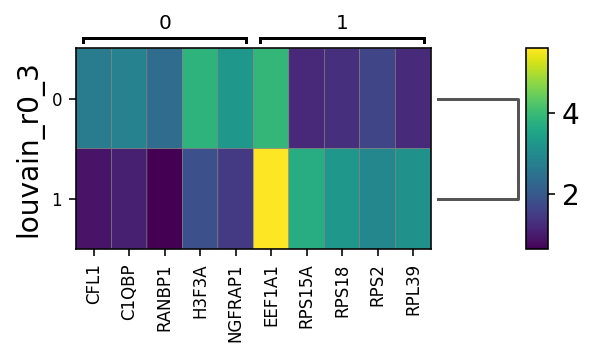

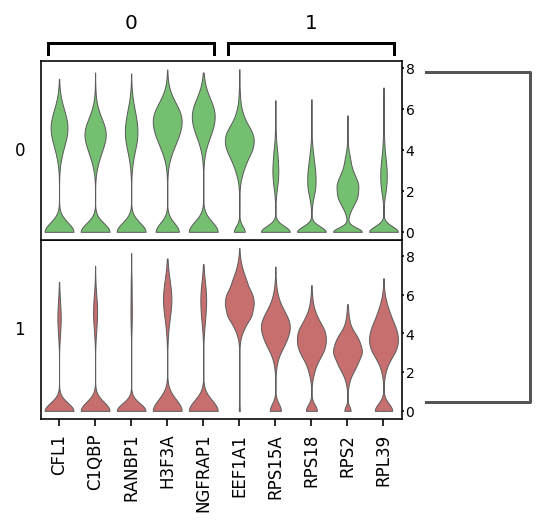

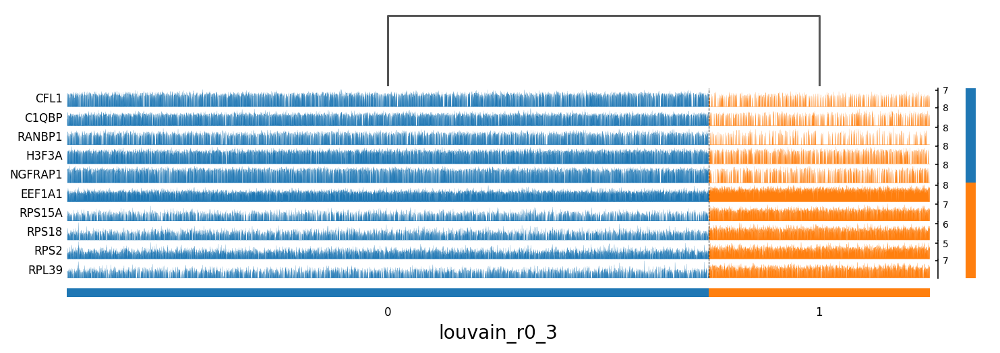

In [77]:
sc.pl.rank_genes_groups_heatmap(adata_subset,key='rank_genes_groups',n_genes=5,cmap='viridis')
sc.pl.rank_genes_groups(adata_subset, n_genes=20)
sc.pl.rank_genes_groups_dotplot(adata_subset,key='rank_genes_groups',n_genes=5)
sc.pl.rank_genes_groups_matrixplot(adata_subset,key='rank_genes_groups',n_genes=5)
sc.pl.rank_genes_groups_stacked_violin(adata_subset,key='rank_genes_groups',n_genes=5)
#sc.pl.rank_genes_groups_violin(adata_subset,key='rank_genes_groups',n_genes=5)
sc.pl.rank_genes_groups_tracksplot(adata_subset,key='rank_genes_groups',n_genes=5)

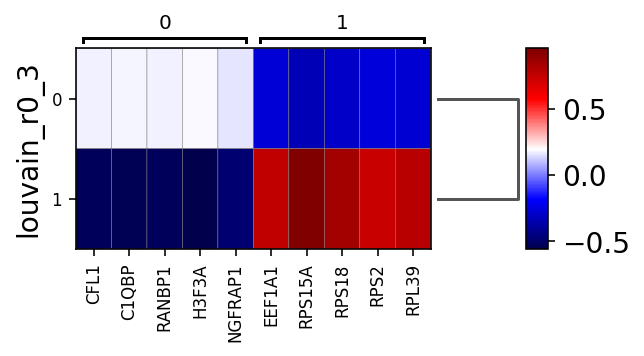

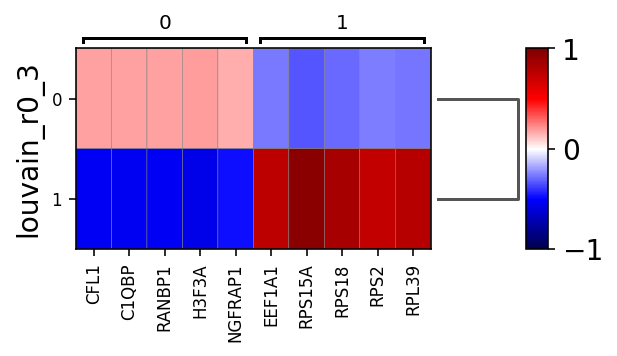

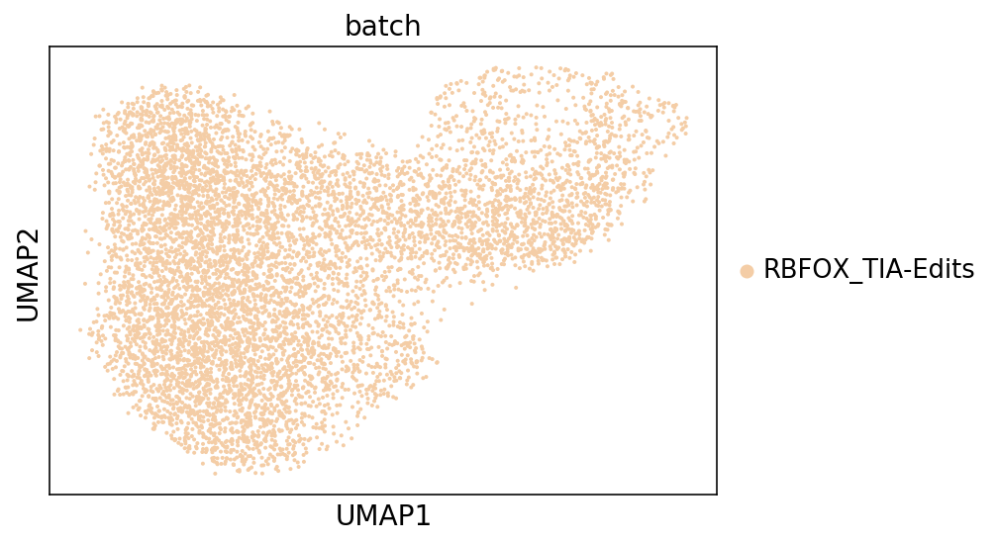

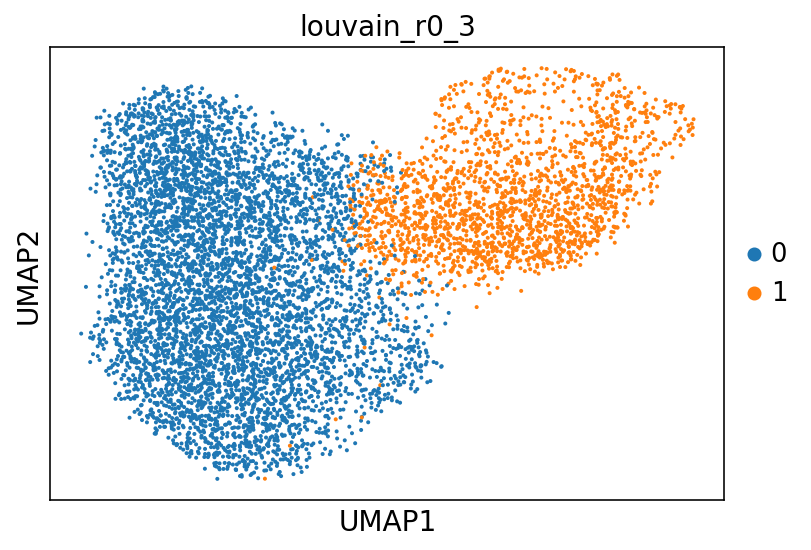

In [78]:
sc.pl.rank_genes_groups_matrixplot(adata_subset,key='rank_genes_groups',n_genes=5,
                                   cmap='seismic', use_raw=False)
sc.pl.rank_genes_groups_matrixplot(adata_subset,key='rank_genes_groups',n_genes=5,
                                   cmap='seismic', use_raw=False, vmin=-1, vmax=1)
sc.pl.umap(adata_subset, color=['batch'])
sc.pl.umap(adata_subset, color=['louvain_r0_3'])

In [79]:
result = adata_subset.uns['rank_genes_groups']
groups = result['names'].dtype.names
result=pd.DataFrame(
    {group + '_' + key[:]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges','pvals','pvals_adj']})
result.head(50)

,0_names,0_logfoldchanges,0_pvals,0_pvals_adj,1_names,1_logfoldchanges,1_pvals,1_pvals_adj
0,CFL1,3.233450,5.482386e-124,7.181926e-122,EEF1A1,2.456202,0.000000e+00,0.000000e+00
1,C1QBP,3.043823,1.494876e-117,1.835895e-115,RPS15A,4.126709,0.000000e+00,0.000000e+00
2,RANBP1,3.456808,1.234850e-113,1.427342e-111,RPS18,3.177963,0.000000e+00,0.000000e+00
3,H3F3A,3.090115,4.143782e-106,4.523628e-104,RPS2,2.068995,0.000000e+00,0.000000e+00
4,NGFRAP1,2.944851,1.272142e-98,1.249880e-96,RPL39,3.185190,0.000000e+00,0.000000e+00
5,SF3B14,3.869480,1.290564e-80,1.056649e-78,RPL23A,3.462082,3.347841e-249,1.096418e-246
6,HSP90AA1,2.485824,1.143126e-69,7.487474e-68,RPLP1,1.953100,1.892184e-230,5.311630e-228
7,NDUFA4,3.605218,4.057552e-64,2.491590e-62,BTF3,4.562341,2.911097e-222,7.150383e-220
8,HMGB1,2.330180,1.666824e-63,9.925177e-62,RPS13,3.226745,1.234875e-205,2.696144e-203
9,SUMO2,3.017429,2.409190e-63,1.392370e-61,EEF2,4.022419,5.968018e-183,1.172715e-180


In [80]:
#result.to_csv('./results/Triple_merge_louvain_edits.csv')

In [81]:
#adata_subset.var.to_csv(('./results/all_edited_genes.csv'))

In [82]:
edits_louvain_r0_5_by_barcode=adata_subset.obs[['louvain_r0_5']]
edits_louvain_r0_5_by_barcode=edits_louvain_r0_5_by_barcode.rename(columns={'louvain_r0_5':'edits_louvain_r0_5'})
#edits_louvain_r0_5_by_barcode.to_csv('./results/edits_louvain_r0_5_by_barcode.csv')
edits_louvain_r0_5_by_barcode

,edits_louvain_r0_5
possorted_genome_bam_MD-AAACCCAAGAGCCCAA-1-RBFOX_TIA-Edits,0
possorted_genome_bam_MD-AAACCCAAGTGCTACT-1-RBFOX_TIA-Edits,0
possorted_genome_bam_MD-AAACCCACAGGAAGTC-1-RBFOX_TIA-Edits,2
possorted_genome_bam_MD-AAACCCACATCTATCT-1-RBFOX_TIA-Edits,1
possorted_genome_bam_MD-AAACCCACATCTCAAG-1-RBFOX_TIA-Edits,0
...,...
possorted_genome_bam_MD-TTTGTTGGTATTCCGA-1-RBFOX_TIA-Edits,0
possorted_genome_bam_MD-TTTGTTGGTTGGAGGT-1-RBFOX_TIA-Edits,3
possorted_genome_bam_MD-TTTGTTGTCCTATGGA-1-RBFOX_TIA-Edits,1
possorted_genome_bam_MD-TTTGTTGTCCTTCTGG-1-RBFOX_TIA-Edits,1


# grabbing TIA and RBFOX barcodes from read1_feature_FB_R1_TrimTo10 #

In [83]:
adata_subset.obs

,batch,n_edits,n_genes,louvain,louvain_r0_95,louvain_r0_7,louvain_r0_5,louvain_r0_3
possorted_genome_bam_MD-AAACCCAAGAGCCCAA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.716930,127,0,1,0,0,0
possorted_genome_bam_MD-AAACCCAAGTGCTACT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.229328,53,0,0,0,0,0
possorted_genome_bam_MD-AAACCCACAGGAAGTC-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.123363,26,2,2,2,2,0
possorted_genome_bam_MD-AAACCCACATCTATCT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.408665,78,1,0,1,1,0
possorted_genome_bam_MD-AAACCCACATCTCAAG-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.147199,43,0,1,0,0,0
...,...,...,...,...,...,...,...,...
possorted_genome_bam_MD-TTTGTTGGTATTCCGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.744350,97,0,1,0,0,0
possorted_genome_bam_MD-TTTGTTGGTTGGAGGT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.150118,21,3,4,4,3,0
possorted_genome_bam_MD-TTTGTTGTCCTATGGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.191077,53,4,2,3,1,0
possorted_genome_bam_MD-TTTGTTGTCCTTCTGG-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.165273,40,1,0,1,1,0


In [84]:
RBFOX_barcodes=pd.read_csv('./results/RBFOX2_ORF_matrix.csv',index_col=0)
RBFOX_barcodes

,RBFOX2_ORF
TGCGGGTGTGTTCCTC-1,2.190145
ACGGTTAAGTGGTTAA-1,2.075209
TCAGTGAGTGGGTATG-1,1.948830
GAAGCCCGTCAATGGG-1,1.734930
ATTCGTTTCGGTTCAA-1,1.696412
...,...
CCGGTAGGTGGCTTGC-1,0.000000
CCGGTAGGTTAGTCGT-1,0.000000
CCGGTAGTCGCTGCGA-1,0.000000
CCGGTAGTCTCCACTG-1,0.000000


In [85]:
TIA_barcodes=pd.read_csv('./results/TIA1_ORF_matrix.csv',index_col=0)
TIA_barcodes=TIA_barcodes.reset_index()
TIA_barcodes['index']='possorted_genome_bam_MD-'+TIA_barcodes['index'].astype(str)+'-RBFOX_TIA-Edits'
TIA_barcodes=TIA_barcodes.set_index('index', drop=True)
TIA_barcodes=TIA_barcodes[TIA_barcodes['TIA1_ORF']>0]
TIA_barcodes

,TIA1_ORF
index,
possorted_genome_bam_MD-GTGAGTTCAACAGATA-1-RBFOX_TIA-Edits,2.832962
possorted_genome_bam_MD-TCACATTCAAATGAAC-1-RBFOX_TIA-Edits,2.337002
possorted_genome_bam_MD-ATCGTGAGTCCATACA-1-RBFOX_TIA-Edits,2.181383
possorted_genome_bam_MD-CCTCCTCCATCGATGT-1-RBFOX_TIA-Edits,2.172716
possorted_genome_bam_MD-CGGAGAACAGCACAAG-1-RBFOX_TIA-Edits,2.155660
...,...
possorted_genome_bam_MD-GAAATGACAGTCAGTT-1-RBFOX_TIA-Edits,0.243992
possorted_genome_bam_MD-GATGACTAGGGAGTTC-1-RBFOX_TIA-Edits,0.240746
possorted_genome_bam_MD-AGGGTCCCATCAGTGT-1-RBFOX_TIA-Edits,0.234861


In [86]:
RBFOX_barcodes=pd.read_csv('./results/RBFOX2_ORF_matrix.csv',index_col=0)
RBFOX_barcodes=RBFOX_barcodes.reset_index()
RBFOX_barcodes['index']='possorted_genome_bam_MD-'+RBFOX_barcodes['index'].astype(str)+'-RBFOX_TIA-Edits'
RBFOX_barcodes=RBFOX_barcodes.set_index('index', drop=True)
RBFOX_barcodes=RBFOX_barcodes[RBFOX_barcodes['RBFOX2_ORF']>0]
RBFOX_barcodes

,RBFOX2_ORF
index,
possorted_genome_bam_MD-TGCGGGTGTGTTCCTC-1-RBFOX_TIA-Edits,2.190145
possorted_genome_bam_MD-ACGGTTAAGTGGTTAA-1-RBFOX_TIA-Edits,2.075209
possorted_genome_bam_MD-TCAGTGAGTGGGTATG-1-RBFOX_TIA-Edits,1.948830
possorted_genome_bam_MD-GAAGCCCGTCAATGGG-1-RBFOX_TIA-Edits,1.734930
possorted_genome_bam_MD-ATTCGTTTCGGTTCAA-1-RBFOX_TIA-Edits,1.696412
...,...
possorted_genome_bam_MD-TGCGGCATCACCTGGG-1-RBFOX_TIA-Edits,0.205525
possorted_genome_bam_MD-CATTCATAGAAGAGCA-1-RBFOX_TIA-Edits,0.201960
possorted_genome_bam_MD-CCCTTAGTCATGACAC-1-RBFOX_TIA-Edits,0.198398


In [87]:
RBFOX_list = list(RBFOX_barcodes.index)
TIA_list = list(TIA_barcodes.index)

In [88]:
df=adata_subset.obs
def in_list (row, r=RBFOX_list, t=TIA_list):
    if (row['index'] in r) and (row['index'] in t):
        return 'double pos.'
    if row['index'] in r :
        return 'RBFOX2_ORF'
    if row['index'] in t:
        return 'TIA1_ORF'

dx=df.reset_index()
dx['feature']=dx.apply(in_list, axis=1)
dx=dx.set_index('index', drop=True)
dx

,batch,n_edits,n_genes,louvain,louvain_r0_95,louvain_r0_7,louvain_r0_5,louvain_r0_3,feature
index,,,,,,,,,
possorted_genome_bam_MD-AAACCCAAGAGCCCAA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.716930,127,0,1,0,0,0,None
possorted_genome_bam_MD-AAACCCAAGTGCTACT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.229328,53,0,0,0,0,0,None
possorted_genome_bam_MD-AAACCCACAGGAAGTC-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.123363,26,2,2,2,2,0,None
possorted_genome_bam_MD-AAACCCACATCTATCT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.408665,78,1,0,1,1,0,None
possorted_genome_bam_MD-AAACCCACATCTCAAG-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.147199,43,0,1,0,0,0,None
...,...,...,...,...,...,...,...,...,...
possorted_genome_bam_MD-TTTGTTGGTATTCCGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.744350,97,0,1,0,0,0,RBFOX2_ORF
possorted_genome_bam_MD-TTTGTTGGTTGGAGGT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.150118,21,3,4,4,3,0,None
possorted_genome_bam_MD-TTTGTTGTCCTATGGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.191077,53,4,2,3,1,0,None


In [89]:
dx['feature'].value_counts()

RBFOX2_ORF     644
TIA1_ORF       446
double pos.      4
Name: feature, dtype: int64

In [90]:
adata_subset.obs=dx

In [91]:
adata_subset.uns['feature_colors']=['#D3D3D3', '#ff7f0e', '#279e68', '#d62728']

... storing 'feature' as categorical


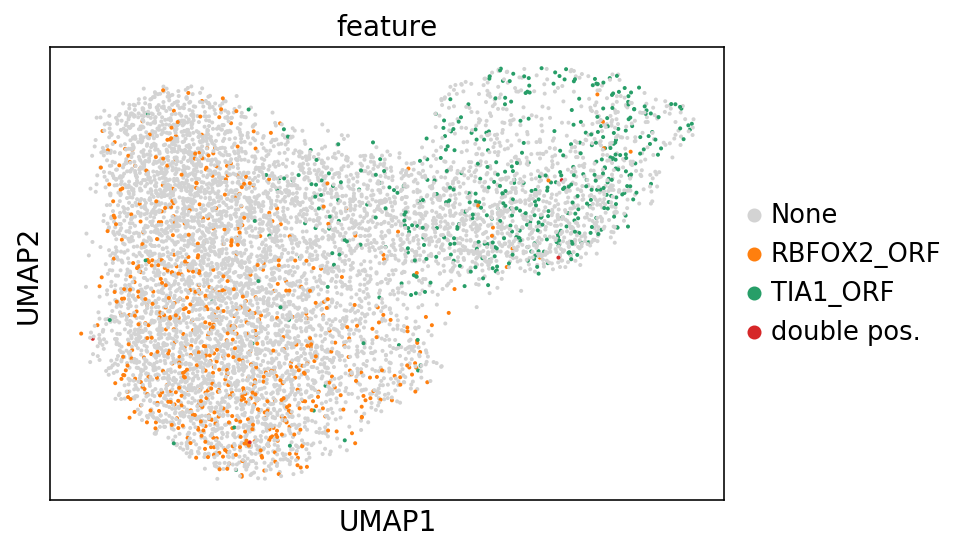

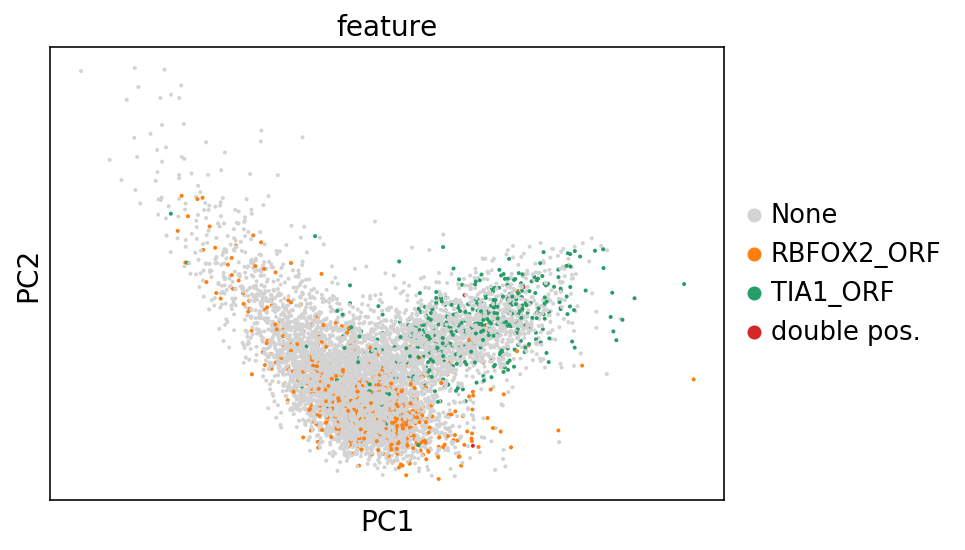

In [92]:
sc.pl.umap(adata_subset, color=['feature'])
sc.pl.pca(adata_subset, color='feature')

([], <a list of 0 Text yticklabel objects>)

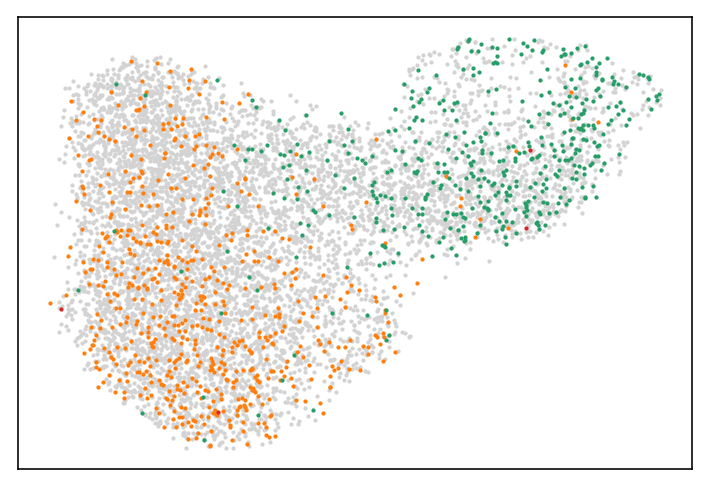

In [93]:
test=adata_subset.obs
test2=pd.DataFrame({'X_umap':adata_subset.obsm['X_umap'][:,0],'Y_umap':adata_subset.obsm['X_umap'][:,1]})
test3=pd.DataFrame({'X_pca':adata_subset.obsm['X_pca'][:,0],'Y_pca':adata_subset.obsm['X_pca'][:,1]})

test['X_umap']=test2['X_umap'].tolist()
test['Y_umap']=test2['Y_umap'].tolist()

test['X_pca']=test3['X_pca'].tolist()
test['Y_pca']=test3['Y_pca'].tolist()

colors_samples={'None':'#D3D3D3',
                'RBFOX2_ORF':'#ff7f0e',
                'TIA1_ORF':'#279e68',
                'double pos.':'#d62728'}

dot_size=5
color_combo=colors_samples
grouping='feature'

################################################

plt.scatter(x=test[test[grouping]=='None']['X_umap'],y=test[test[grouping]=='None']['Y_umap'],
            color=color_combo['None'],s=dot_size,marker='.')
plt.scatter(x=test[test[grouping]=='RBFOX2_ORF']['X_umap'],y=test[test[grouping]=='RBFOX2_ORF']['Y_umap'],
            color=color_combo['RBFOX2_ORF'],s=dot_size,marker='.')
plt.scatter(x=test[test[grouping]=='TIA1_ORF']['X_umap'],y=test[test[grouping]=='TIA1_ORF']['Y_umap'],
            color=color_combo['TIA1_ORF'],s=dot_size,marker='.')
plt.scatter(x=test[test[grouping]=='double pos.']['X_umap'],y=test[test[grouping]=='double pos.']['Y_umap'],
            color=color_combo['double pos.'],s=dot_size,marker='.')


################################################

plt.grid(False)
plt.xticks([])
plt.yticks([])

## feature by expression level ##

In [94]:
RBFOX_barcodes=pd.read_csv('./results/RBFOX2_ORF_matrix.csv',index_col=0)
RBFOX_barcodes=RBFOX_barcodes.reset_index()
RBFOX_barcodes['index']='possorted_genome_bam_MD-'+RBFOX_barcodes['index'].astype(str)+'-RBFOX_TIA-Edits'
RBFOX_barcodes=RBFOX_barcodes.set_index('index', drop=True)

In [95]:
df=adata_subset.obs
def in_list (row, l=RBFOX_barcodes):
    if (row['index'] in l.index):
        return l.loc[row['index'],'RBFOX2_ORF']
    else:
        return 0

dx=df.reset_index()
dx['RBFOX2_ORF']=dx.apply(in_list, axis=1)
dx=dx.set_index('index', drop=True)
dx

,batch,n_edits,n_genes,louvain,louvain_r0_95,louvain_r0_7,louvain_r0_5,louvain_r0_3,feature,X_umap,Y_umap,X_pca,Y_pca,RBFOX2_ORF
index,,,,,,,,,,,,,,
possorted_genome_bam_MD-AAACCCAAGAGCCCAA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.716930,127,0,1,0,0,0,None,1.155164,-4.476676,0.406649,-0.611336,0.00000
possorted_genome_bam_MD-AAACCCAAGTGCTACT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.229328,53,0,0,0,0,0,None,-0.153683,-2.338901,-2.078118,-2.170645,0.00000
possorted_genome_bam_MD-AAACCCACAGGAAGTC-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.123363,26,2,2,2,2,0,None,3.158205,-1.481819,-0.056972,1.002003,0.00000
possorted_genome_bam_MD-AAACCCACATCTATCT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.408665,78,1,0,1,1,0,None,0.873356,-0.840965,-2.655622,-0.145914,0.00000
possorted_genome_bam_MD-AAACCCACATCTCAAG-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.147199,43,0,1,0,0,0,None,1.242551,-2.445995,-0.413879,-0.699416,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
possorted_genome_bam_MD-TTTGTTGGTATTCCGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.744350,97,0,1,0,0,0,RBFOX2_ORF,2.582575,-5.766038,1.637971,-3.288701,0.47477
possorted_genome_bam_MD-TTTGTTGGTTGGAGGT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.150118,21,3,4,4,3,0,None,4.556952,-4.417829,-0.116691,-0.998877,0.00000
possorted_genome_bam_MD-TTTGTTGTCCTATGGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.191077,53,4,2,3,1,0,None,2.337718,0.639101,-0.843463,1.779338,0.00000


In [96]:
adata_subset.obs=dx

In [97]:
TIA_barcodes=pd.read_csv('./results/TIA1_ORF_matrix.csv',index_col=0)
TIA_barcodes=TIA_barcodes.reset_index()
TIA_barcodes['index']='possorted_genome_bam_MD-'+TIA_barcodes['index'].astype(str)+'-RBFOX_TIA-Edits'
TIA_barcodes=TIA_barcodes.set_index('index', drop=True)

In [98]:
df=adata_subset.obs
def in_list (row, l=TIA_barcodes):
    if (row['index'] in l.index):
        return l.loc[row['index'],'TIA1_ORF']
    else:
        return 0

dx=df.reset_index()
dx['TIA1_ORF']=dx.apply(in_list, axis=1)
dx=dx.set_index('index', drop=True)
dx

,batch,n_edits,n_genes,louvain,louvain_r0_95,louvain_r0_7,louvain_r0_5,louvain_r0_3,feature,X_umap,Y_umap,X_pca,Y_pca,RBFOX2_ORF,TIA1_ORF
index,,,,,,,,,,,,,,,
possorted_genome_bam_MD-AAACCCAAGAGCCCAA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.716930,127,0,1,0,0,0,None,1.155164,-4.476676,0.406649,-0.611336,0.00000,0.0
possorted_genome_bam_MD-AAACCCAAGTGCTACT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.229328,53,0,0,0,0,0,None,-0.153683,-2.338901,-2.078118,-2.170645,0.00000,0.0
possorted_genome_bam_MD-AAACCCACAGGAAGTC-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.123363,26,2,2,2,2,0,None,3.158205,-1.481819,-0.056972,1.002003,0.00000,0.0
possorted_genome_bam_MD-AAACCCACATCTATCT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.408665,78,1,0,1,1,0,None,0.873356,-0.840965,-2.655622,-0.145914,0.00000,0.0
possorted_genome_bam_MD-AAACCCACATCTCAAG-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.147199,43,0,1,0,0,0,None,1.242551,-2.445995,-0.413879,-0.699416,0.00000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
possorted_genome_bam_MD-TTTGTTGGTATTCCGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.744350,97,0,1,0,0,0,RBFOX2_ORF,2.582575,-5.766038,1.637971,-3.288701,0.47477,0.0
possorted_genome_bam_MD-TTTGTTGGTTGGAGGT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.150118,21,3,4,4,3,0,None,4.556952,-4.417829,-0.116691,-0.998877,0.00000,0.0
possorted_genome_bam_MD-TTTGTTGTCCTATGGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.191077,53,4,2,3,1,0,None,2.337718,0.639101,-0.843463,1.779338,0.00000,0.0


In [99]:
adata_subset.obs=dx

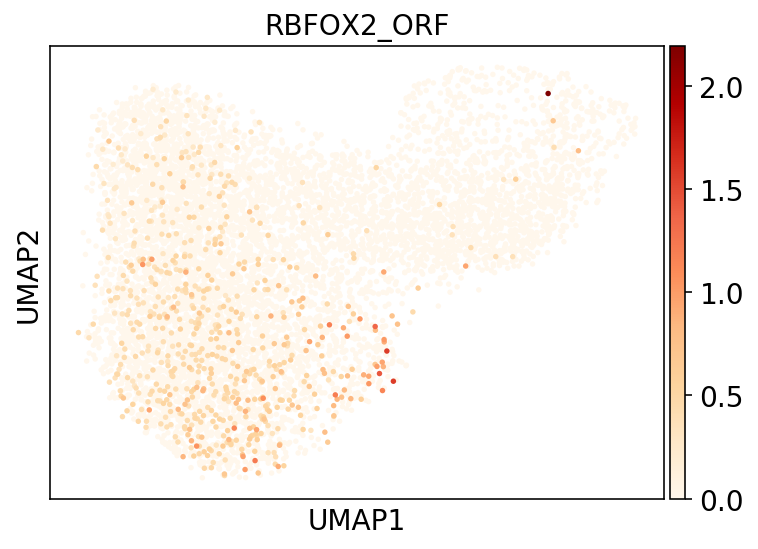

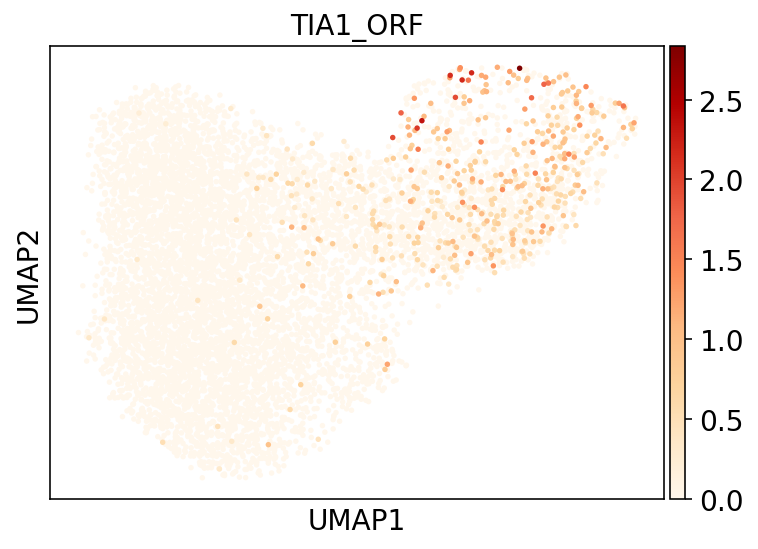

In [100]:
sc.pl.umap(adata_subset, color=['RBFOX2_ORF'],cmap='OrRd', size=30)
sc.pl.umap(adata_subset, color=['TIA1_ORF'],cmap='OrRd', size=30)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_feature']`
categories: None, RBFOX2_ORF, TIA1_ORF, etc.
var_group_labels: 0, 1


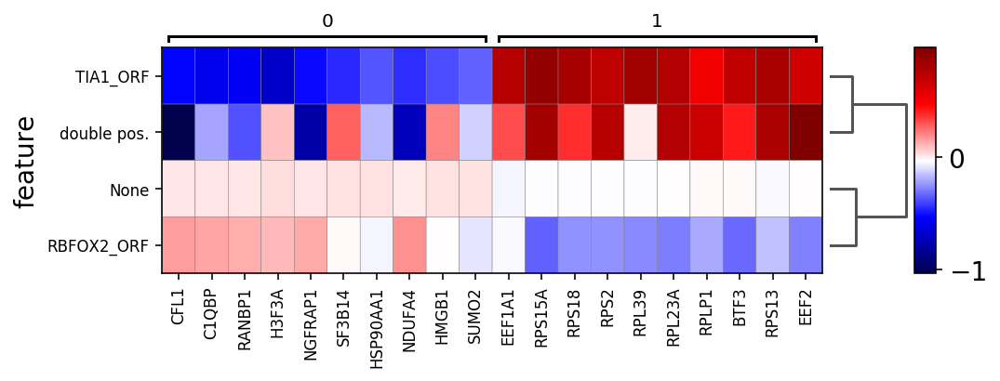

In [101]:
sc.pl.rank_genes_groups_matrixplot(adata_subset,groupby='feature',use_raw=False, cmap='seismic')

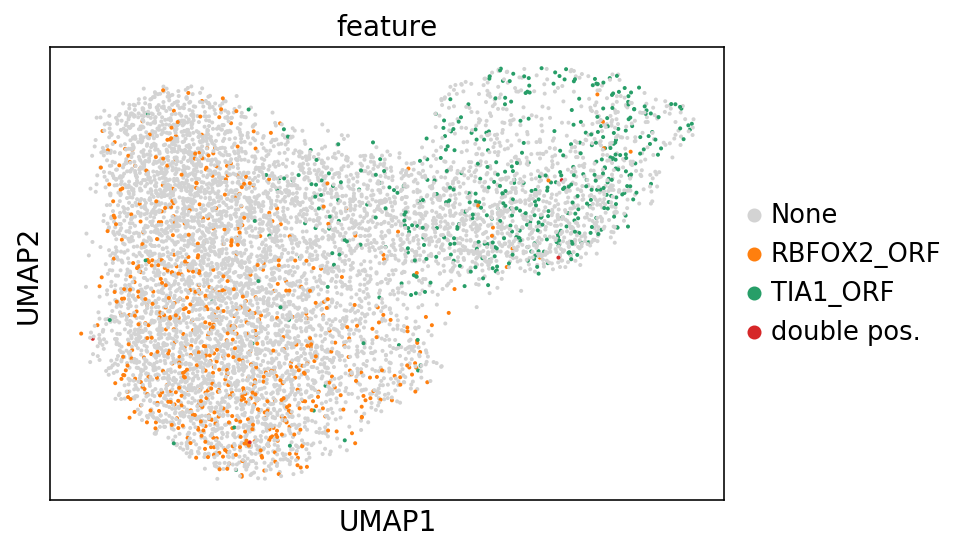

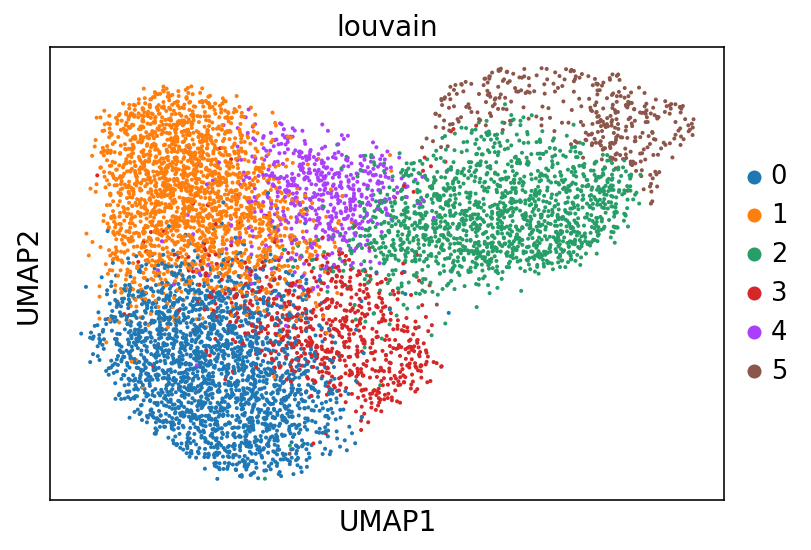

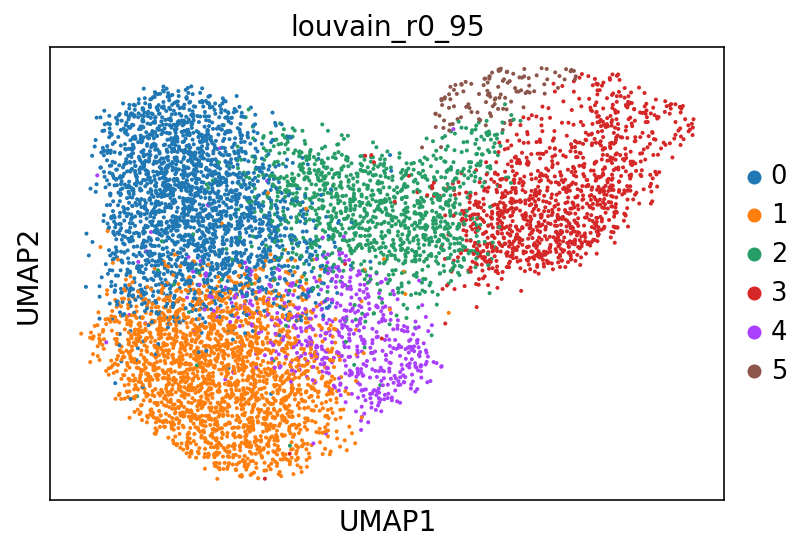

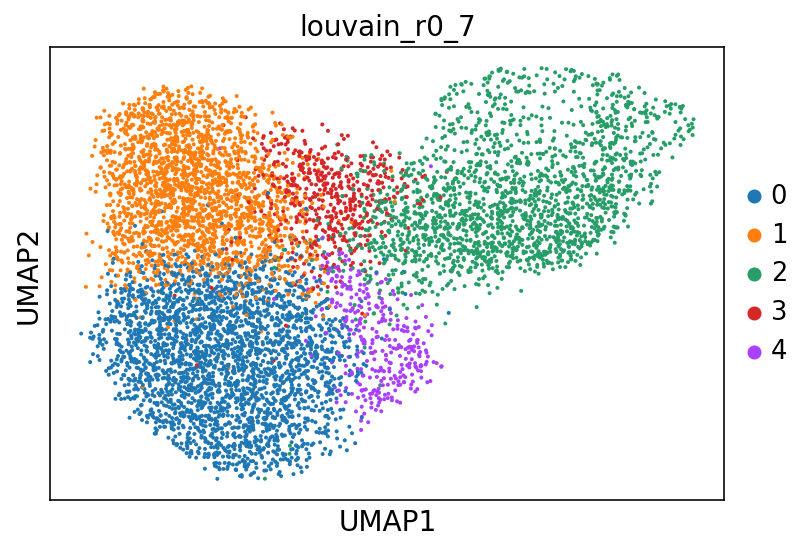

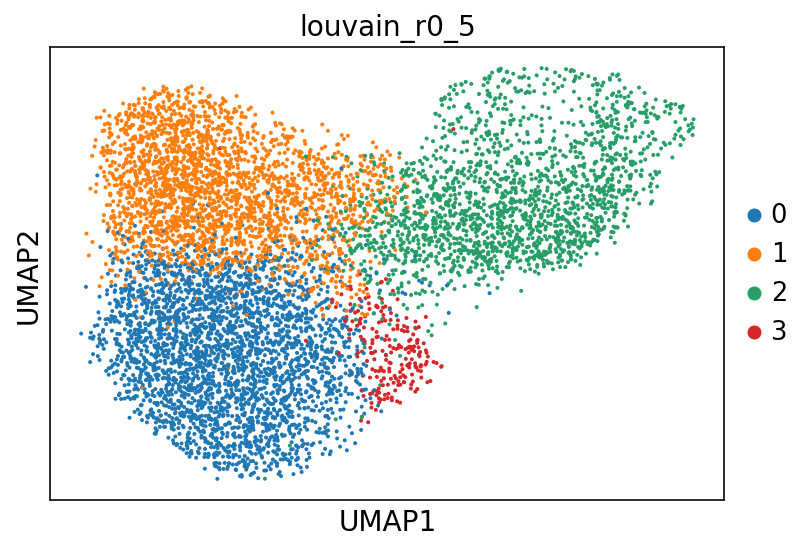

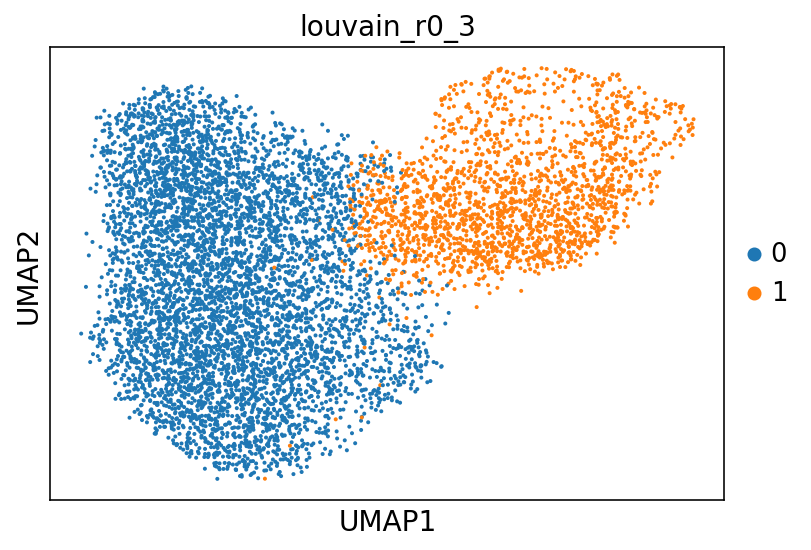

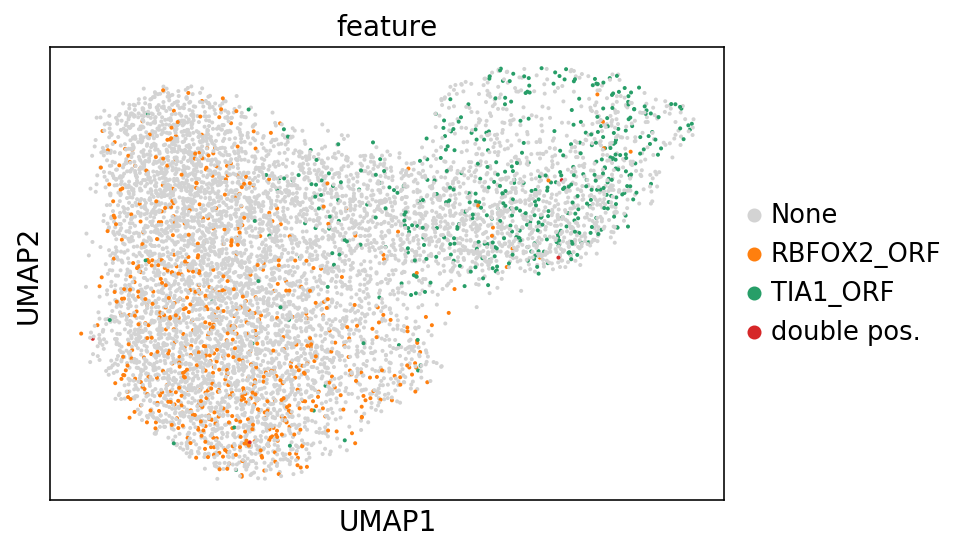

In [102]:
sc.pl.umap(adata_subset, color=['feature'])
sc.pl.umap(adata_subset, color=['louvain'])
sc.pl.umap(adata_subset, color=['louvain_r0_95'])
sc.pl.umap(adata_subset, color=['louvain_r0_7'])
sc.pl.umap(adata_subset, color=['louvain_r0_5'])
sc.pl.umap(adata_subset, color=['louvain_r0_3'])
sc.pl.umap(adata_subset, color=['feature'])

categories: None, RBFOX2_ORF, TIA1_ORF, etc.
var_group_labels: 0, 1


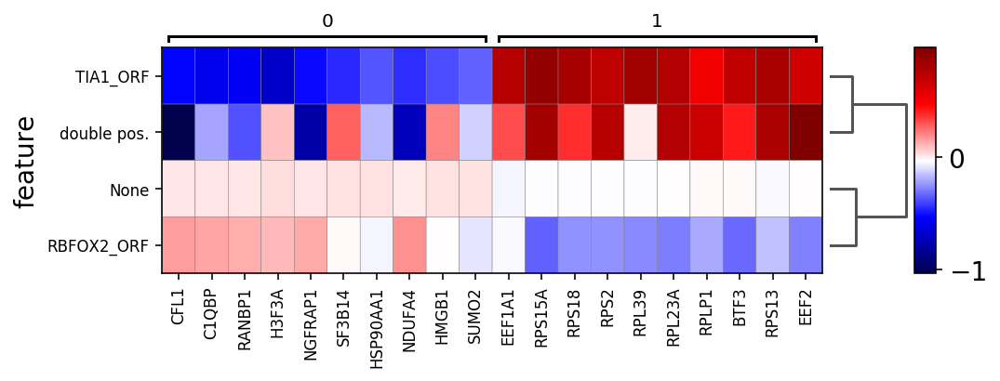

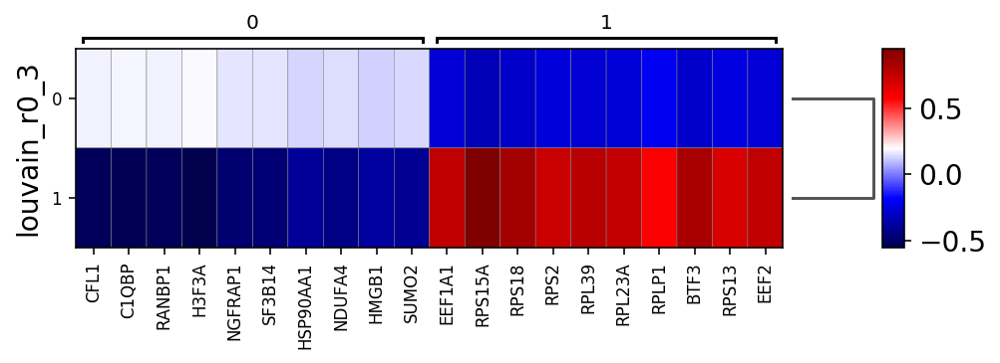

categories: None, RBFOX2_ORF, TIA1_ORF, etc.
var_group_labels: 0, 1


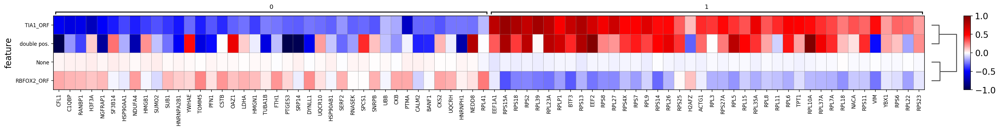

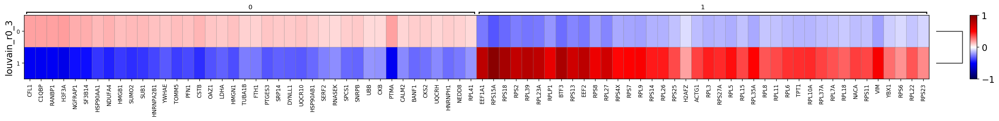

In [103]:
sc.pl.rank_genes_groups_matrixplot(adata_subset,groupby='feature',use_raw=False, cmap='seismic')
sc.pl.rank_genes_groups_matrixplot(adata_subset,groupby='louvain_r0_3',use_raw=False, cmap='seismic')
sc.pl.rank_genes_groups_matrixplot(adata_subset,groupby='feature',use_raw=False, cmap='seismic',vmin=-1,vmax=1,n_genes=40)
sc.pl.rank_genes_groups_matrixplot(adata_subset,groupby='louvain_r0_3',use_raw=False, cmap='seismic',vmin=-1,vmax=1,n_genes=40)

In [104]:
sc.pl.violin(adata_subset, ['n_genes', 'n_edits'],
                 jitter=0.3, groupby='louvain_r0_3').

SyntaxError: invalid syntax (<ipython-input-104-e83ffe0bbaa2>, line 2)

# Looking overlap with eCLIP peaks #


In [105]:
RBFOX2_CLIP_exonic=pd.read_csv('./results/RBFOX2_CLIP_unique_exonic_siggenes.tsv', sep='\t', header=None)
print(len(RBFOX2_CLIP_exonic))
RBFOX2_CLIP_exonic=RBFOX2_CLIP_exonic[[3]].set_index(3)
found=RBFOX2_CLIP_exonic.index.isin(adata_subset.var.index)
RBFOX2_CLIP_exonic['found']=found
RBFOX2_CLIP_exonic=RBFOX2_CLIP_exonic[RBFOX2_CLIP_exonic['found']==True]
print(len(RBFOX2_CLIP_exonic))
RBFOX2_CLIP_exonic_list=RBFOX2_CLIP_exonic.index.tolist()

919
80


In [106]:
TIA1_CLIP_exonic=pd.read_csv('./results/TIA1_CLIP_unique_exonic_siggenes.tsv', sep='\t', header=None)
print(len(TIA1_CLIP_exonic))
TIA1_CLIP_exonic=TIA1_CLIP_exonic[[3]].set_index(3)
found=TIA1_CLIP_exonic.index.isin(adata_subset.var.index)
TIA1_CLIP_exonic['found']=found
TIA1_CLIP_exonic=TIA1_CLIP_exonic[TIA1_CLIP_exonic['found']==True]
print(len(TIA1_CLIP_exonic))
TIA1_CLIP_exonic_list=TIA1_CLIP_exonic.index.tolist()

973
376


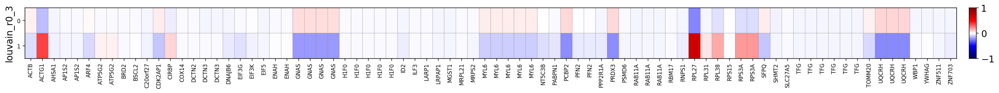

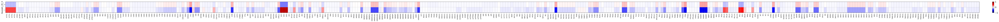

GridSpec(2, 3, height_ratios=[0, 10.5], width_ratios=[120.32000000000001, 0, 0.2])

In [107]:
sc.pl.matrixplot(adata_subset,var_names=RBFOX2_CLIP_exonic_list,groupby='louvain_r0_3', cmap='seismic',use_raw=False,vmax=1,vmin=-1)
sc.pl.matrixplot(adata_subset,var_names=TIA1_CLIP_exonic_list,groupby='louvain_r0_3', cmap='seismic',use_raw=False,vmax=1,vmin=-1)

In [108]:
adata_subset.write(results_dir+'02_02_Merge_APO_with_RBFOX_TIA_edits_over_Cs_adata_subset.h5ad')

In [197]:
adata_subset = sc.read(results_dir+'02_02_Merge_APO_with_RBFOX_TIA_edits_over_Cs_adata_subset.h5ad')

### Saving barcode tables for RBFOX2-TIA1 cells ###

In [198]:
adata_subset.obs[['louvain_r0_3']]

,louvain_r0_3
index,
possorted_genome_bam_MD-AAACCCAAGAGCCCAA-1-RBFOX_TIA-Edits,0
possorted_genome_bam_MD-AAACCCAAGTGCTACT-1-RBFOX_TIA-Edits,0
possorted_genome_bam_MD-AAACCCACAGGAAGTC-1-RBFOX_TIA-Edits,0
possorted_genome_bam_MD-AAACCCACATCTATCT-1-RBFOX_TIA-Edits,0
possorted_genome_bam_MD-AAACCCACATCTCAAG-1-RBFOX_TIA-Edits,0
...,...
possorted_genome_bam_MD-TTTGTTGGTATTCCGA-1-RBFOX_TIA-Edits,0
possorted_genome_bam_MD-TTTGTTGGTTGGAGGT-1-RBFOX_TIA-Edits,0
possorted_genome_bam_MD-TTTGTTGTCCTATGGA-1-RBFOX_TIA-Edits,0


In [199]:
new_cluster_names = [
    'RBFOX2_ORF', 'TIA1_ORF']
adata_subset.rename_categories('louvain_r0_3', new_cluster_names)

In [200]:
adata_subset.obs['louvain_r0_3'].value_counts()

RBFOX2_ORF    5536
TIA1_ORF      1907
Name: louvain_r0_3, dtype: int64

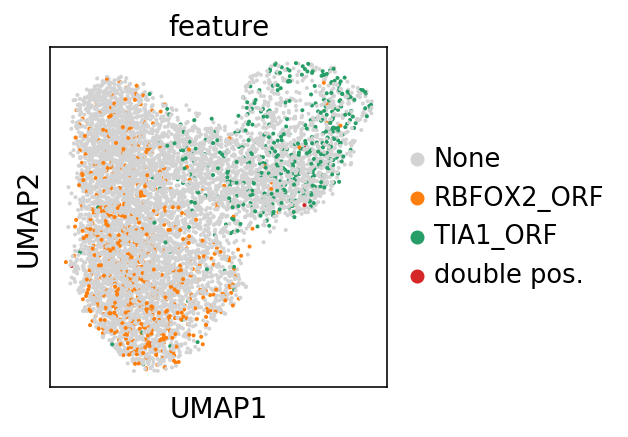

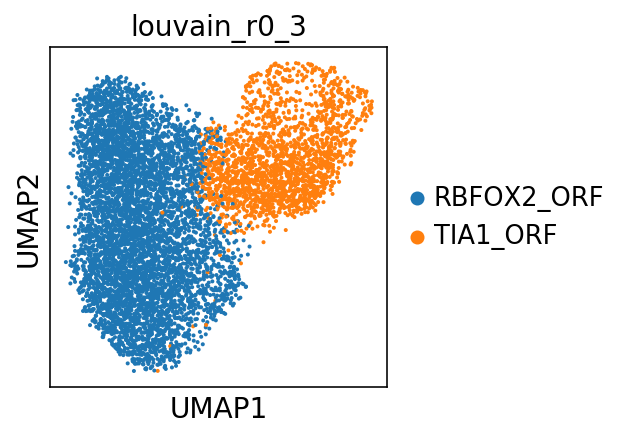

In [204]:
sc.pl.umap(adata_subset, color=['feature'])
sc.pl.umap(adata_subset, color=['louvain_r0_3'])

In [158]:
adata_subset.obs[['louvain_r0_3']].to_csv('./results/barcodes_RBFOX2-TIA1_subset.csv')

### Remove cells with feature tags ###

In [205]:
array1 = ['None']
#array2 = ['RBFOX_TIA-Edits']
subset=adata_subset.obs[['feature']]
subset=subset.loc[subset['feature'].isin(array1)]
#subset=subset.loc[subset['batch'].isin(array2)]
subset

,feature
index,
possorted_genome_bam_MD-AAACCCAAGAGCCCAA-1-RBFOX_TIA-Edits,None
possorted_genome_bam_MD-AAACCCAAGTGCTACT-1-RBFOX_TIA-Edits,None
possorted_genome_bam_MD-AAACCCACAGGAAGTC-1-RBFOX_TIA-Edits,None
possorted_genome_bam_MD-AAACCCACATCTATCT-1-RBFOX_TIA-Edits,None
possorted_genome_bam_MD-AAACCCACATCTCAAG-1-RBFOX_TIA-Edits,None
...,...
possorted_genome_bam_MD-TTTGTTGCATGGCGCT-1-RBFOX_TIA-Edits,None
possorted_genome_bam_MD-TTTGTTGGTTGGAGGT-1-RBFOX_TIA-Edits,None
possorted_genome_bam_MD-TTTGTTGTCCTATGGA-1-RBFOX_TIA-Edits,None


In [206]:
barcodes=subset.index.values.tolist()

In [207]:
adata_subset=adata_subset[barcodes].copy()

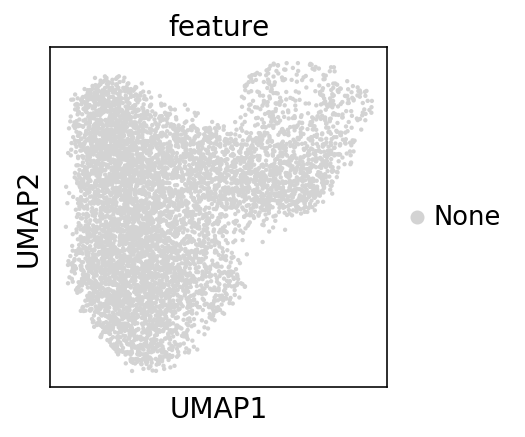

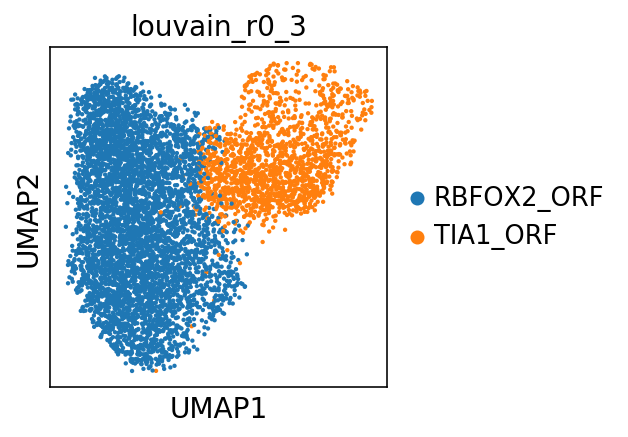

In [208]:
sc.pl.umap(adata_subset, color=['feature'])
sc.pl.umap(adata_subset, color=['louvain_r0_3'])

In [209]:
adata_subset.obs['louvain_r0_3'].value_counts()

RBFOX2_ORF    4846
TIA1_ORF      1503
Name: louvain_r0_3, dtype: int64

In [185]:
adata_subset.obs[['louvain_r0_3']].to_csv('./results/barcodes_RBFOX2-TIA1_subset_noFeatureCells.csv')

## Subseting adata_subset to the most "extreme" louvain groups ##

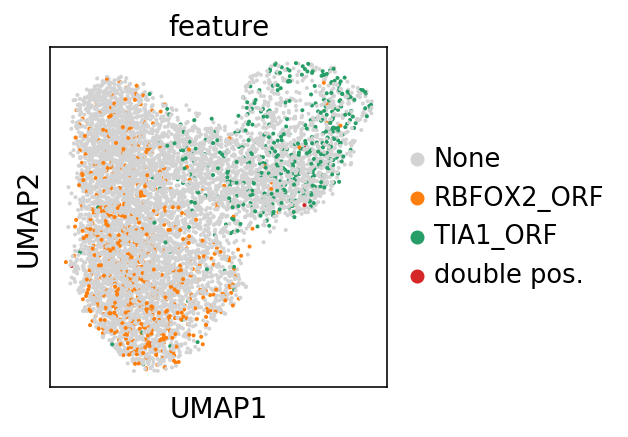

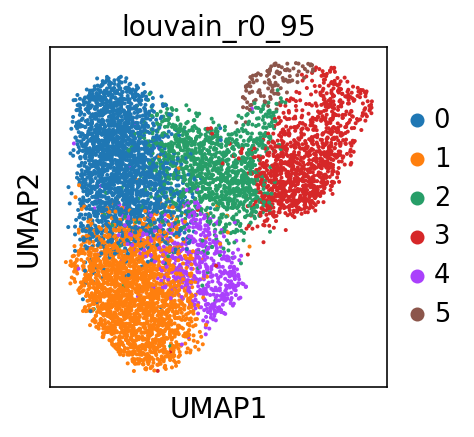

In [139]:
sc.pl.umap(adata_subset, color=['feature'])
sc.pl.umap(adata_subset, color=['louvain_r0_95'])

In [140]:
# RBFOX = 1
# TIA = 3

In [141]:
array1 = ['1','3']
array2 = ['RBFOX_TIA-Edits']
subset=adata_subset.obs[['batch','louvain_r0_95']]
subset=subset.loc[subset['louvain_r0_95'].isin(array1)]
subset=subset.loc[subset['batch'].isin(array2)]
subset

,batch,louvain_r0_95
index,,
possorted_genome_bam_MD-AAACCCAAGAGCCCAA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,1
possorted_genome_bam_MD-AAACCCACATCTCAAG-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,1
possorted_genome_bam_MD-AAACCCAGTCAAGCGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,1
possorted_genome_bam_MD-AAACCCAGTTCAGGTT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,1
possorted_genome_bam_MD-AAACCCATCGCAGAGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,3
...,...,...
possorted_genome_bam_MD-TTTGGTTTCGACGAGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,1
possorted_genome_bam_MD-TTTGTTGAGGGCTGAT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,1
possorted_genome_bam_MD-TTTGTTGCAACCGTAT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,1


In [142]:
subset.to_csv('./results/RBFOX2-TIA1_non_APO_edits_barcodes_subset.csv')

In [75]:
barcodes=subset.index.values.tolist()

In [76]:
adata_subset_more=adata_backup[barcodes].copy()

In [77]:
adata_subset_more

AnnData object with n_obs × n_vars = 3293 × 1964 
    obs: 'batch', 'n_edits', 'n_genes'
    var: 'n_cells-Apo-Edits', 'n_cells-RBFOX_TIA-Edits'
    uns: 'batch_colors'

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


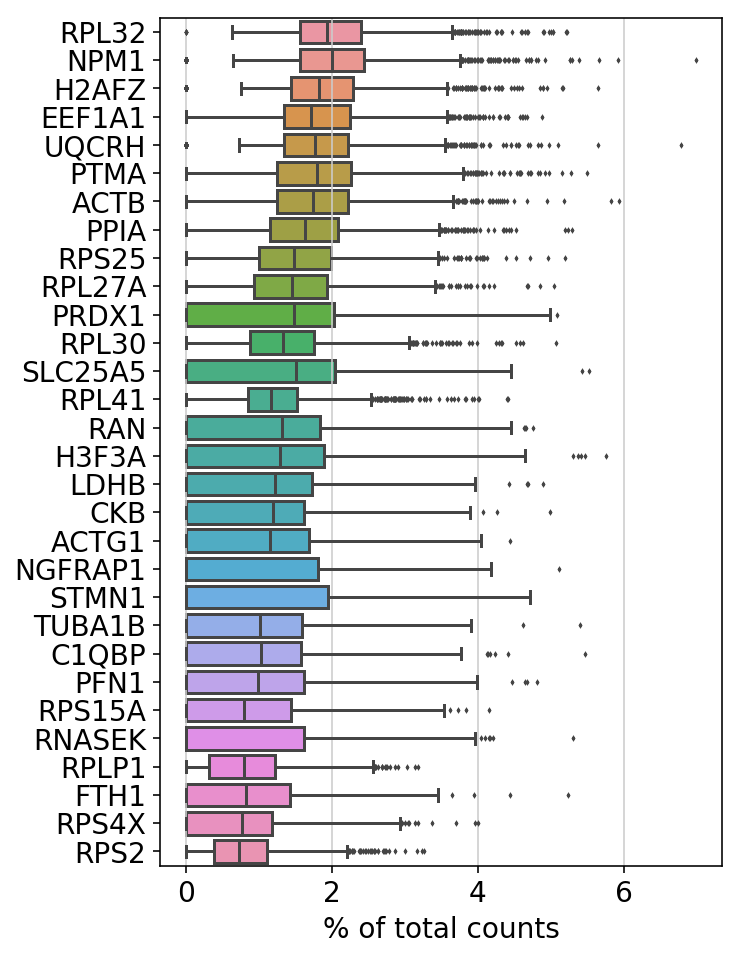

In [78]:
sc.pl.highest_expr_genes(adata_subset_more, n_top=30)

In [79]:
print(np.any(adata_subset_more.X.sum(axis=0) == 0))
print(np.any(adata_subset_more.X.sum(axis=1) == 0))

True
False


In [80]:
adata_subset_more = adata_subset_more[:,adata_subset_more.X.sum(axis=0) > 0].copy()

In [81]:
adata_subset_more

AnnData object with n_obs × n_vars = 3293 × 1146 
    obs: 'batch', 'n_edits', 'n_genes'
    var: 'n_cells-Apo-Edits', 'n_cells-RBFOX_TIA-Edits'
    uns: 'batch_colors'

In [82]:
sc.pp.regress_out(adata_subset_more, ['n_edits'])

regressing out ['n_edits']
    finished (0:00:04)


In [83]:
sc.pp.scale(adata_subset_more, max_value=10)

# Cluster with louvain

In [84]:
sc.tl.pca(adata_subset_more, svd_solver='arpack')

computing PCA with n_comps = 50
    finished (0:00:00)


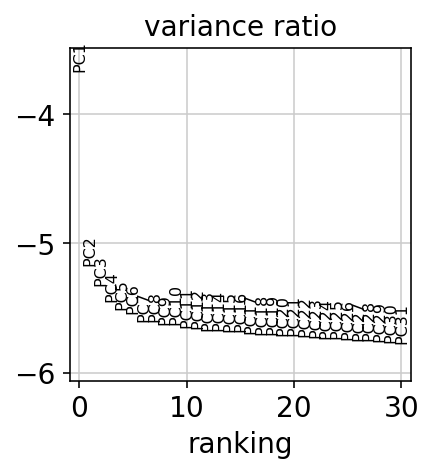

In [85]:
sc.pl.pca_variance_ratio(adata_subset_more, log=True)

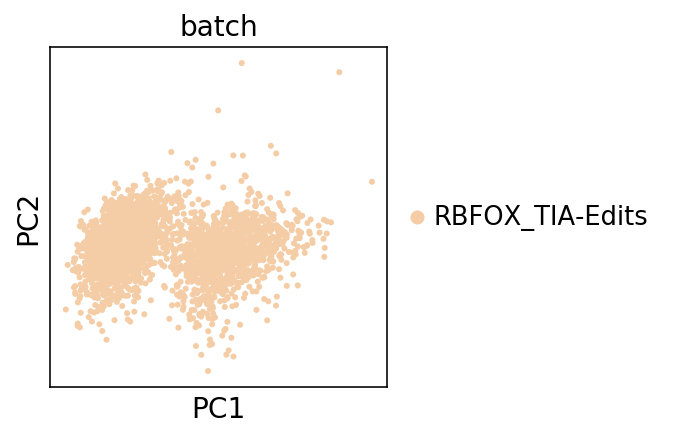

In [86]:
sc.pl.pca(adata_subset_more, color='batch')

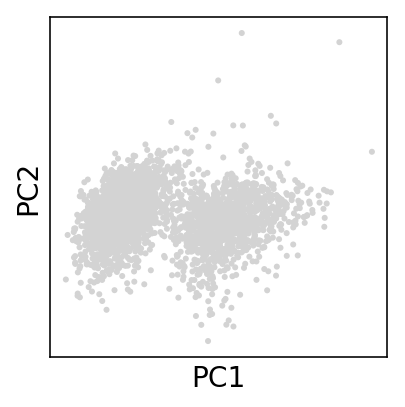

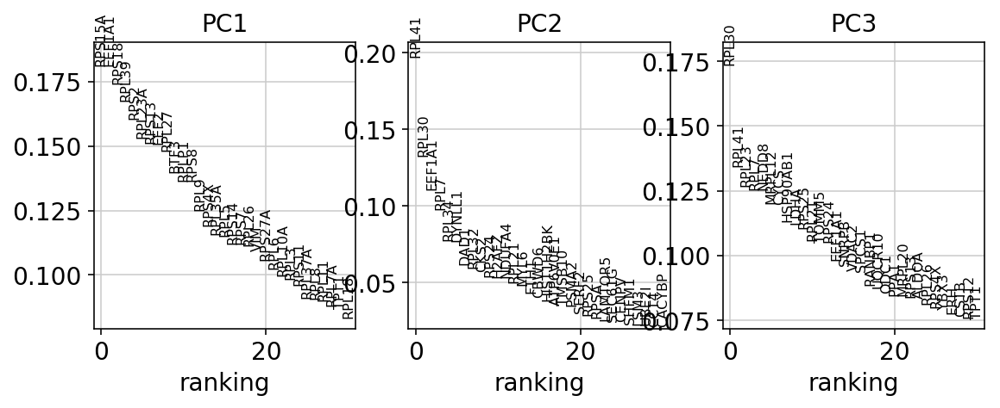

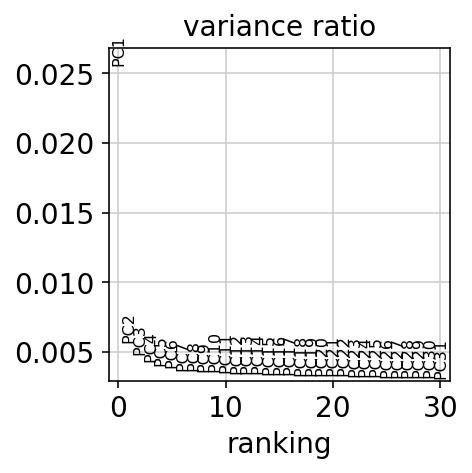

In [87]:
sc.pl.pca_overview(adata_subset_more)

In [88]:
sc.pp.neighbors(adata_subset_more, n_neighbors=10, n_pcs=40)

computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:00)


In [89]:
sc.tl.umap(adata_subset_more)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)


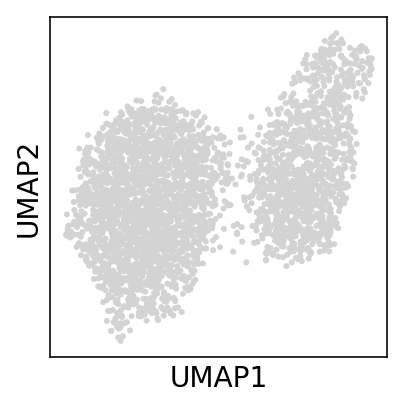

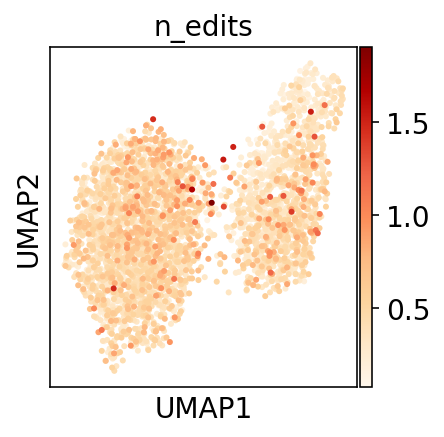

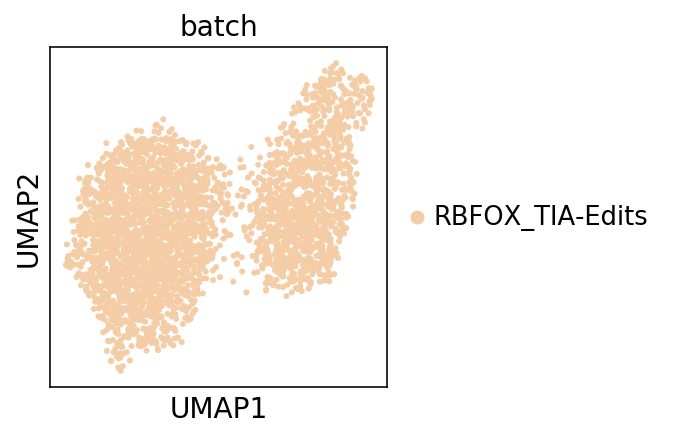

In [90]:
sc.pl.umap(adata_subset_more)
sc.pl.umap(adata_subset_more, color='n_edits', cmap='OrRd')
sc.pl.umap(adata_subset_more, color='batch')

In [91]:
adata_subset_more.obs['batch'].value_counts()

RBFOX_TIA-Edits    3293
Name: batch, dtype: int64

In [92]:
sc.tl.louvain(adata_subset_more)
sc.tl.louvain(adata_subset_more, resolution=0.8, key_added='louvain_r0_8')
sc.tl.louvain(adata_subset_more, resolution=0.7, key_added='louvain_r0_7')
sc.tl.louvain(adata_subset_more, resolution=0.5, key_added='louvain_r0_5')
sc.tl.louvain(adata_subset_more, resolution=0.3, key_added='louvain_r0_3')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 6 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 4 clusters and added
    'louvain_r0_8', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 3 clusters and added
    'louvain_r0_7', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 2 clusters and added
    'louvain_r0_5', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 2 clusters and added
    'louvain_r0_3', the cluster labels (adata.obs, categorical) (0:00:00)


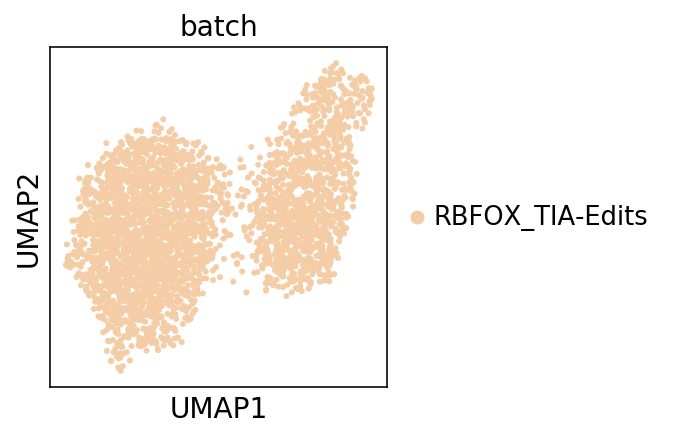

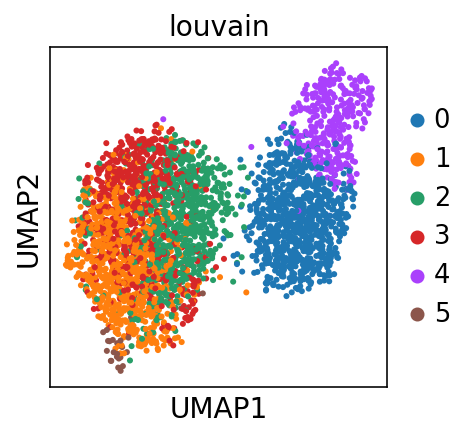

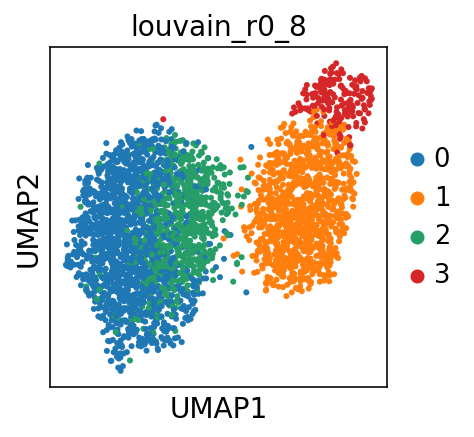

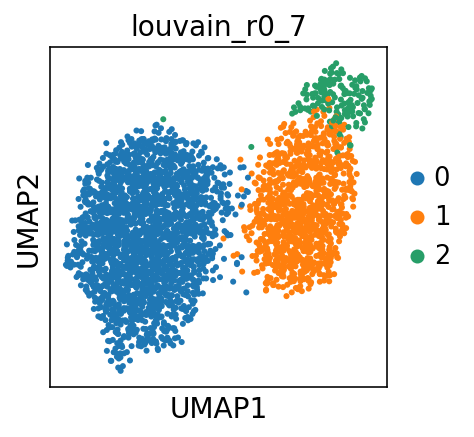

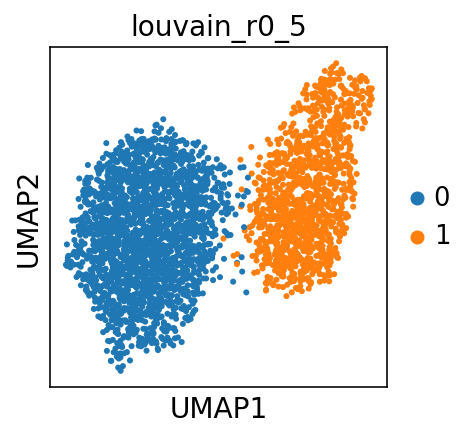

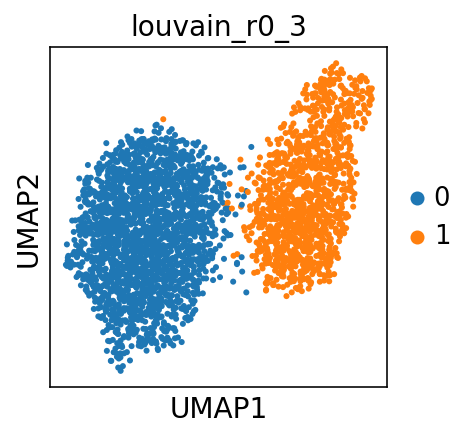

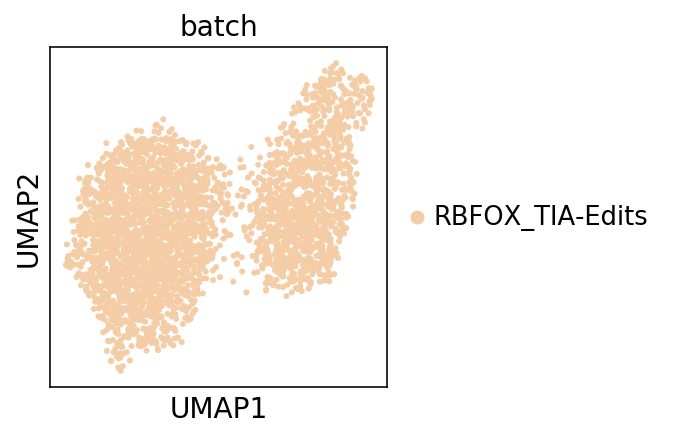

In [93]:
sc.pl.umap(adata_subset_more, color=['batch'])
sc.pl.umap(adata_subset_more, color=['louvain'])
sc.pl.umap(adata_subset_more, color=['louvain_r0_8'])
sc.pl.umap(adata_subset_more, color=['louvain_r0_7'])
sc.pl.umap(adata_subset_more, color=['louvain_r0_5'])
sc.pl.umap(adata_subset_more, color=['louvain_r0_3'])
sc.pl.umap(adata_subset_more, color=['batch'])

### For louvain, merge 2,3 ###

In [94]:
adata_subset_more.obs['new_clusters'] = (
    adata_subset_more.obs['louvain']
    .map(lambda x: {'2': '3'}.get(x, x))
    .astype("category")
)

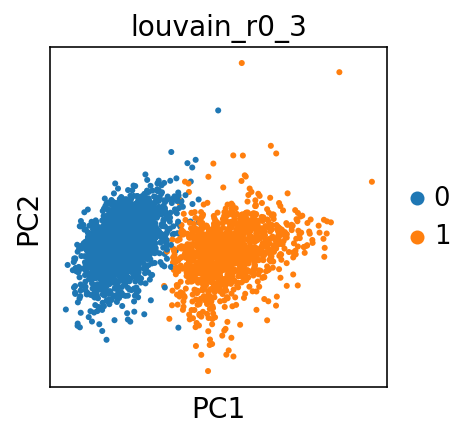

In [95]:
sc.pl.pca(adata_subset_more, color=['louvain_r0_3'])

In [96]:
sc.tl.rank_genes_groups(adata_subset_more, 'louvain_r0_3', method='wilcoxon',n_genes=100)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_louvain_r0_3']`


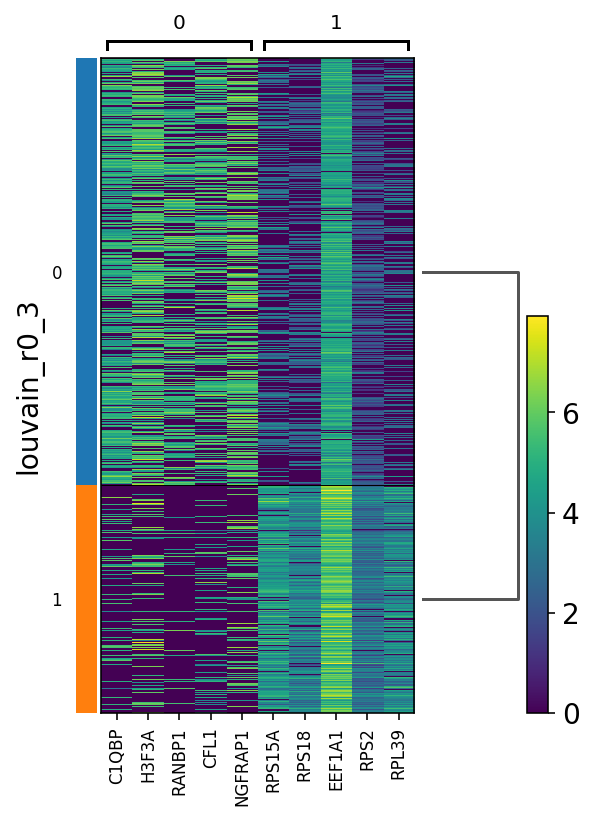

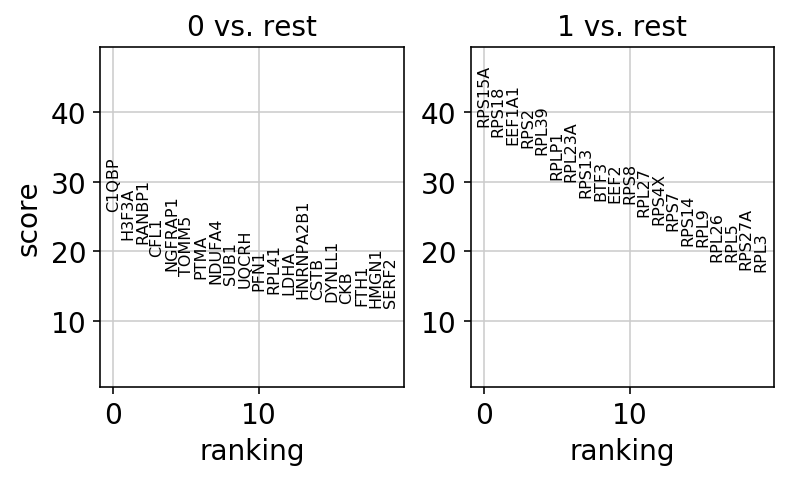

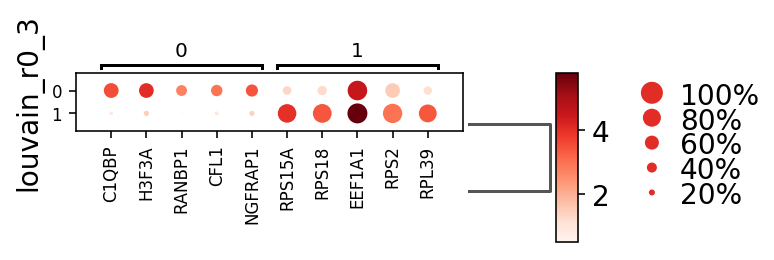

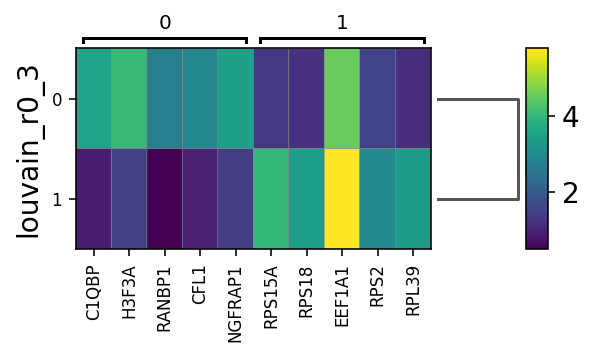

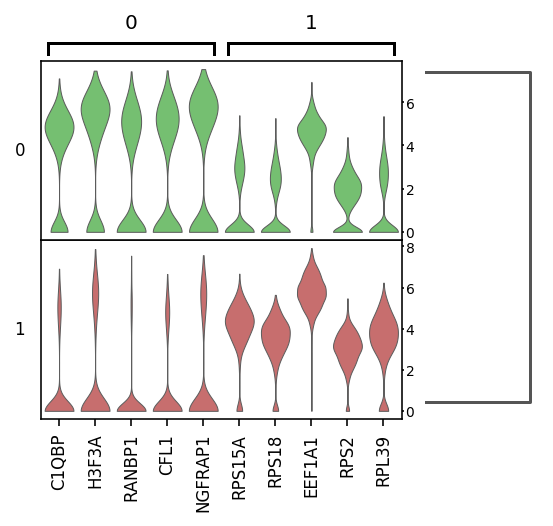

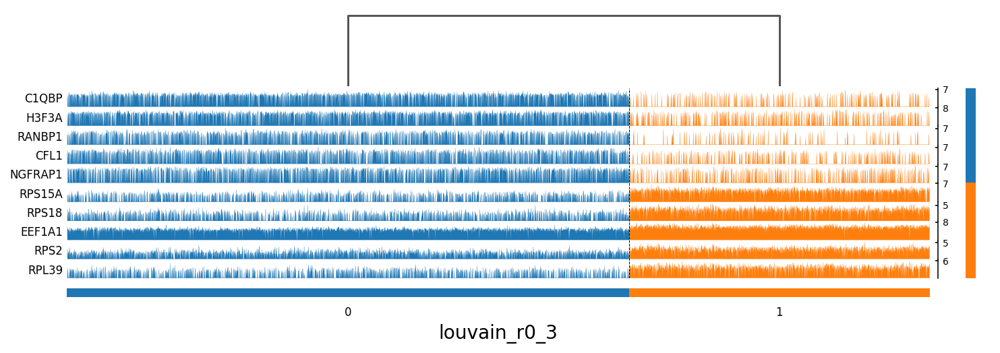

In [97]:
sc.pl.rank_genes_groups_heatmap(adata_subset_more,key='rank_genes_groups',n_genes=5,cmap='viridis')
sc.pl.rank_genes_groups(adata_subset_more, n_genes=20)
sc.pl.rank_genes_groups_dotplot(adata_subset_more,key='rank_genes_groups',n_genes=5)
sc.pl.rank_genes_groups_matrixplot(adata_subset_more,key='rank_genes_groups',n_genes=5)
sc.pl.rank_genes_groups_stacked_violin(adata_subset_more,key='rank_genes_groups',n_genes=5)
#sc.pl.rank_genes_groups_violin(adata_subset,key='rank_genes_groups',n_genes=5)
sc.pl.rank_genes_groups_tracksplot(adata_subset_more,key='rank_genes_groups',n_genes=5)

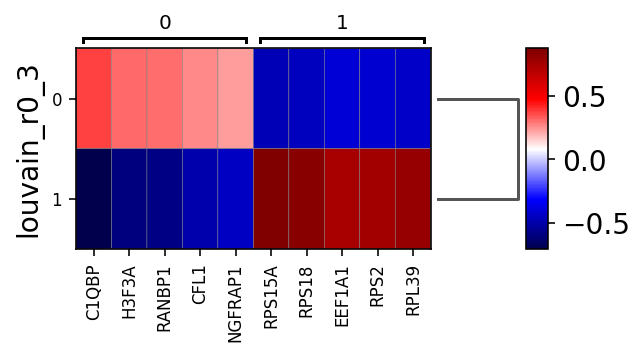

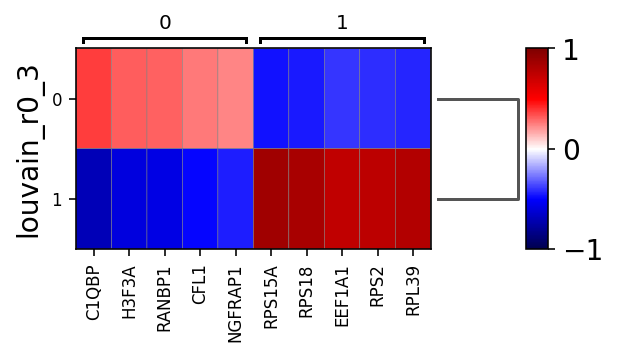

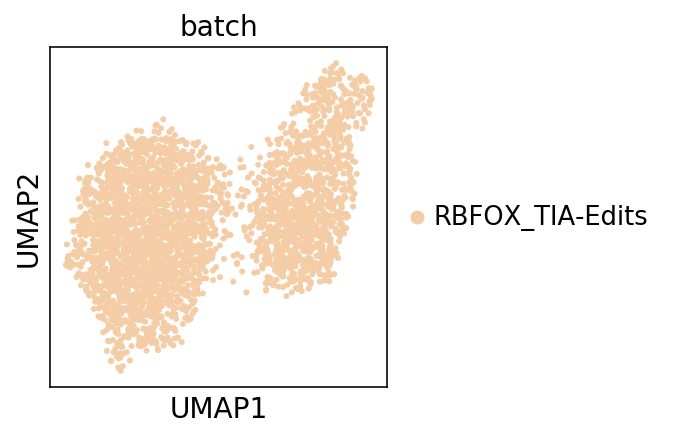

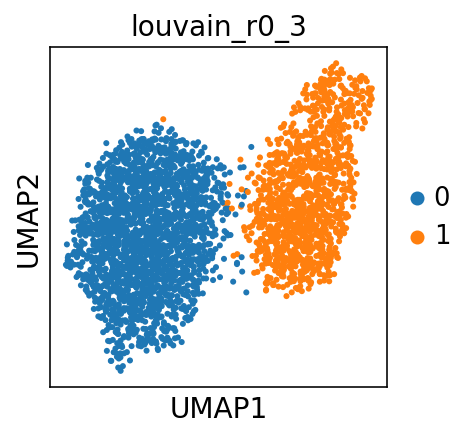

In [98]:
sc.pl.rank_genes_groups_matrixplot(adata_subset_more,key='rank_genes_groups',n_genes=5,
                                   cmap='seismic', use_raw=False)
sc.pl.rank_genes_groups_matrixplot(adata_subset_more,key='rank_genes_groups',n_genes=5,
                                   cmap='seismic', use_raw=False, vmin=-1, vmax=1)
sc.pl.umap(adata_subset_more, color=['batch'])
sc.pl.umap(adata_subset_more, color=['louvain_r0_3'])

In [99]:
result = adata_subset_more.uns['rank_genes_groups']
groups = result['names'].dtype.names
result=pd.DataFrame(
    {group + '_' + key[:]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges','pvals','pvals_adj']})
result.head(50)

,0_names,0_logfoldchanges,0_pvals,0_pvals_adj,1_names,1_logfoldchanges,1_pvals,1_pvals_adj
0,C1QBP,4.596148,1.581606e-146,2.589879e-144,RPS15A,4.251141,0.000000e+00,0.000000e+00
1,H3F3A,4.099065,1.499935e-105,1.842108e-103,RPS18,3.592187,1.490105e-291,1.464028e-288
2,RANBP1,4.558445,2.628288e-99,3.037992e-97,EEF1A1,1.797537,7.619940e-275,4.991061e-272
3,CFL1,3.566218,1.116963e-83,1.097416e-81,RPS2,2.373120,1.554044e-266,7.634240e-264
4,NGFRAP1,3.299637,1.377122e-67,1.127519e-65,RPL39,3.682414,4.860231e-253,1.910071e-250
5,TOMM5,3.943089,1.573346e-62,1.189086e-60,RPLP1,2.291667,1.227091e-202,4.018722e-200
6,PTMA,3.508793,2.296567e-59,1.611698e-57,RPL23A,3.912013,7.746728e-198,2.174617e-195
7,NDUFA4,3.977842,1.932396e-54,1.265720e-52,RPS13,3.524395,3.935492e-169,9.666551e-167
8,SUB1,4.463171,8.685470e-53,5.171803e-51,BTF3,5.100571,2.476368e-165,5.406738e-163
9,UQCRH,1.870145,1.621752e-50,9.104981e-49,EEF2,4.894648,1.833337e-161,3.602507e-159


In [100]:
#result.to_csv('./results/Triple_merge_louvain_edits.csv')

In [101]:
#adata_subset.var.to_csv(('./results/all_edited_genes.csv'))

In [102]:
edits_louvain_r0_5_by_barcode=adata_subset_more.obs[['louvain_r0_5']]
edits_louvain_r0_5_by_barcode=edits_louvain_r0_5_by_barcode.rename(columns={'louvain_r0_5':'edits_louvain_r0_5'})
#edits_louvain_r0_5_by_barcode.to_csv('./results/edits_louvain_r0_5_by_barcode.csv')
edits_louvain_r0_5_by_barcode

,edits_louvain_r0_5
possorted_genome_bam_MD-AAACCCAAGAGCCCAA-1-RBFOX_TIA-Edits,0
possorted_genome_bam_MD-AAACCCACATCTCAAG-1-RBFOX_TIA-Edits,0
possorted_genome_bam_MD-AAACCCAGTCAAGCGA-1-RBFOX_TIA-Edits,0
possorted_genome_bam_MD-AAACCCAGTTCAGGTT-1-RBFOX_TIA-Edits,0
possorted_genome_bam_MD-AAACCCATCGCAGAGA-1-RBFOX_TIA-Edits,0
...,...
possorted_genome_bam_MD-TTTGGTTTCGACGAGA-1-RBFOX_TIA-Edits,0
possorted_genome_bam_MD-TTTGTTGAGGGCTGAT-1-RBFOX_TIA-Edits,0
possorted_genome_bam_MD-TTTGTTGCAACCGTAT-1-RBFOX_TIA-Edits,0
possorted_genome_bam_MD-TTTGTTGCATGGCGCT-1-RBFOX_TIA-Edits,0


# grabbing TIA and RBFOX barcodes from read1_feature_FB_R1_TrimTo10 #

In [103]:
adata_subset_more.obs

,batch,n_edits,n_genes,louvain,louvain_r0_8,louvain_r0_7,louvain_r0_5,louvain_r0_3,new_clusters
possorted_genome_bam_MD-AAACCCAAGAGCCCAA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.716930,127,1,0,0,0,0,1
possorted_genome_bam_MD-AAACCCACATCTCAAG-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.147199,43,1,0,0,0,0,1
possorted_genome_bam_MD-AAACCCAGTCAAGCGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.562692,70,2,2,0,0,0,3
possorted_genome_bam_MD-AAACCCAGTTCAGGTT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.515172,88,1,2,0,0,0,1
possorted_genome_bam_MD-AAACCCATCGCAGAGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.877225,96,2,2,0,0,1,3
...,...,...,...,...,...,...,...,...,...
possorted_genome_bam_MD-TTTGGTTTCGACGAGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.340470,64,1,0,0,0,0,1
possorted_genome_bam_MD-TTTGTTGAGGGCTGAT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.615360,93,2,2,0,0,0,3
possorted_genome_bam_MD-TTTGTTGCAACCGTAT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.404754,86,1,0,0,0,0,1
possorted_genome_bam_MD-TTTGTTGCATGGCGCT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.492543,82,2,2,0,0,0,3


In [104]:
TIA_barcodes=pd.read_csv('./results/TIA1_ORF_matrix.csv',index_col=0)
TIA_barcodes=TIA_barcodes.reset_index()
TIA_barcodes['index']='possorted_genome_bam_MD-'+TIA_barcodes['index'].astype(str)+'-RBFOX_TIA-Edits'
TIA_barcodes=TIA_barcodes.set_index('index', drop=True)
TIA_barcodes=TIA_barcodes[TIA_barcodes['TIA1_ORF']>0]
TIA_barcodes

,TIA1_ORF
index,
possorted_genome_bam_MD-GTGAGTTCAACAGATA-1-RBFOX_TIA-Edits,2.832962
possorted_genome_bam_MD-TCACATTCAAATGAAC-1-RBFOX_TIA-Edits,2.337002
possorted_genome_bam_MD-ATCGTGAGTCCATACA-1-RBFOX_TIA-Edits,2.181383
possorted_genome_bam_MD-CCTCCTCCATCGATGT-1-RBFOX_TIA-Edits,2.172716
possorted_genome_bam_MD-CGGAGAACAGCACAAG-1-RBFOX_TIA-Edits,2.155660
...,...
possorted_genome_bam_MD-GAAATGACAGTCAGTT-1-RBFOX_TIA-Edits,0.243992
possorted_genome_bam_MD-GATGACTAGGGAGTTC-1-RBFOX_TIA-Edits,0.240746
possorted_genome_bam_MD-AGGGTCCCATCAGTGT-1-RBFOX_TIA-Edits,0.234861


In [105]:
RBFOX_barcodes=pd.read_csv('./results/RBFOX2_ORF_matrix.csv',index_col=0)
RBFOX_barcodes=RBFOX_barcodes.reset_index()
RBFOX_barcodes['index']='possorted_genome_bam_MD-'+RBFOX_barcodes['index'].astype(str)+'-RBFOX_TIA-Edits'
RBFOX_barcodes=RBFOX_barcodes.set_index('index', drop=True)
RBFOX_barcodes=RBFOX_barcodes[RBFOX_barcodes['RBFOX2_ORF']>0]
RBFOX_barcodes

,RBFOX2_ORF
index,
possorted_genome_bam_MD-TGCGGGTGTGTTCCTC-1-RBFOX_TIA-Edits,2.190145
possorted_genome_bam_MD-ACGGTTAAGTGGTTAA-1-RBFOX_TIA-Edits,2.075209
possorted_genome_bam_MD-TCAGTGAGTGGGTATG-1-RBFOX_TIA-Edits,1.948830
possorted_genome_bam_MD-GAAGCCCGTCAATGGG-1-RBFOX_TIA-Edits,1.734930
possorted_genome_bam_MD-ATTCGTTTCGGTTCAA-1-RBFOX_TIA-Edits,1.696412
...,...
possorted_genome_bam_MD-TGCGGCATCACCTGGG-1-RBFOX_TIA-Edits,0.205525
possorted_genome_bam_MD-CATTCATAGAAGAGCA-1-RBFOX_TIA-Edits,0.201960
possorted_genome_bam_MD-CCCTTAGTCATGACAC-1-RBFOX_TIA-Edits,0.198398


In [106]:
RBFOX_list = list(RBFOX_barcodes.index)
TIA_list = list(TIA_barcodes.index)

In [107]:
df=adata_subset_more.obs
def in_list (row, r=RBFOX_list, t=TIA_list):
    if (row['index'] in r) and (row['index'] in t):
        return 'double pos.'
    if row['index'] in r :
        return 'RBFOX2_ORF'
    if row['index'] in t:
        return 'TIA1_ORF'

dx=df.reset_index()
dx['feature']=dx.apply(in_list, axis=1)
dx=dx.set_index('index', drop=True)
dx

,batch,n_edits,n_genes,louvain,louvain_r0_8,louvain_r0_7,louvain_r0_5,louvain_r0_3,new_clusters,feature
index,,,,,,,,,,
possorted_genome_bam_MD-AAACCCAAGAGCCCAA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.716930,127,1,0,0,0,0,1,None
possorted_genome_bam_MD-AAACCCACATCTCAAG-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.147199,43,1,0,0,0,0,1,None
possorted_genome_bam_MD-AAACCCAGTCAAGCGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.562692,70,2,2,0,0,0,3,None
possorted_genome_bam_MD-AAACCCAGTTCAGGTT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.515172,88,1,2,0,0,0,1,None
possorted_genome_bam_MD-AAACCCATCGCAGAGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.877225,96,2,2,0,0,1,3,None
...,...,...,...,...,...,...,...,...,...,...
possorted_genome_bam_MD-TTTGGTTTCGACGAGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.340470,64,1,0,0,0,0,1,None
possorted_genome_bam_MD-TTTGTTGAGGGCTGAT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.615360,93,2,2,0,0,0,3,None
possorted_genome_bam_MD-TTTGTTGCAACCGTAT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.404754,86,1,0,0,0,0,1,None


In [108]:
dx['feature'].value_counts()

RBFOX2_ORF     352
TIA1_ORF       279
double pos.      4
Name: feature, dtype: int64

In [109]:
adata_subset_more.obs=dx

In [110]:
adata_subset_more.uns['feature_colors']=['#D3D3D3', '#ff7f0e', '#279e68', '#d62728']

... storing 'feature' as categorical


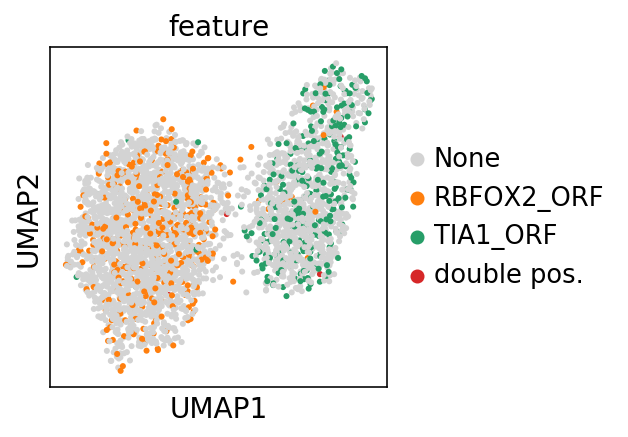

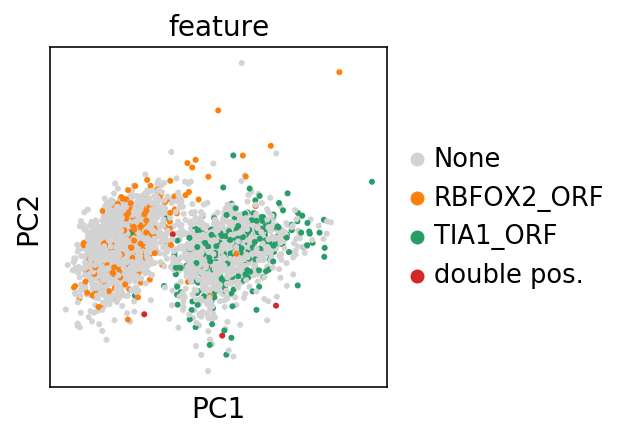

In [111]:
sc.pl.umap(adata_subset_more, color=['feature'])
sc.pl.pca(adata_subset_more, color='feature')

([], <a list of 0 Text yticklabel objects>)

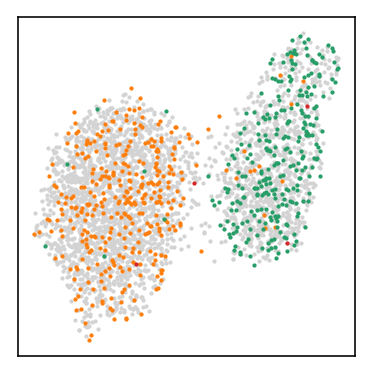

In [112]:
test=adata_subset_more.obs
test2=pd.DataFrame({'X_umap':adata_subset_more.obsm['X_umap'][:,0],'Y_umap':adata_subset_more.obsm['X_umap'][:,1]})
test3=pd.DataFrame({'X_pca':adata_subset_more.obsm['X_pca'][:,0],'Y_pca':adata_subset_more.obsm['X_pca'][:,1]})

test['X_umap']=test2['X_umap'].tolist()
test['Y_umap']=test2['Y_umap'].tolist()

test['X_pca']=test3['X_pca'].tolist()
test['Y_pca']=test3['Y_pca'].tolist()

colors_samples={'None':'#D3D3D3',
                'RBFOX2_ORF':'#ff7f0e',
                'TIA1_ORF':'#279e68',
                'double pos.':'#d62728'}

dot_size=5
color_combo=colors_samples
grouping='feature'

################################################

plt.scatter(x=test[test[grouping]=='None']['X_umap'],y=test[test[grouping]=='None']['Y_umap'],
            color=color_combo['None'],s=dot_size,marker='.')
plt.scatter(x=test[test[grouping]=='RBFOX2_ORF']['X_umap'],y=test[test[grouping]=='RBFOX2_ORF']['Y_umap'],
            color=color_combo['RBFOX2_ORF'],s=dot_size,marker='.')
plt.scatter(x=test[test[grouping]=='TIA1_ORF']['X_umap'],y=test[test[grouping]=='TIA1_ORF']['Y_umap'],
            color=color_combo['TIA1_ORF'],s=dot_size,marker='.')
plt.scatter(x=test[test[grouping]=='double pos.']['X_umap'],y=test[test[grouping]=='double pos.']['Y_umap'],
            color=color_combo['double pos.'],s=dot_size,marker='.')


################################################

plt.grid(False)
plt.xticks([])
plt.yticks([])

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_feature']`
categories: None, RBFOX2_ORF, TIA1_ORF, etc.
var_group_labels: 0, 1


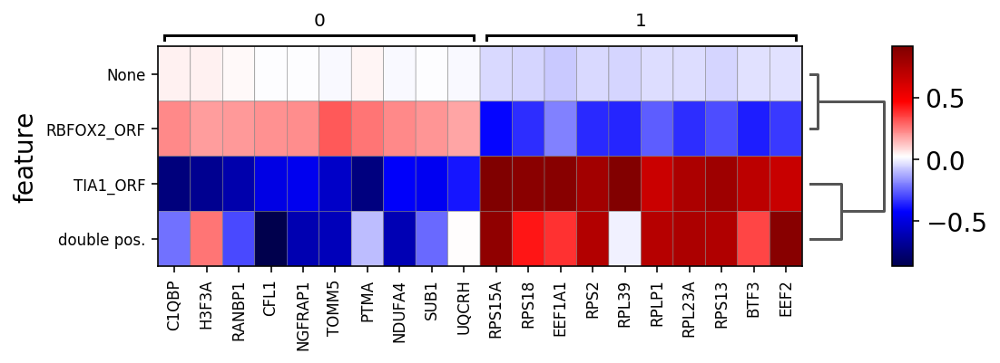

In [113]:
sc.pl.rank_genes_groups_matrixplot(adata_subset_more,groupby='feature',use_raw=False, cmap='seismic')

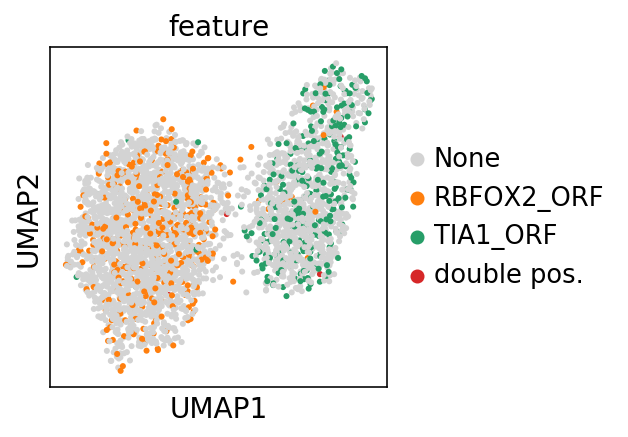

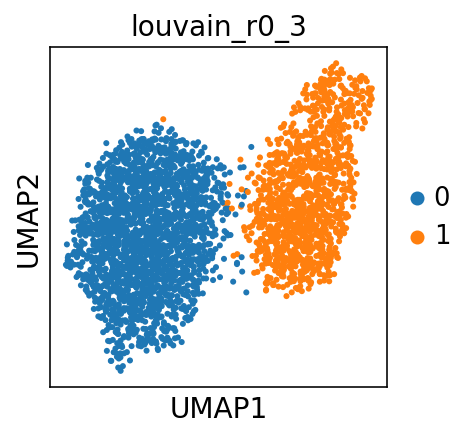

In [114]:
sc.pl.umap(adata_subset_more, color=['feature'])
sc.pl.umap(adata_subset_more, color=['louvain_r0_3'])

## feature by expression level ##

In [115]:
RBFOX_barcodes=pd.read_csv('./results/RBFOX2_ORF_matrix.csv',index_col=0)
RBFOX_barcodes=RBFOX_barcodes.reset_index()
RBFOX_barcodes['index']='possorted_genome_bam_MD-'+RBFOX_barcodes['index'].astype(str)+'-RBFOX_TIA-Edits'
RBFOX_barcodes=RBFOX_barcodes.set_index('index', drop=True)

In [116]:
df=adata_subset_more.obs
def in_list (row, l=RBFOX_barcodes):
    if (row['index'] in l.index):
        return l.loc[row['index'],'RBFOX2_ORF']
    else:
        return 0

dx=df.reset_index()
dx['RBFOX2_ORF']=dx.apply(in_list, axis=1)
dx=dx.set_index('index', drop=True)
dx

,batch,n_edits,n_genes,louvain,louvain_r0_8,louvain_r0_7,louvain_r0_5,louvain_r0_3,new_clusters,feature,X_umap,Y_umap,X_pca,Y_pca,RBFOX2_ORF
index,,,,,,,,,,,,,,,
possorted_genome_bam_MD-AAACCCAAGAGCCCAA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.716930,127,1,0,0,0,0,1,None,-7.376819,1.100322,-0.553589,-3.555469,0.00000
possorted_genome_bam_MD-AAACCCACATCTCAAG-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.147199,43,1,0,0,0,0,1,None,-6.624482,1.454650,-2.063397,-0.388990,0.00000
possorted_genome_bam_MD-AAACCCAGTCAAGCGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.562692,70,2,2,0,0,0,3,None,-2.018934,2.973335,-2.587699,3.049073,0.00000
possorted_genome_bam_MD-AAACCCAGTTCAGGTT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.515172,88,1,2,0,0,0,1,None,-4.177205,1.102827,-3.694734,-1.658901,0.00000
possorted_genome_bam_MD-AAACCCATCGCAGAGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.877225,96,2,2,0,0,1,3,None,-1.378343,3.201385,1.338734,2.767808,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
possorted_genome_bam_MD-TTTGGTTTCGACGAGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.340470,64,1,0,0,0,0,1,None,-5.059469,1.557375,-2.714871,-0.974829,0.00000
possorted_genome_bam_MD-TTTGTTGAGGGCTGAT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.615360,93,2,2,0,0,0,3,None,-2.427279,2.055697,-1.776895,-1.057754,0.00000
possorted_genome_bam_MD-TTTGTTGCAACCGTAT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.404754,86,1,0,0,0,0,1,None,-7.242614,1.347740,-4.084870,-3.246052,0.00000


In [117]:
adata_subset_more.obs=dx

In [118]:
TIA_barcodes=pd.read_csv('./results/TIA1_ORF_matrix.csv',index_col=0)
TIA_barcodes=TIA_barcodes.reset_index()
TIA_barcodes['index']='possorted_genome_bam_MD-'+TIA_barcodes['index'].astype(str)+'-RBFOX_TIA-Edits'
TIA_barcodes=TIA_barcodes.set_index('index', drop=True)

In [119]:
df=adata_subset_more.obs
def in_list (row, l=TIA_barcodes):
    if (row['index'] in l.index):
        return l.loc[row['index'],'TIA1_ORF']
    else:
        return 0

dx=df.reset_index()
dx['TIA1_ORF']=dx.apply(in_list, axis=1)
dx=dx.set_index('index', drop=True)
dx

,batch,n_edits,n_genes,louvain,louvain_r0_8,louvain_r0_7,louvain_r0_5,louvain_r0_3,new_clusters,feature,X_umap,Y_umap,X_pca,Y_pca,RBFOX2_ORF,TIA1_ORF
index,,,,,,,,,,,,,,,,
possorted_genome_bam_MD-AAACCCAAGAGCCCAA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.716930,127,1,0,0,0,0,1,None,-7.376819,1.100322,-0.553589,-3.555469,0.00000,0.0
possorted_genome_bam_MD-AAACCCACATCTCAAG-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.147199,43,1,0,0,0,0,1,None,-6.624482,1.454650,-2.063397,-0.388990,0.00000,0.0
possorted_genome_bam_MD-AAACCCAGTCAAGCGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.562692,70,2,2,0,0,0,3,None,-2.018934,2.973335,-2.587699,3.049073,0.00000,0.0
possorted_genome_bam_MD-AAACCCAGTTCAGGTT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.515172,88,1,2,0,0,0,1,None,-4.177205,1.102827,-3.694734,-1.658901,0.00000,0.0
possorted_genome_bam_MD-AAACCCATCGCAGAGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.877225,96,2,2,0,0,1,3,None,-1.378343,3.201385,1.338734,2.767808,0.00000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
possorted_genome_bam_MD-TTTGGTTTCGACGAGA-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.340470,64,1,0,0,0,0,1,None,-5.059469,1.557375,-2.714871,-0.974829,0.00000,0.0
possorted_genome_bam_MD-TTTGTTGAGGGCTGAT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.615360,93,2,2,0,0,0,3,None,-2.427279,2.055697,-1.776895,-1.057754,0.00000,0.0
possorted_genome_bam_MD-TTTGTTGCAACCGTAT-1-RBFOX_TIA-Edits,RBFOX_TIA-Edits,0.404754,86,1,0,0,0,0,1,None,-7.242614,1.347740,-4.084870,-3.246052,0.00000,0.0


In [120]:
adata_subset_more.obs=dx

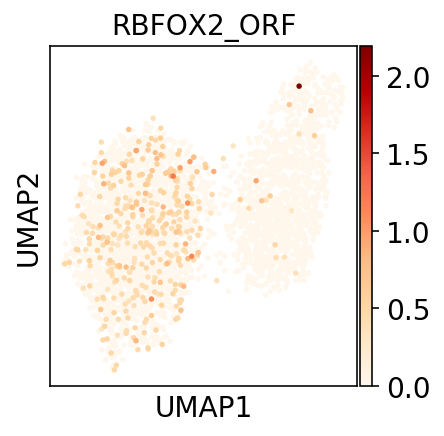

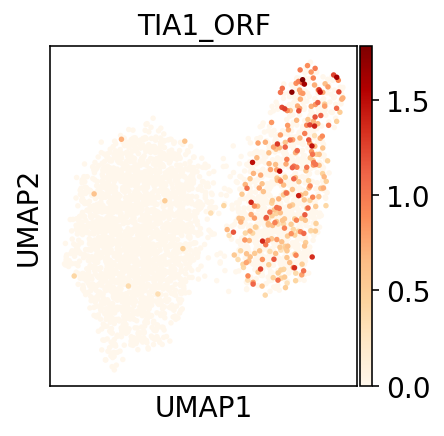

In [121]:
sc.pl.umap(adata_subset_more, color=['RBFOX2_ORF'],cmap='OrRd', size=30)
sc.pl.umap(adata_subset_more, color=['TIA1_ORF'],cmap='OrRd', size=30)

categories: None, RBFOX2_ORF, TIA1_ORF, etc.
var_group_labels: 0, 1


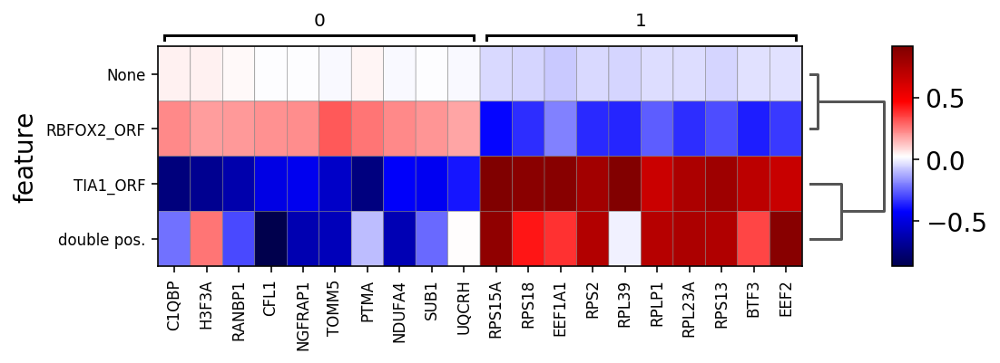

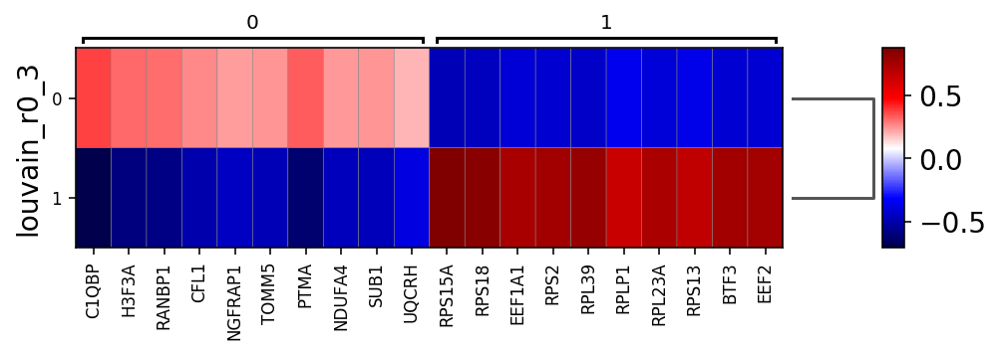

categories: None, RBFOX2_ORF, TIA1_ORF, etc.
var_group_labels: 0, 1


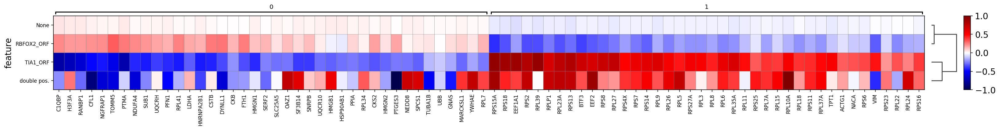

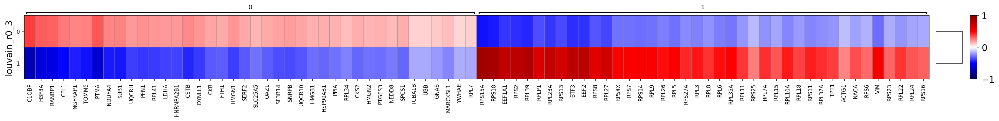

In [122]:
sc.pl.rank_genes_groups_matrixplot(adata_subset_more,groupby='feature',use_raw=False, cmap='seismic')
sc.pl.rank_genes_groups_matrixplot(adata_subset_more,groupby='louvain_r0_3',use_raw=False, cmap='seismic')
sc.pl.rank_genes_groups_matrixplot(adata_subset_more,groupby='feature',use_raw=False, cmap='seismic',vmin=-1,vmax=1,n_genes=40)
sc.pl.rank_genes_groups_matrixplot(adata_subset_more,groupby='louvain_r0_3',use_raw=False, cmap='seismic',vmin=-1,vmax=1,n_genes=40)

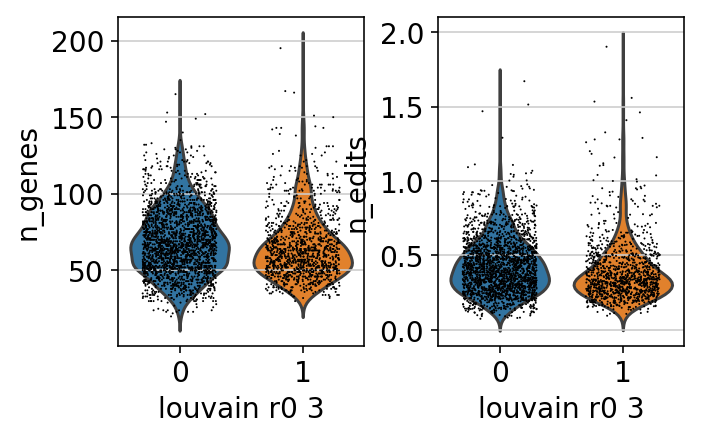

In [123]:
sc.pl.violin(adata_subset_more, ['n_genes', 'n_edits'],
                 jitter=0.3, groupby='louvain_r0_3')

# Looking overlap with eCLIP peaks #


In [125]:
RBFOX2_CLIP_exonic=pd.read_csv('./results/RBFOX2_CLIP_unique_exonic_siggenes.tsv', sep='\t', header=None)
RBFOX2_CLIP_exonic = RBFOX2_CLIP_exonic.drop_duplicates(subset=[3])
print(len(RBFOX2_CLIP_exonic))
RBFOX2_CLIP_exonic=RBFOX2_CLIP_exonic[[3]].set_index(3)
found=RBFOX2_CLIP_exonic.index.isin(adata_subset_more.var.index)
RBFOX2_CLIP_exonic['found']=found
RBFOX2_CLIP_exonic=RBFOX2_CLIP_exonic[RBFOX2_CLIP_exonic['found']==True]
print(len(RBFOX2_CLIP_exonic))
RBFOX2_CLIP_exonic_list=RBFOX2_CLIP_exonic.index.tolist()

448
40


In [126]:
TIA1_CLIP_exonic=pd.read_csv('./results/TIA1_CLIP_unique_exonic_siggenes.tsv', sep='\t', header=None)
TIA1_CLIP_exonic = TIA1_CLIP_exonic.drop_duplicates(subset=[3])
print(len(TIA1_CLIP_exonic))
TIA1_CLIP_exonic=TIA1_CLIP_exonic[[3]].set_index(3)
found=TIA1_CLIP_exonic.index.isin(adata_subset_more.var.index)
TIA1_CLIP_exonic['found']=found
TIA1_CLIP_exonic=TIA1_CLIP_exonic[TIA1_CLIP_exonic['found']==True]
print(len(TIA1_CLIP_exonic))
TIA1_CLIP_exonic_list=TIA1_CLIP_exonic.index.tolist()

606
205


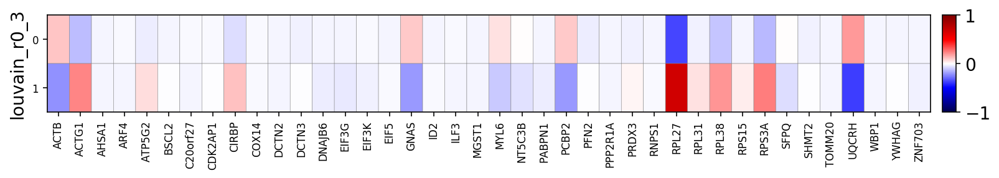

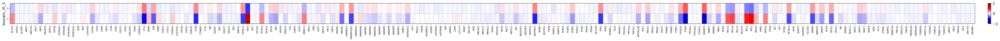

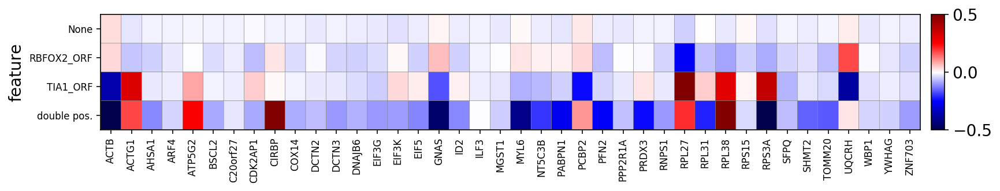

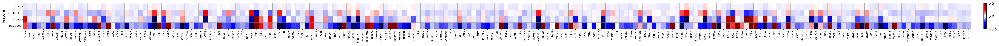

GridSpec(2, 3, height_ratios=[0, 10.5], width_ratios=[65.6, 0, 0.2])

In [127]:
sc.pl.matrixplot(adata_subset_more,var_names=RBFOX2_CLIP_exonic_list,groupby='louvain_r0_3', cmap='seismic',use_raw=False,vmax=1,vmin=-1)
sc.pl.matrixplot(adata_subset_more,var_names=TIA1_CLIP_exonic_list,groupby='louvain_r0_3', cmap='seismic',use_raw=False,vmax=1,vmin=-1)
sc.pl.matrixplot(adata_subset_more,var_names=RBFOX2_CLIP_exonic_list,groupby='feature', cmap='seismic',use_raw=False,vmax=0.5,vmin=-0.5)
sc.pl.matrixplot(adata_subset_more,var_names=TIA1_CLIP_exonic_list,groupby='feature', cmap='seismic',use_raw=False,vmax=0.5,vmin=-0.5)

In [128]:
RBFOX2_CLIP_exonic=pd.read_csv('./results/RBFOX2_CLIP_unique_exonic_siggenes.tsv', sep='\t', header=None)
RBFOX2_CLIP_exonic = RBFOX2_CLIP_exonic.drop_duplicates(subset=[3])
print(len(RBFOX2_CLIP_exonic))
RBFOX2_CLIP_exonic=RBFOX2_CLIP_exonic[[3]].set_index(3)
found=RBFOX2_CLIP_exonic.index.isin(adata_subset_more.var.index)
RBFOX2_CLIP_exonic['found']=found
RBFOX2_CLIP_exonic=RBFOX2_CLIP_exonic[RBFOX2_CLIP_exonic['found']==True]
print(len(RBFOX2_CLIP_exonic))
RBFOX2_CLIP_exonic_list=RBFOX2_CLIP_exonic.index.tolist()

448
40


In [129]:
tagged=pd.read_csv('./results/tagged_clip.tsv', sep='\t', header=None)
tagged=tagged[tagged[3]>3]
tagged=tagged[tagged[4]>3]
tagged=tagged.sort_values(by=9)
tagged=tagged.drop_duplicates(subset=[9])
tagged
print(len(tagged))
tagged=tagged[[9]].set_index(9)
found=tagged.index.isin(adata_subset_more.var.index)
tagged['found']=found
tagged=tagged[tagged['found']==True]
print(len(tagged))
tagged_list=tagged.index.tolist()

1829
273


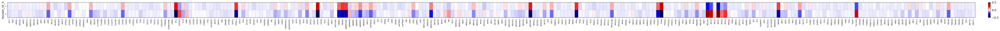

GridSpec(2, 3, height_ratios=[0, 10.5], width_ratios=[87.36, 0, 0.2])

In [130]:
sc.pl.matrixplot(adata_subset_more,var_names=tagged_list,groupby='louvain_r0_3', cmap='seismic',use_raw=False,vmax=0.5,vmin=-0.5)

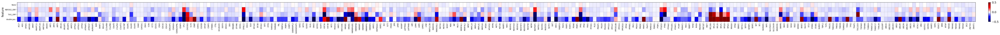

GridSpec(2, 3, height_ratios=[0, 10.5], width_ratios=[87.36, 0, 0.2])

In [131]:
sc.pl.matrixplot(adata_subset_more,var_names=tagged_list,groupby='feature', cmap='seismic',use_raw=False,vmax=0.5,vmin=-0.5)

In [257]:
bulk_dir='/home/bay001/projects/kris_apobec_20200121/permanent_data/final_analysis/01_SAILOR_bulk_rnaseq/outputs/combined_outputs_w_cov_info/pass3/supp'

In [258]:
bulk_TIA1 = pd.read_csv(
    os.path.join(bulk_dir, 'Tia1_1000ng_1_S14_L001_R1_001.fastqTr.sorted.STARUnmapped.out.sorted.STARAligned.out.sorted_a0_b0_e0.01.annotated.windows_51.txt.wgenenames.txt'),
    sep='\t',
    index_col=0
)
print(bulk_TIA1.shape)
bulk_TIA1.head()

(58115, 12)


,start,end,name,score,strand,edit_coverage,editable_coverage,edited_over_edited_c,all_c_coverage,edited_over_all_c,geneid,genename
chrom,,,,,,,,,,,,
chr1,14487,14538,ENSG00000227232.4|noncoding_exon,1.000000,-,11,49,0.224490,346,0.031792,ENSG00000227232.4,WASH7P
chr1,14496,14547,ENSG00000227232.4|noncoding_exon,0.974241,-,11,49,0.224490,398,0.027638,ENSG00000227232.4,WASH7P
chr1,18539,18590,ENSG00000227232.4|proxnoncoding_intron500,0.999886,-,3,11,0.272727,187,0.016043,ENSG00000227232.4,WASH7P
chr1,18617,18668,ENSG00000227232.4|proxnoncoding_intron500,0.999990,-,3,6,0.500000,73,0.041096,ENSG00000227232.4,WASH7P
chr1,20086,20137,ENSG00000227232.4|distnoncoding_intron500,0.941480,-,1,7,0.142857,122,0.008197,ENSG00000227232.4,WASH7P


In [259]:
bulk_RBFOX2 = pd.read_csv(
    os.path.join(bulk_dir, 'Sample27_S37_merged.fastqTr.sorted.STARUnmapped.out.sorted.STARAligned.out.sorted_a0_b0_e0.01.annotated.windows_51.txt.wgenenames.txt'),
    sep='\t',
    index_col=0
)
print(bulk_RBFOX2.shape)
bulk_RBFOX2.head()

(36316, 12)


,start,end,name,score,strand,edit_coverage,editable_coverage,edited_over_edited_c,all_c_coverage,edited_over_all_c,geneid,genename
chrom,,,,,,,,,,,,
chr1,327493,327544,ENSG00000250575.1|noncoding_exon,0.950990,+,1,6,0.166667,154,0.006494,ENSG00000250575.1,RP4-669L17.8
chr1,565151,565202,ENSG00000225630.1|noncoding_exon,0.525596,+,1,65,0.015385,1009,0.000991,ENSG00000225630.1,MTND2P28
chr1,565204,565255,ENSG00000225630.1|noncoding_exon,0.662282,+,1,42,0.023810,667,0.001499,ENSG00000225630.1,MTND2P28
chr1,566642,566693,ENSG00000237973.1|noncoding_exon,0.941480,+,1,7,0.142857,88,0.011364,ENSG00000237973.1,hsa-mir-6723
chr1,567165,567216,ENSG00000237973.1|noncoding_exon,0.000000,+,9,9,1.000000,118,0.076271,ENSG00000237973.1,hsa-mir-6723


In [265]:
bulk_RBFOX2.sort_values(by='edited_over_all_c', ascending=False).head(20)

,start,end,name,score,strand,edit_coverage,editable_coverage,edited_over_edited_c,all_c_coverage,edited_over_all_c,geneid,genename
chrom,,,,,,,,,,,,
chr17,1247996,1248047,ENSG00000108953.12|3utr,0.520341,-,11,383,0.028721,2136,0.005150,ENSG00000108953.12,YWHAE
chr17,1247999,1248050,ENSG00000108953.12|3utr,0.858562,-,9,324,0.027778,2077,0.004333,ENSG00000108953.12,YWHAE
chr17,1247985,1248036,ENSG00000108953.12|3utr,0.536268,-,15,543,0.027624,2008,0.007470,ENSG00000108953.12,YWHAE
chrM,6310,6361,ENSG00000198804.2|CDS,0.456610,+,2,158,0.012658,1721,0.001162,ENSG00000198804.2,MT-CO1
chrM,7794,7845,ENSG00000198712.1|CDS,0.475340,+,1,75,0.013333,1717,0.000582,ENSG00000198712.1,MT-CO2
chr17,4849135,4849186,ENSG00000108518.7|3utr,0.878767,-,8,428,0.018692,1716,0.004662,ENSG00000108518.7,PFN1
chr17,4849132,4849183,ENSG00000108518.7|3utr,0.541685,-,18,484,0.037190,1710,0.010526,ENSG00000108518.7,PFN1
chr19,3976506,3976557,ENSG00000167658.11|3utr,0.461222,-,1,78,0.012821,1668,0.000600,ENSG00000167658.11,EEF2
chr17,4849140,4849191,ENSG00000108518.7|3utr,0.541685,-,10,429,0.023310,1661,0.006020,ENSG00000108518.7,PFN1


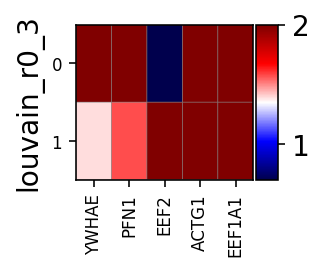

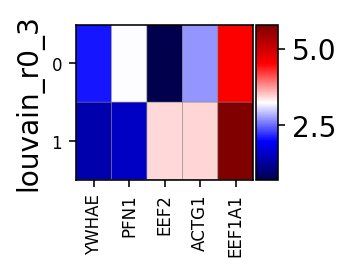

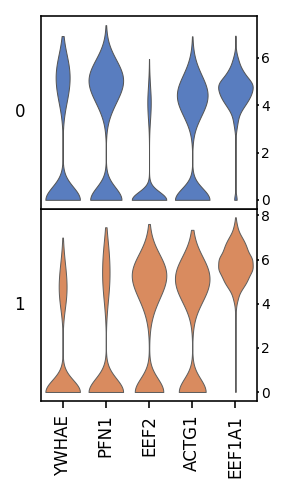

In [280]:
GOI=['YWHAE','PFN1','EEF2','ACTG1','EEF1A1']
sc.pl.matrixplot(adata_subset_more,var_names=GOI,groupby='louvain_r0_3', cmap='seismic',vmax=2)
sc.pl.matrixplot(adata_subset_more,var_names=GOI,groupby='louvain_r0_3', cmap='seismic')
sc.pl.stacked_violin(adata_subset_more,var_names=GOI,groupby='louvain_r0_3')

In [132]:
adata_subset_more.write(results_dir+'02_02_Merge_APO_with_RBFOX_TIA_edits_over_Cs_adata_subset_more.h5ad')

In [255]:
adata_subset_more = sc.read(results_dir+'02_02_Merge_APO_with_RBFOX_TIA_edits_over_Cs_adata_subset_more.h5ad')

### Saving barcode tables for RBFOX2-TIA1 cells ###

In [246]:
adata_subset_more.obs[['louvain_r0_3']]

,louvain_r0_3
index,
possorted_genome_bam_MD-AAACCCAAGAGCCCAA-1-RBFOX_TIA-Edits,0
possorted_genome_bam_MD-AAACCCACATCTCAAG-1-RBFOX_TIA-Edits,0
possorted_genome_bam_MD-AAACCCAGTCAAGCGA-1-RBFOX_TIA-Edits,0
possorted_genome_bam_MD-AAACCCAGTTCAGGTT-1-RBFOX_TIA-Edits,0
possorted_genome_bam_MD-AAACCCATCGCAGAGA-1-RBFOX_TIA-Edits,1
...,...
possorted_genome_bam_MD-TTTGGTTTCGACGAGA-1-RBFOX_TIA-Edits,0
possorted_genome_bam_MD-TTTGTTGAGGGCTGAT-1-RBFOX_TIA-Edits,0
possorted_genome_bam_MD-TTTGTTGCAACCGTAT-1-RBFOX_TIA-Edits,0


In [247]:
new_cluster_names = [
    'RBFOX2_ORF', 'TIA1_ORF']
adata_subset_more.rename_categories('louvain_r0_3', new_cluster_names)

In [248]:
adata_subset_more.obs['louvain_r0_3'].value_counts()

RBFOX2_ORF    2146
TIA1_ORF      1147
Name: louvain_r0_3, dtype: int64

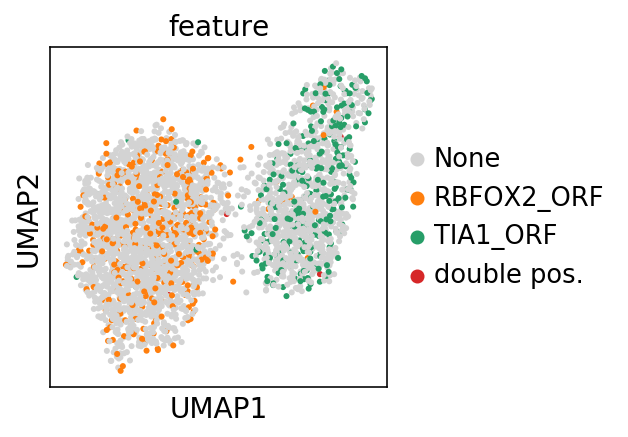

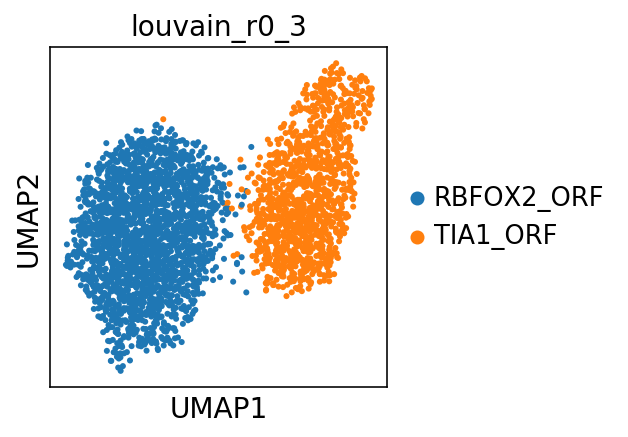

In [249]:
sc.pl.umap(adata_subset_more, color=['feature'])
sc.pl.umap(adata_subset_more, color=['louvain_r0_3'])

In [250]:
adata_subset_more.obs[['louvain_r0_3']].to_csv('./results/barcodes_RBFOX2-TIA1_subset_more.csv')

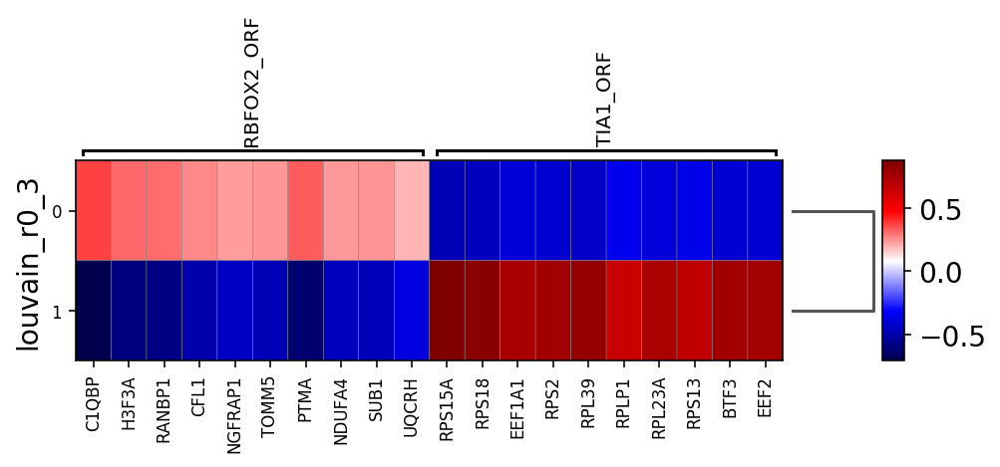

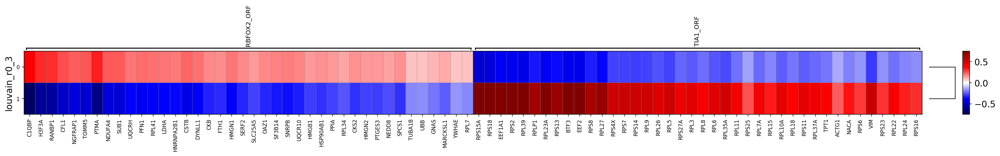

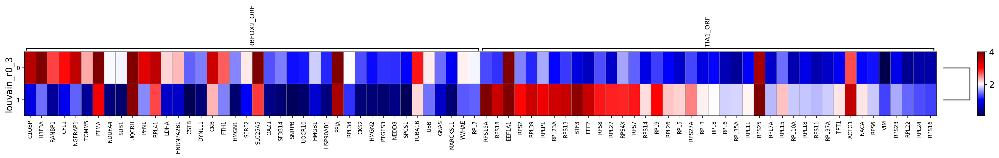

In [254]:
sc.pl.rank_genes_groups_matrixplot(adata_subset_more,groupby='louvain_r0_3',use_raw=False, cmap='seismic')
sc.pl.rank_genes_groups_matrixplot(adata_subset_more,groupby='louvain_r0_3',use_raw=False, cmap='seismic',vmin=-0.75,vmax=0.75,n_genes=40)
sc.pl.rank_genes_groups_matrixplot(adata_subset_more,groupby='louvain_r0_3', cmap='seismic',vmax=4,n_genes=40)

### Remove cells with feature tags ###

In [238]:
array1 = ['None']
#array2 = ['RBFOX_TIA-Edits']
subset=adata_subset_more.obs[['feature']]
subset=subset.loc[subset['feature'].isin(array1)]
#subset=subset.loc[subset['batch'].isin(array2)]
subset

,feature
index,
possorted_genome_bam_MD-AAACCCAAGAGCCCAA-1-RBFOX_TIA-Edits,None
possorted_genome_bam_MD-AAACCCACATCTCAAG-1-RBFOX_TIA-Edits,None
possorted_genome_bam_MD-AAACCCAGTCAAGCGA-1-RBFOX_TIA-Edits,None
possorted_genome_bam_MD-AAACCCAGTTCAGGTT-1-RBFOX_TIA-Edits,None
possorted_genome_bam_MD-AAACCCATCGCAGAGA-1-RBFOX_TIA-Edits,None
...,...
possorted_genome_bam_MD-TTTGGTTGTACGATGG-1-RBFOX_TIA-Edits,None
possorted_genome_bam_MD-TTTGGTTTCGACGAGA-1-RBFOX_TIA-Edits,None
possorted_genome_bam_MD-TTTGTTGAGGGCTGAT-1-RBFOX_TIA-Edits,None


In [239]:
barcodes=subset.index.values.tolist()

In [240]:
adata_subset_more=adata_subset_more[barcodes].copy()

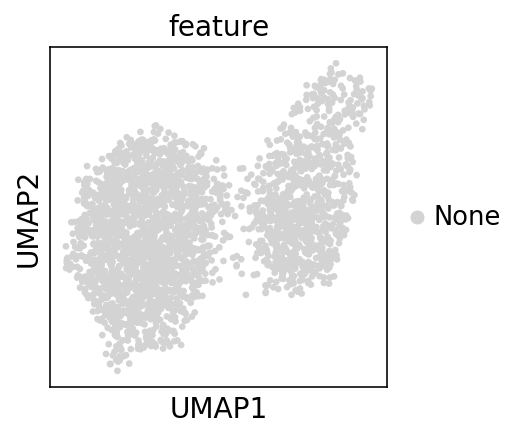

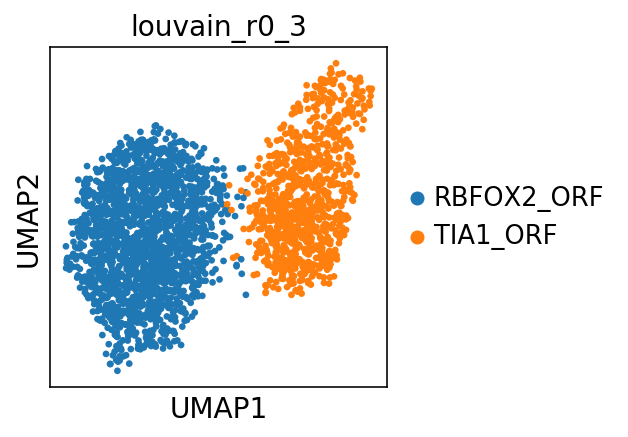

In [241]:
sc.pl.umap(adata_subset_more, color=['feature'])
sc.pl.umap(adata_subset_more, color=['louvain_r0_3'])

In [242]:
adata_subset_more.obs['louvain_r0_3'].value_counts()

RBFOX2_ORF    1801
TIA1_ORF       857
Name: louvain_r0_3, dtype: int64

In [243]:
adata_subset_more.obs[['louvain_r0_3']].to_csv('./results/barcodes_RBFOX2-TIA1_subset_more_noFeatureCells.csv')

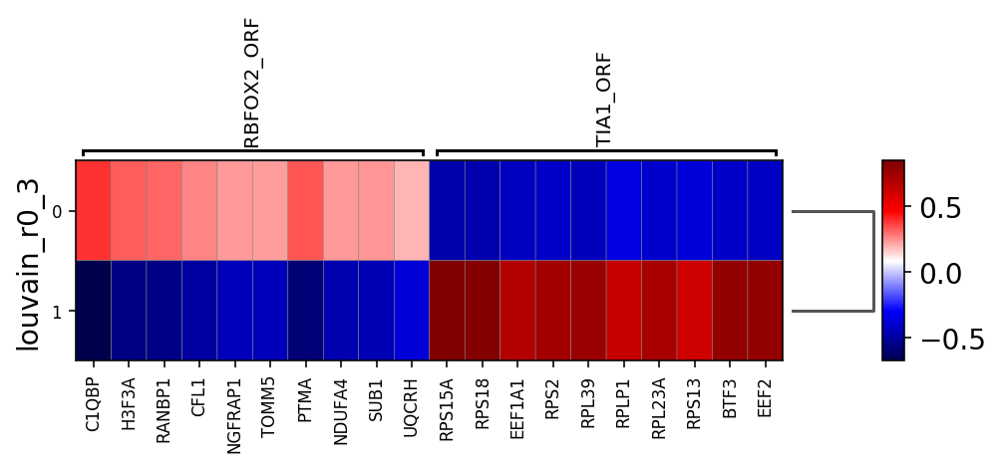

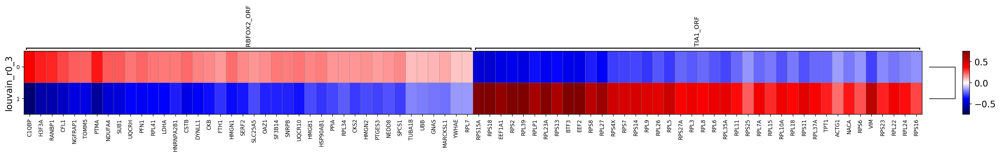

In [244]:
sc.pl.rank_genes_groups_matrixplot(adata_subset_more,groupby='louvain_r0_3',use_raw=False, cmap='seismic')
sc.pl.rank_genes_groups_matrixplot(adata_subset_more,groupby='louvain_r0_3',use_raw=False, cmap='seismic',vmin=-0.75,vmax=0.75,n_genes=40)